In [1]:
from STIS_pipeline_functions import *

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
/Users/natalieallen/opt/anaconda3/lib/python3.8/site-packages/autograd/numpy/numpy_wrapper.py:20: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  int_types = {_np.int, _np.int8, _np.int16, _np.int32, _np.int64, _np.integer}


In [2]:
# read in data and calibration files - the test directory I have has 
# two different instruments so I just quickly sort those
data_files_430 = sorted(glob.glob("wasp-121/HST/G430L/*/*flt.fits"))
data_files_750 = sorted(glob.glob("wasp-121/HST/G750L/*/*flt.fits"))

In [3]:
# get the data from the files - since I use default settings, it reads out: data, header, jitter, dqs, errors
# currently I remove the last few files from the 750 data because they're flat frames rather than science data
# didn't realize this was a possibility to be included - will update the function to exclude anything that isn't 
# "science" in the get_data function later
data_430 = get_data(data_files_430)
data_750 = get_data(data_files_750[:-1])

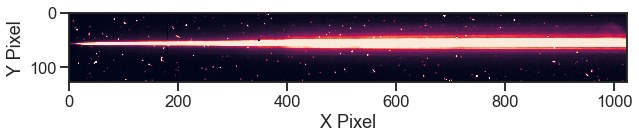

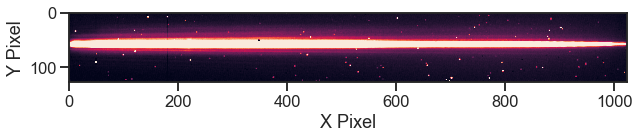

In [4]:
# check on one of the data frames (first part of data) - 430 first and then 750
%matplotlib inline
plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][0])
im.set_clim(0,150)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,10))
im = plt.imshow(data_750[0][0])
im.set_clim(0,150)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [5]:
# initialize a list for and then create traces for each of the data frames
trace_list_430 = []
for i in data_430[0]:
    # trace wants xi, xf, and an initial y guess - these are numbers I just chose from some testing
    # it can be seen above this just corresponds to the strongest flux
    # this function is fast so you can test for yourself if these values don't work!
    trace = trace_spectrum(i, 100,1000,60)
    trace_list_430.append(trace)

trace_list_750 = []
for i in data_750[0]:
    # trace wants xi, xf, and an initial y guess - these are numbers I just chose from some testing
    # it can be seen above this just corresponds to the strongest flux
    # this function is fast so you can test for yourself if these values don't work!
    trace = trace_spectrum(i, 100,1000,60)
    trace_list_750.append(trace)

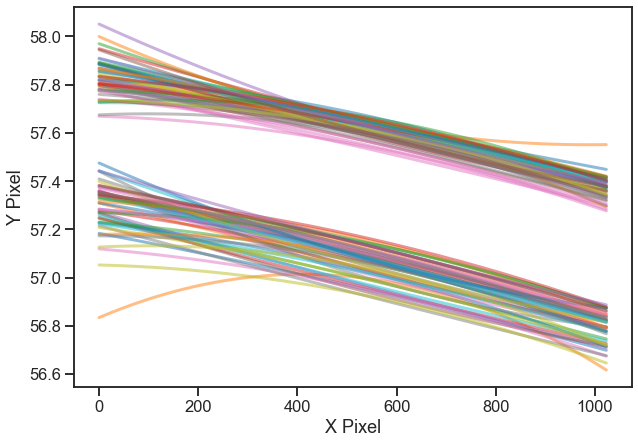

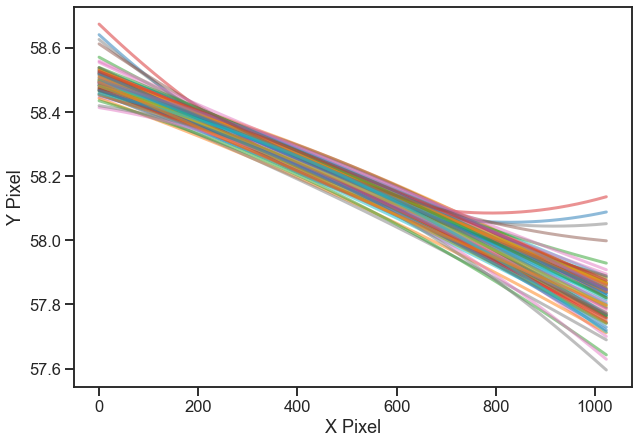

In [6]:
# fit a polynomial to the traces - I just use a second-order chebyshev
# and i fit it over the whole length of the data frame instead of just what was use for the fit
trace_fit_430 = []
plt.figure(figsize = (10,7))
for j in trace_list_430:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    # plotting just to check everything looks okay
    plt.plot(np.arange(len(data_430[0][0][0])),chebyshev.chebval(np.arange(len(data_430[0][0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(data_430[0][0][0])),chebyshev.chebval(np.arange(len(data_430[0][0][0])),coeffs1)]
    trace_fit_430.append(trace)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

# fit a polynomial to the traces - I just use a second-order chebyshev
# and i fit it over the whole length of the data frame instead of just what was use for the fit
trace_fit_750 = []
plt.figure(figsize = (10,7))
for j in trace_list_750:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    # plotting just to check everything looks okay
    plt.plot(np.arange(len(data_750[0][0][0])),chebyshev.chebval(np.arange(len(data_750[0][0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(data_750[0][0][0])),chebyshev.chebval(np.arange(len(data_750[0][0][0])),coeffs1)]
    trace_fit_750.append(trace)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

# there's maybe some outliers here, but this is just an initial trace to feed into the cleaning function
# so we don't worry about it - should subside once the cosmic rays are cleaned

In [7]:
# this is the number of frames in each orbit
data_750[5]

[0, 12, 0, 15, 0, 15, 0, 15, 0, 15]

In [8]:
# now to clean the data - default is all steps on (dq, difference_correct, hc_correct, spline_correct)
# i'm breaking up the orbits manually here, not sure what the best way to do this automatically is yet
# need to feed in the dq frames (the third output from the data function) and initial traces
cleaned_1_750 = clean_data(data_750[0][:4], dqs = data_750[3][:4], traces = trace_fit_750[:4])
cleaned_2_750 = clean_data(data_750[0][4:8], dqs = data_750[3][4:8], traces = trace_fit_750[4:8])
cleaned_3_750 = clean_data(data_750[0][8:12], dqs = data_750[3][8:12], traces = trace_fit_750[8:12])

cleaned_4_750 = clean_data(data_750[0][12:17], dqs = data_750[3][12:17], traces = trace_fit_750[12:17])
cleaned_5_750 = clean_data(data_750[0][17:22], dqs = data_750[3][17:22], traces = trace_fit_750[17:22])
cleaned_6_750 = clean_data(data_750[0][22:27], dqs = data_750[3][22:27], traces = trace_fit_750[22:27])

cleaned_7_750 = clean_data(data_750[0][27:32], dqs = data_750[3][27:32], traces = trace_fit_750[27:32])
cleaned_8_750 = clean_data(data_750[0][32:37], dqs = data_750[3][32:37], traces = trace_fit_750[32:37])
cleaned_9_750 = clean_data(data_750[0][37:42], dqs = data_750[3][37:42], traces = trace_fit_750[37:42])

cleaned_10_750 = clean_data(data_750[0][42:47], dqs = data_750[3][42:47], traces = trace_fit_750[42:47])
cleaned_11_750 = clean_data(data_750[0][47:52], dqs = data_750[3][47:52], traces = trace_fit_750[47:52])
cleaned_12_750 = clean_data(data_750[0][52:57], dqs = data_750[3][52:57], traces = trace_fit_750[52:57])

cleaned_13_750 = clean_data(data_750[0][57:62], dqs = data_750[3][57:62], traces = trace_fit_750[57:62])
cleaned_14_750 = clean_data(data_750[0][62:67], dqs = data_750[3][62:67], traces = trace_fit_750[62:67])
cleaned_15_750 = clean_data(data_750[0][67:72], dqs = data_750[3][67:72], traces = trace_fit_750[67:72])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

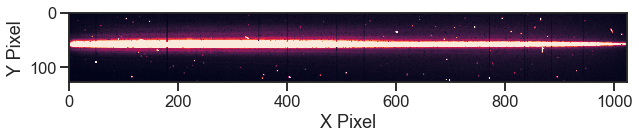

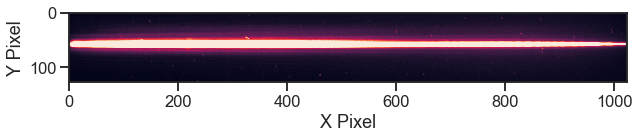

In [9]:
# comparison between the original and the cleaned image
# can easily see the lack of cosmic rays/bad pixels and removal of bad columns
plt.figure(figsize = (10,10))
im = plt.imshow(data_750[0][1])
im.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_1_750[1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()


In [10]:
# same for the 430 data
data_430[5]

[0, 8, 0, 10, 0, 10, 0, 10, 0, 10, 0, 8, 0, 10, 0, 10, 0, 10, 0, 10]

In [11]:
cleaned_1_430 = clean_data(data_430[0][:4], dqs = data_430[3][:4], traces = trace_fit_430[:4])
cleaned_2_430 = clean_data(data_430[0][4:8], dqs = data_430[3][4:8], traces = trace_fit_430[4:8])

cleaned_3_430 = clean_data(data_430[0][8:11], dqs = data_430[3][8:11], traces = trace_fit_430[8:11])
cleaned_4_430 = clean_data(data_430[0][11:14], dqs = data_430[3][11:14], traces = trace_fit_430[11:14])
cleaned_5_430 = clean_data(data_430[0][14:18], dqs = data_430[3][14:18], traces = trace_fit_430[14:18])

cleaned_6_430 = clean_data(data_430[0][18:21], dqs = data_430[3][18:21], traces = trace_fit_430[18:21])
cleaned_7_430 = clean_data(data_430[0][21:24], dqs = data_430[3][21:24], traces = trace_fit_430[21:24])
cleaned_8_430 = clean_data(data_430[0][24:28], dqs = data_430[3][24:28], traces = trace_fit_430[24:28])

cleaned_9_430 = clean_data(data_430[0][28:31], dqs = data_430[3][28:31], traces = trace_fit_430[28:31])
cleaned_10_430 = clean_data(data_430[0][31:34], dqs = data_430[3][31:34], traces = trace_fit_430[31:34])
cleaned_11_430 = clean_data(data_430[0][34:38], dqs = data_430[3][34:38], traces = trace_fit_430[34:38])

cleaned_12_430 = clean_data(data_430[0][38:41], dqs = data_430[3][38:41], traces = trace_fit_430[38:41])
cleaned_13_430 = clean_data(data_430[0][41:44], dqs = data_430[3][41:44], traces = trace_fit_430[41:44])
cleaned_14_430 = clean_data(data_430[0][44:48], dqs = data_430[3][44:48], traces = trace_fit_430[44:48])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

In [ ]:
# keep this here for now just in case
cleaned_1_4302 = clean_data(data_430[0][:4], dqs = data_430[3][:4], traces = trace_fit_430[:4], spline_correct = True)
cleaned_2_4302 = clean_data(data_430[0][4:8], dqs = data_430[3][4:8], traces = trace_fit_430[4:8], spline_correct = True)

cleaned_3_4302 = clean_data(data_430[0][8:12], dqs = data_430[3][8:12], traces = trace_fit_430[8:12], spline_correct = True)
cleaned_4_4302 = clean_data(data_430[0][12:16], dqs = data_430[3][12:16], traces = trace_fit_430[12:16], spline_correct = True)
cleaned_5_4302 = clean_data(data_430[0][16:20], dqs = data_430[3][16:20], traces = trace_fit_430[16:20], spline_correct = True)
cleaned_6_4302 = clean_data(data_430[0][20:24], dqs = data_430[3][20:24], traces = trace_fit_430[20:24], spline_correct = True)

cleaned_7_4302 = clean_data(data_430[0][24:28], dqs = data_430[3][24:28], traces = trace_fit_430[24:28], spline_correct = True)
cleaned_8_4302 = clean_data(data_430[0][28:32], dqs = data_430[3][28:32], traces = trace_fit_430[28:32], spline_correct = True)
cleaned_9_4302 = clean_data(data_430[0][32:36], dqs = data_430[3][32:36], traces = trace_fit_430[32:36], spline_correct = True)

cleaned_10_4302 = clean_data(data_430[0][36:40], dqs = data_430[3][36:40], traces = trace_fit_430[36:40], spline_correct = True)
cleaned_11_4302 = clean_data(data_430[0][40:44], dqs = data_430[3][40:44], traces = trace_fit_430[40:44], spline_correct = True)
cleaned_12_4302 = clean_data(data_430[0][44:48], dqs = data_430[3][44:48], traces = trace_fit_430[44:48], spline_correct = True)

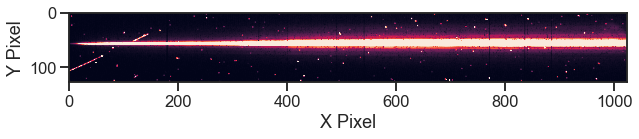

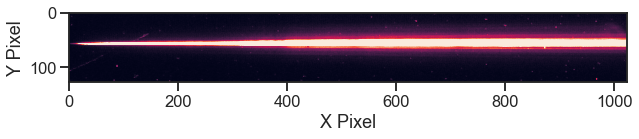

In [12]:
plt.figure(figsize = (10,10))
cim = plt.imshow(data_430[0][1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_1_430[1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [13]:
# same for the second orbit
cleaned_21_430 = clean_data(data_430[0][48:52], dqs = data_430[3][48:52], traces = trace_fit_430[48:52])
cleaned_22_430 = clean_data(data_430[0][52:56], dqs = data_430[3][52:56], traces = trace_fit_430[52:56])

cleaned_23_430 = clean_data(data_430[0][56:59], dqs = data_430[3][56:59], traces = trace_fit_430[56:59])
cleaned_24_430 = clean_data(data_430[0][59:62], dqs = data_430[3][59:62], traces = trace_fit_430[59:62])
cleaned_25_430 = clean_data(data_430[0][62:66], dqs = data_430[3][62:66], traces = trace_fit_430[62:66])

cleaned_26_430 = clean_data(data_430[0][66:69], dqs = data_430[3][66:69], traces = trace_fit_430[66:69])
cleaned_27_430 = clean_data(data_430[0][69:72], dqs = data_430[3][69:72], traces = trace_fit_430[69:72])
cleaned_28_430 = clean_data(data_430[0][72:76], dqs = data_430[3][72:76], traces = trace_fit_430[72:76])

cleaned_29_430 = clean_data(data_430[0][76:79], dqs = data_430[3][76:79], traces = trace_fit_430[76:79])
cleaned_210_430 = clean_data(data_430[0][79:82], dqs = data_430[3][79:82], traces = trace_fit_430[79:82])
cleaned_211_430 = clean_data(data_430[0][82:86], dqs = data_430[3][82:86], traces = trace_fit_430[82:86])

cleaned_212_430 = clean_data(data_430[0][86:89], dqs = data_430[3][86:89], traces = trace_fit_430[86:89])
cleaned_213_430 = clean_data(data_430[0][89:92], dqs = data_430[3][89:92], traces = trace_fit_430[89:92])
cleaned_214_430 = clean_data(data_430[0][92:96], dqs = data_430[3][92:96], traces = trace_fit_430[92:96])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

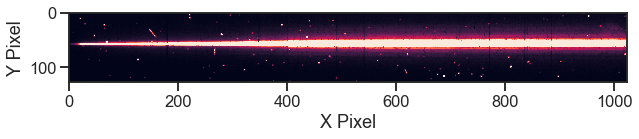

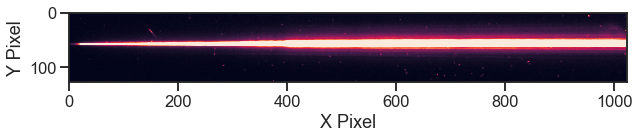

In [14]:
plt.figure(figsize = (10,10))
cim = plt.imshow(data_430[0][0+48])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_21_430[0])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [15]:
# just putting all of the cleaned files into one list
transit_750_cleaned = [*cleaned_1_750, *cleaned_2_750, *cleaned_3_750, *cleaned_4_750, *cleaned_5_750, *cleaned_6_750, *cleaned_7_750, *cleaned_8_750, *cleaned_9_750, *cleaned_10_750, *cleaned_11_750, *cleaned_12_750, *cleaned_13_750, *cleaned_14_750, *cleaned_15_750]
transit_430_cleaned = [*cleaned_1_430, *cleaned_2_430, *cleaned_3_430, *cleaned_4_430, *cleaned_5_430, *cleaned_6_430, *cleaned_7_430, *cleaned_8_430, *cleaned_9_430, *cleaned_10_430, *cleaned_11_430, *cleaned_12_430, *cleaned_13_430, *cleaned_14_430]
transit_430_2_cleaned = [*cleaned_21_430, *cleaned_22_430, *cleaned_23_430, *cleaned_24_430, *cleaned_25_430, *cleaned_26_430, *cleaned_27_430, *cleaned_28_430, *cleaned_29_430, *cleaned_210_430, *cleaned_211_430, *cleaned_212_430, *cleaned_213_430, *cleaned_214_430]

Frame  0


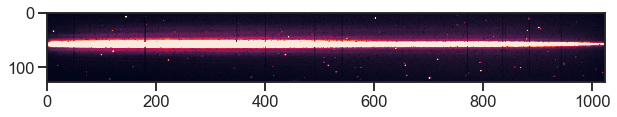

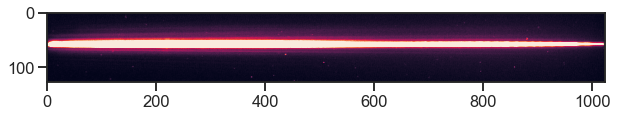

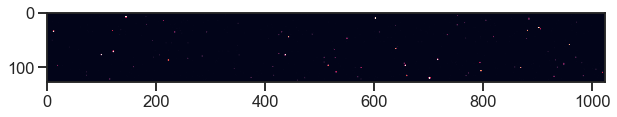

Frame  1


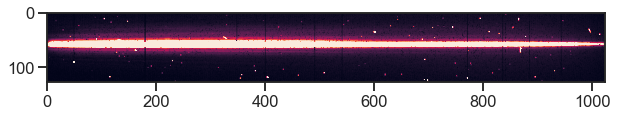

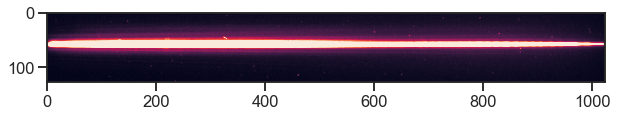

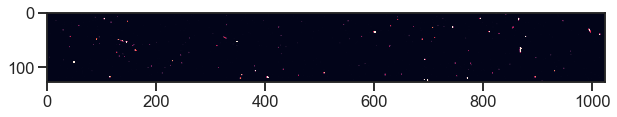

Frame  2


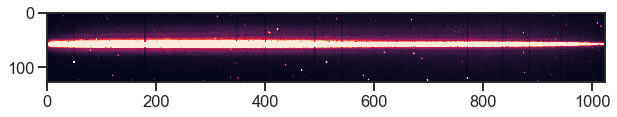

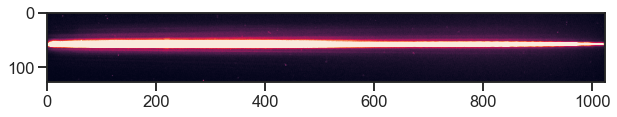

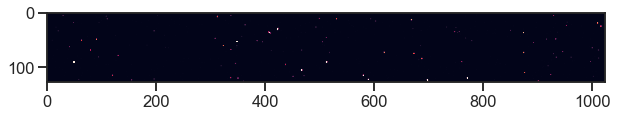

Frame  3


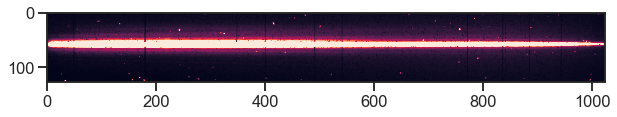

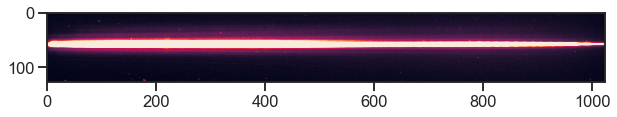

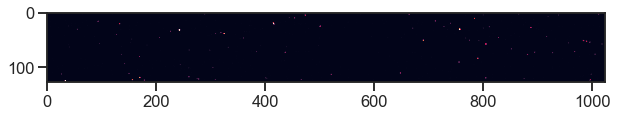

Frame  4


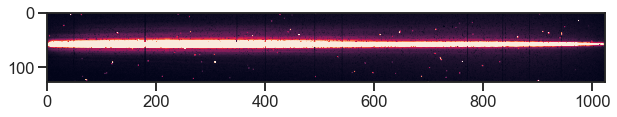

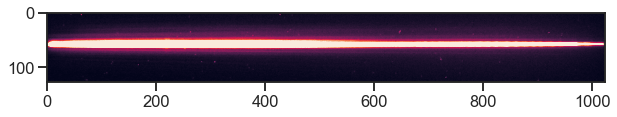

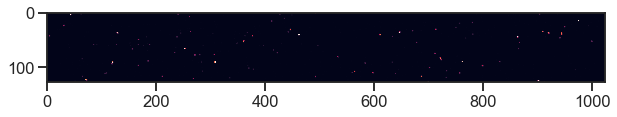

Frame  5


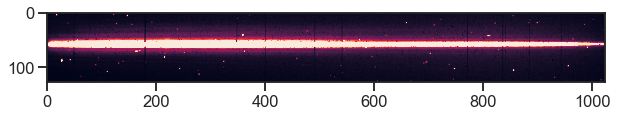

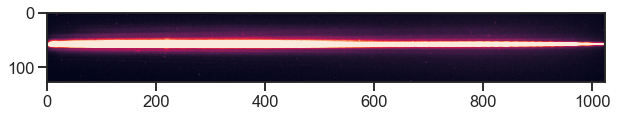

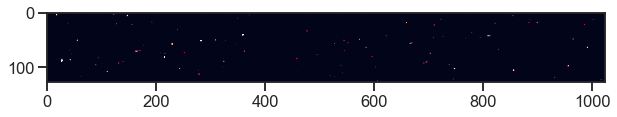

Frame  6


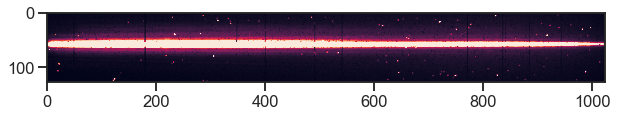

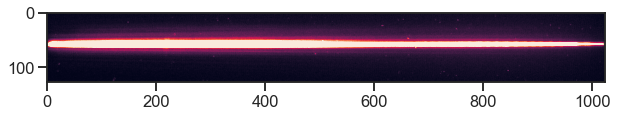

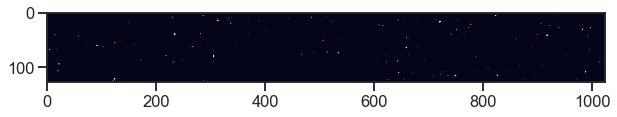

Frame  7


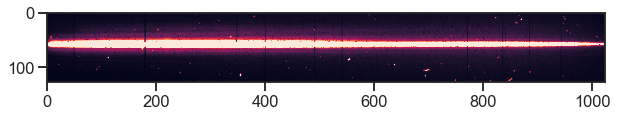

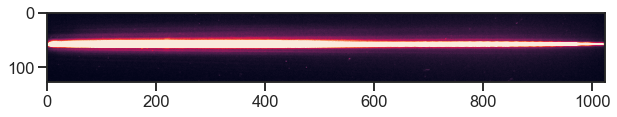

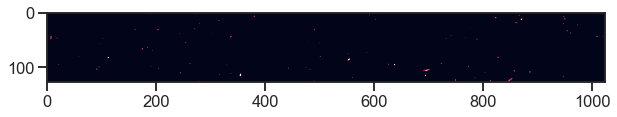

Frame  8


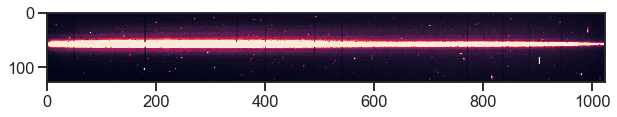

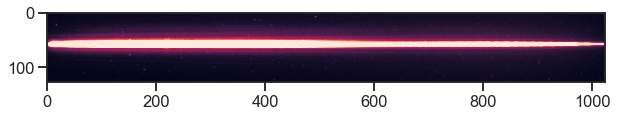

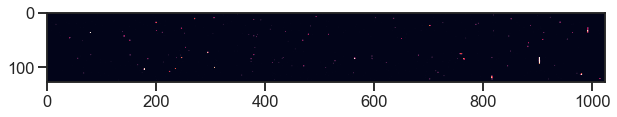

Frame  9


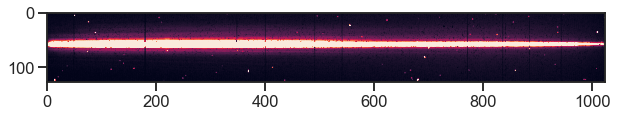

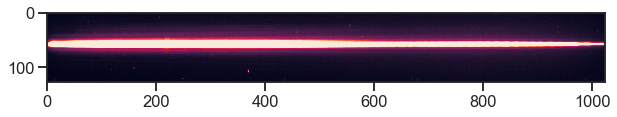

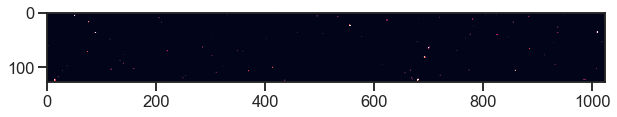

Frame  10


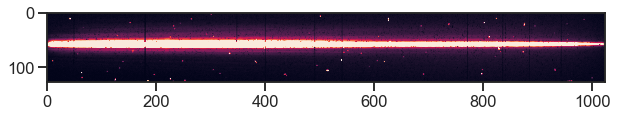

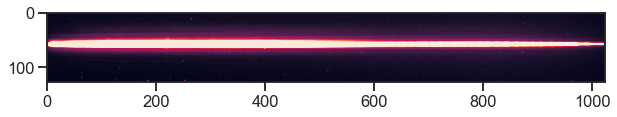

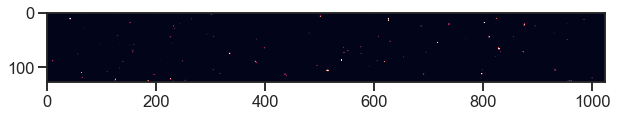

Frame  11


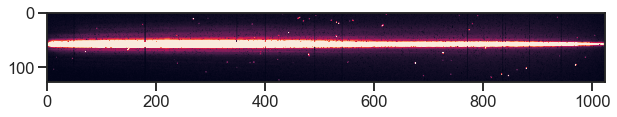

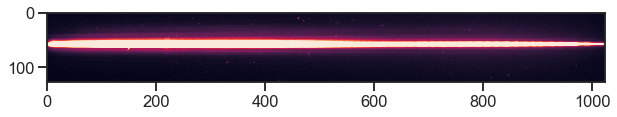

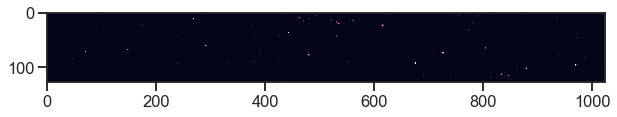

Frame  12


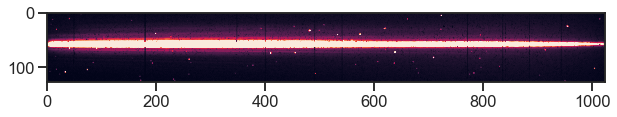

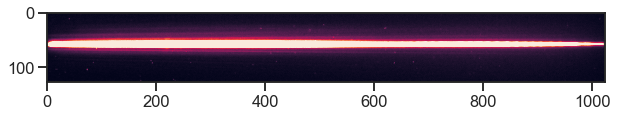

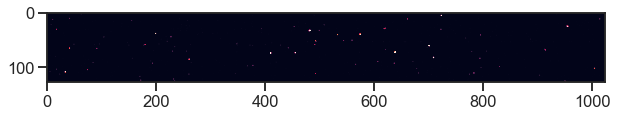

Frame  13


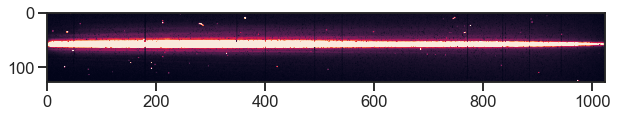

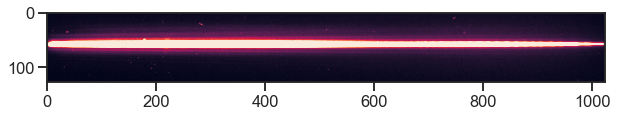

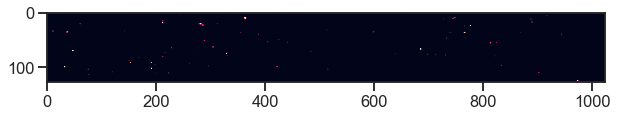

Frame  14


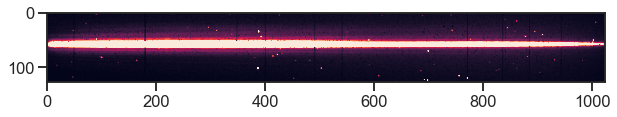

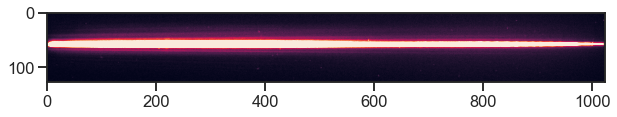

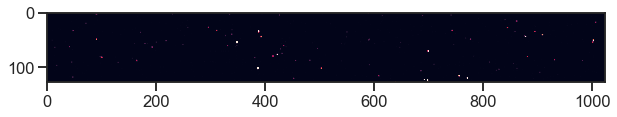

Frame  15


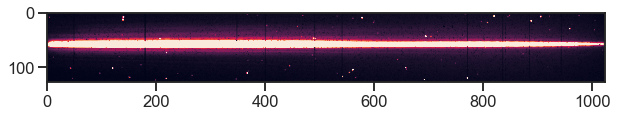

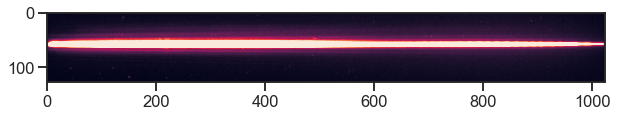

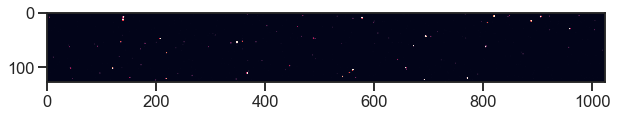

Frame  16


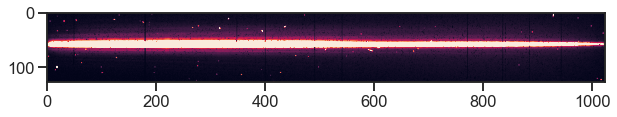

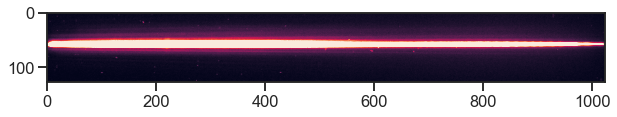

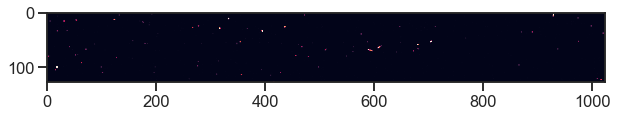

Frame  17


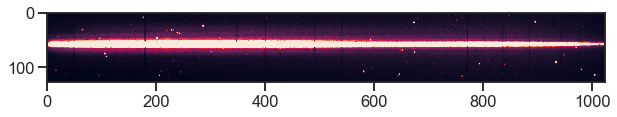

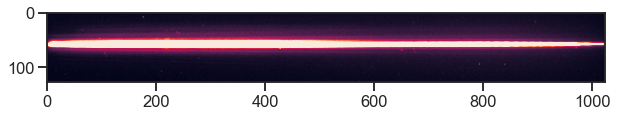

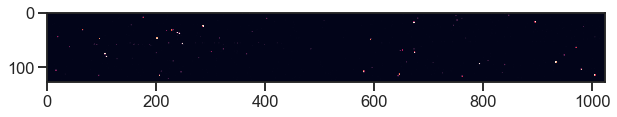

Frame  18


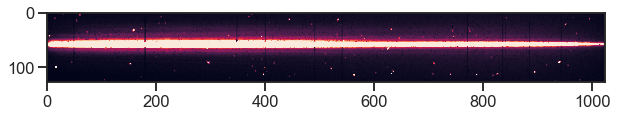

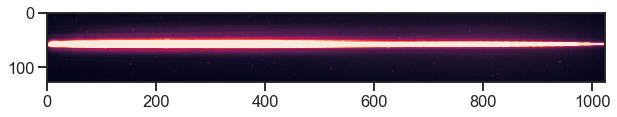

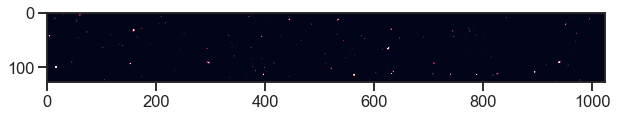

Frame  19


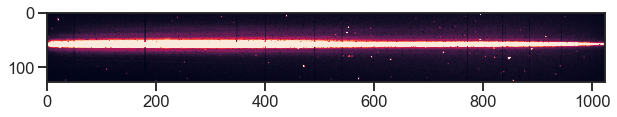

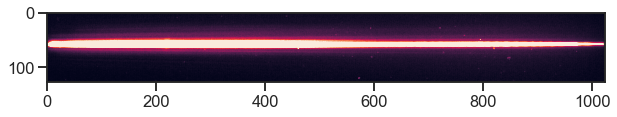

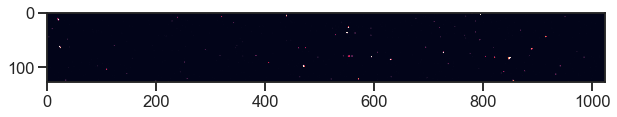

Frame  20


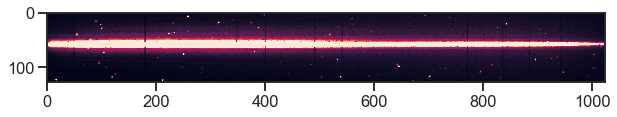

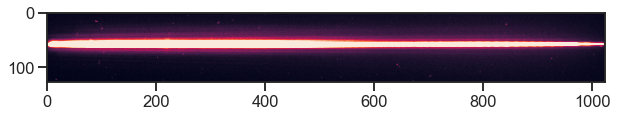

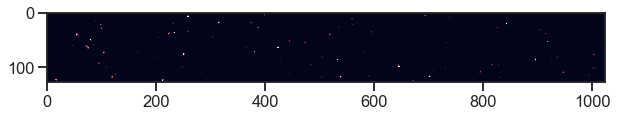

Frame  21


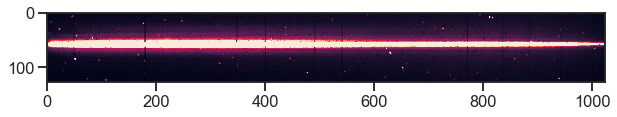

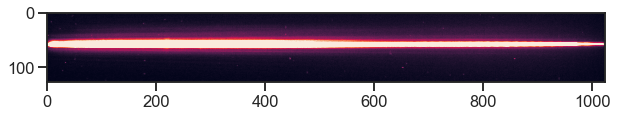

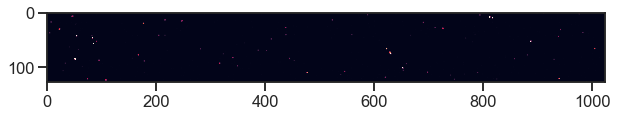

Frame  22


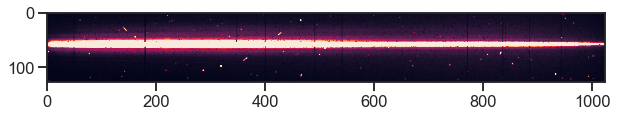

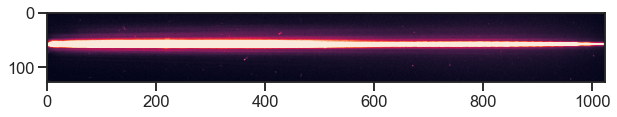

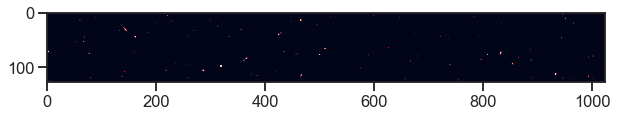

Frame  23


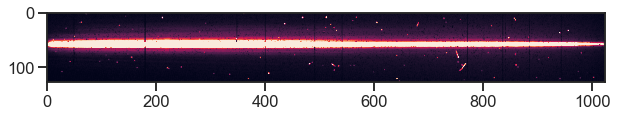

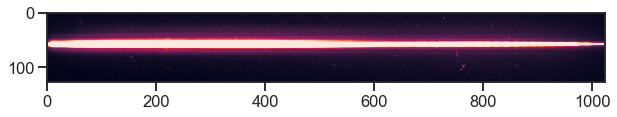

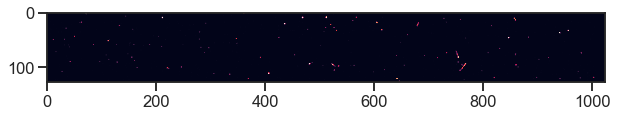

Frame  24


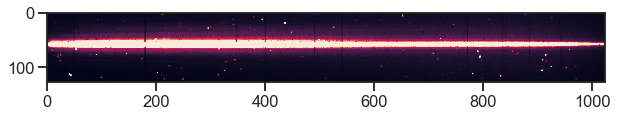

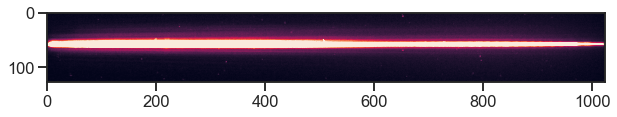

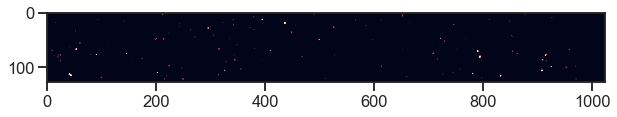

Frame  25


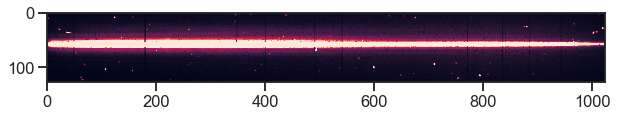

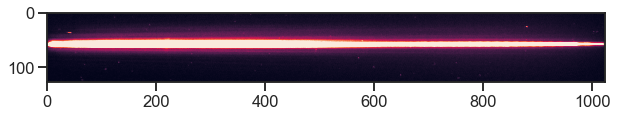

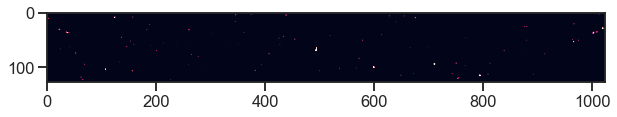

Frame  26


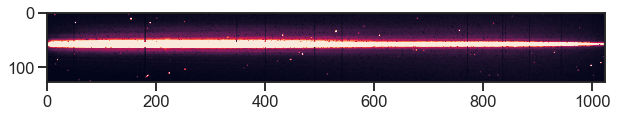

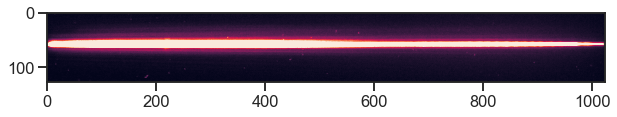

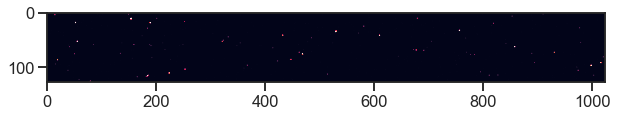

Frame  27


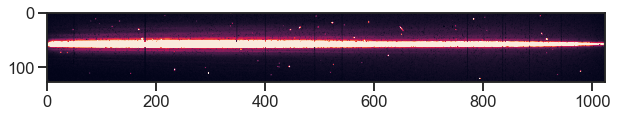

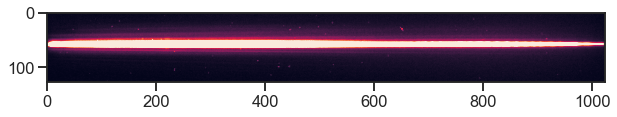

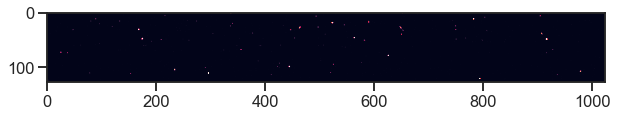

Frame  28


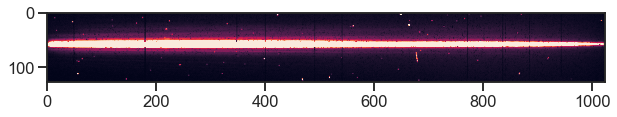

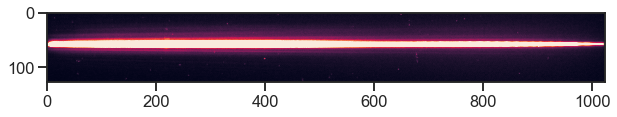

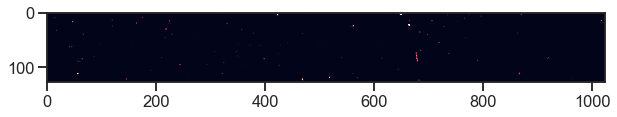

Frame  29


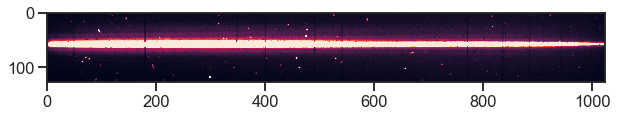

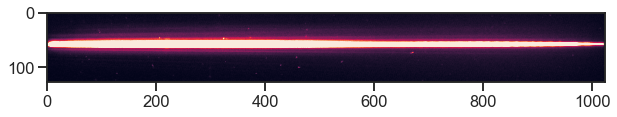

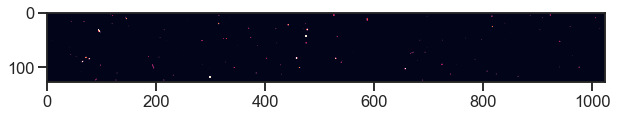

Frame  30


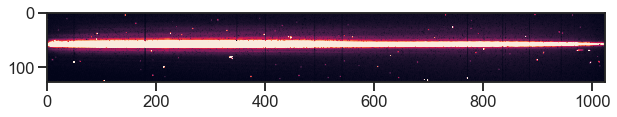

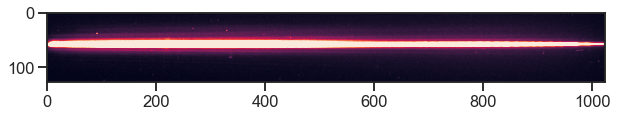

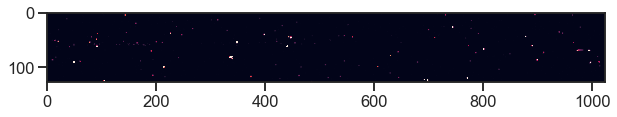

Frame  31


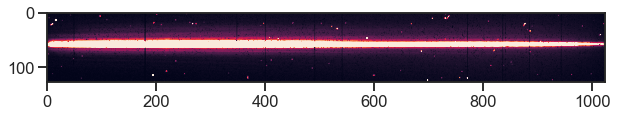

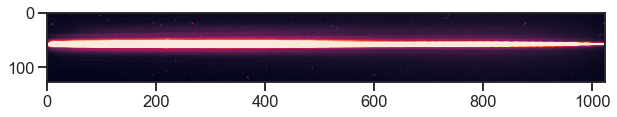

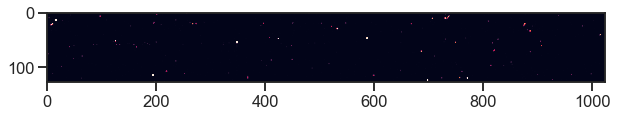

Frame  32


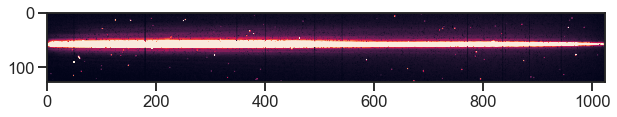

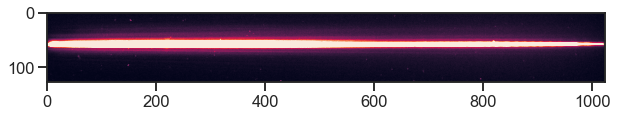

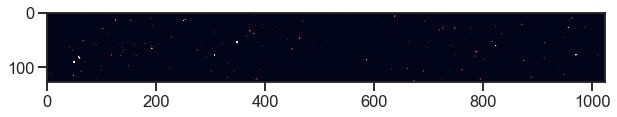

Frame  33


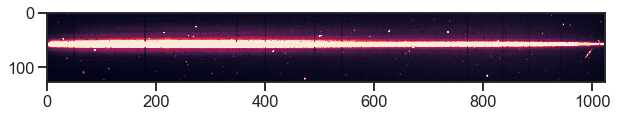

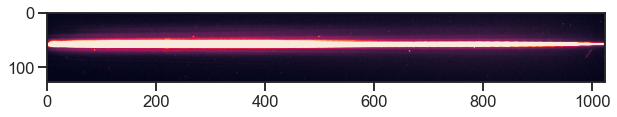

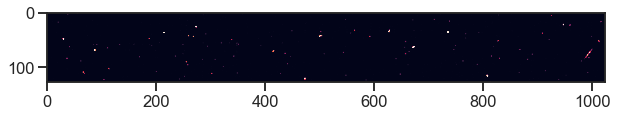

Frame  34


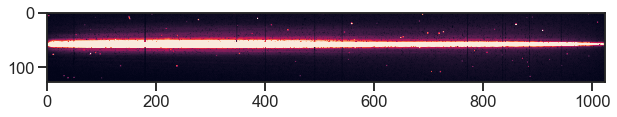

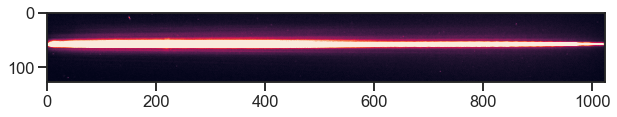

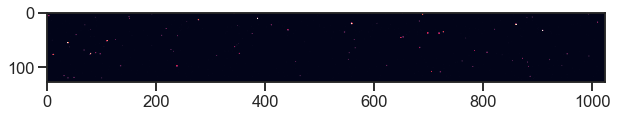

Frame  35


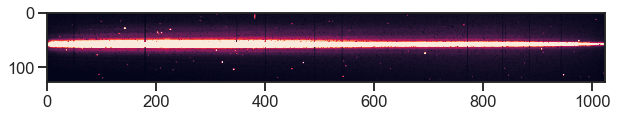

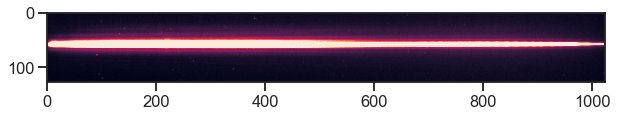

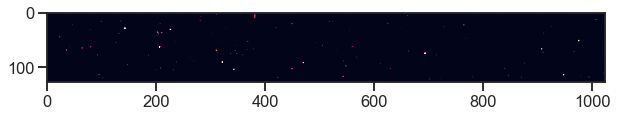

Frame  36


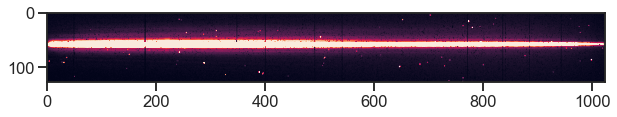

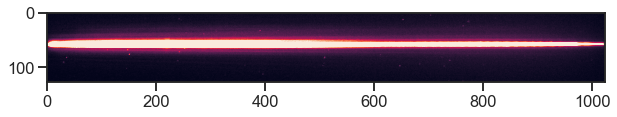

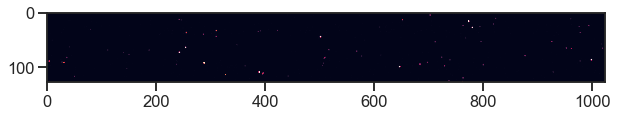

Frame  37


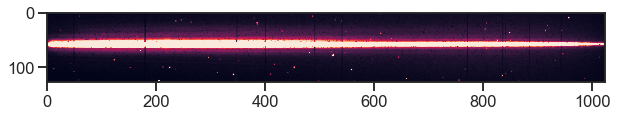

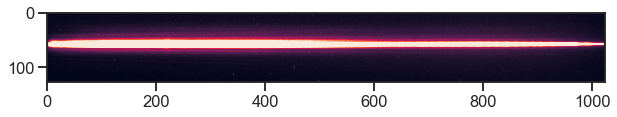

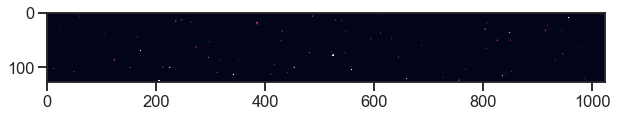

Frame  38


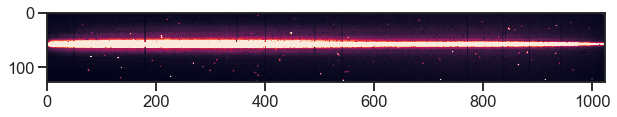

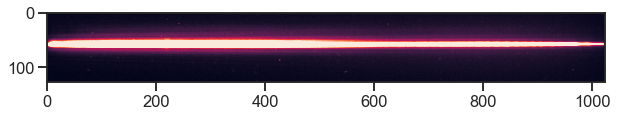

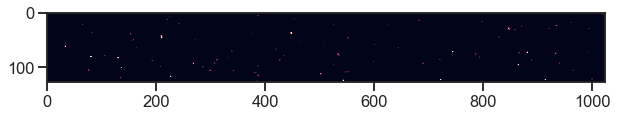

Frame  39


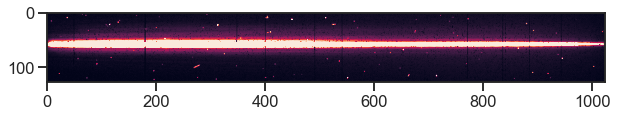

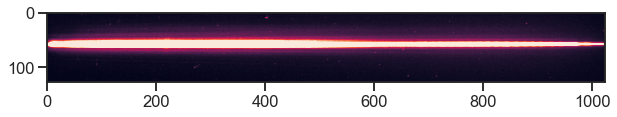

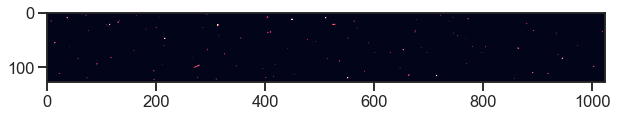

Frame  40


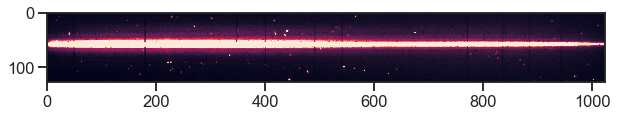

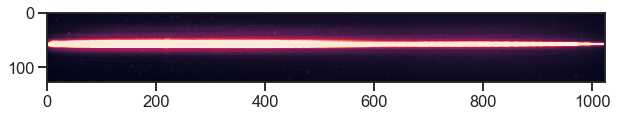

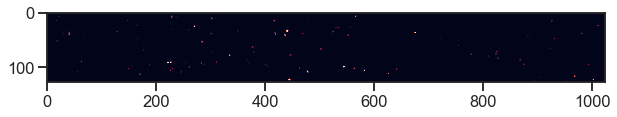

Frame  41


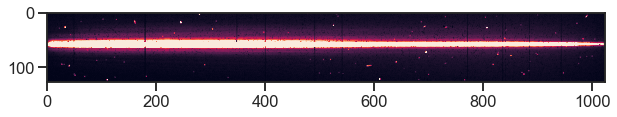

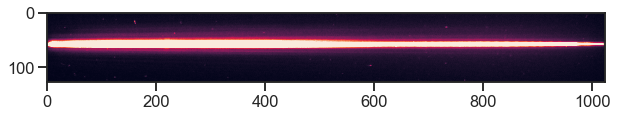

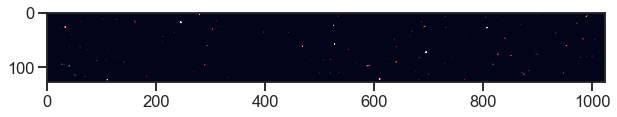

Frame  42


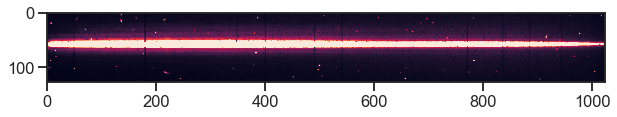

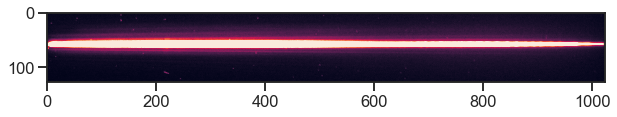

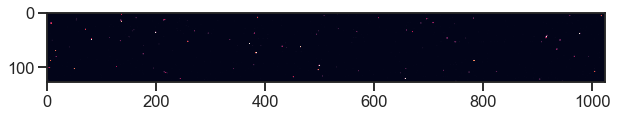

Frame  43


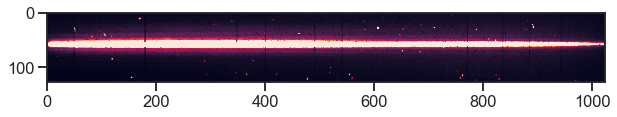

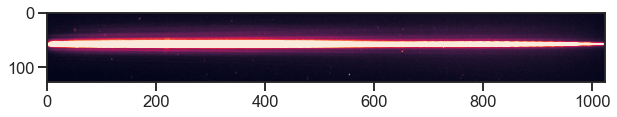

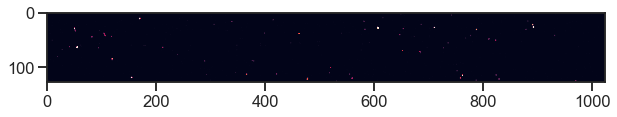

Frame  44


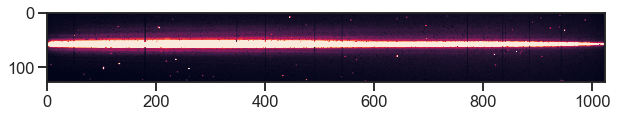

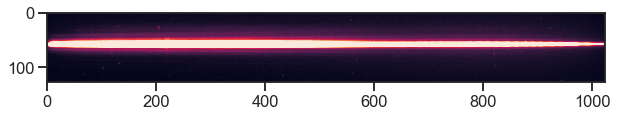

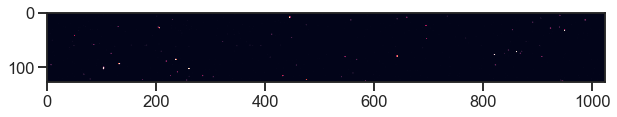

Frame  45


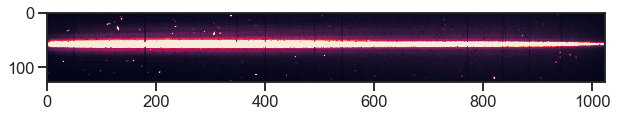

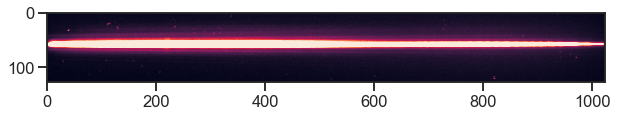

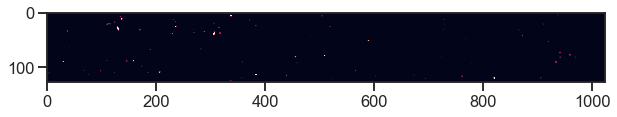

Frame  46


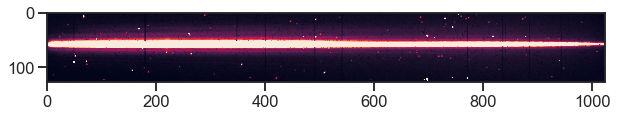

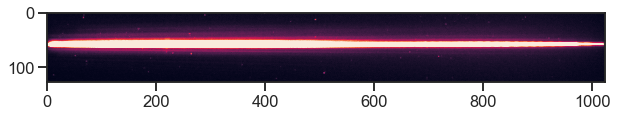

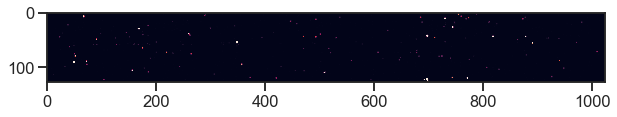

Frame  47


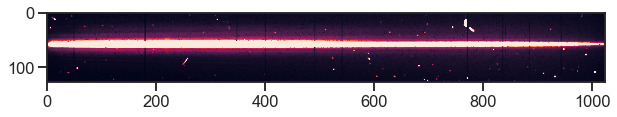

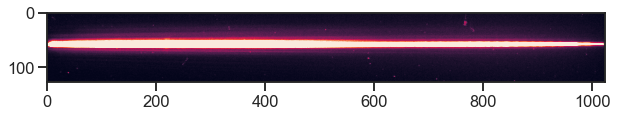

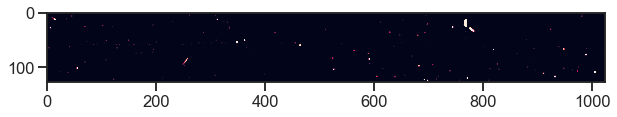

Frame  48


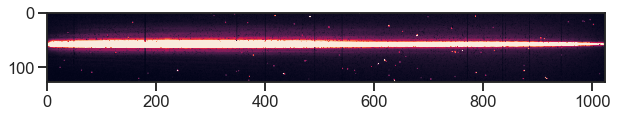

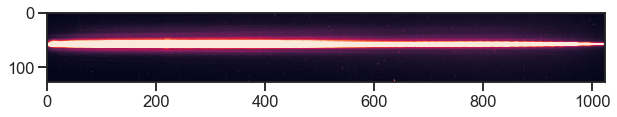

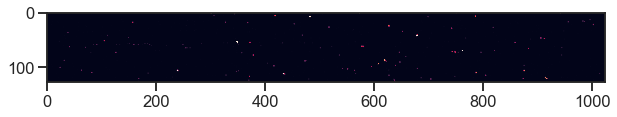

Frame  49


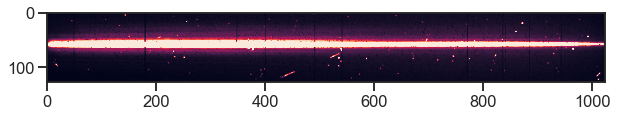

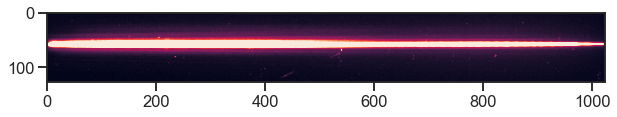

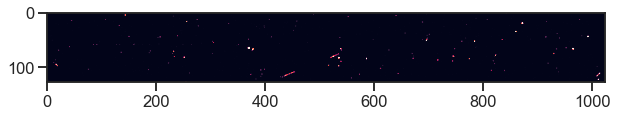

Frame  50


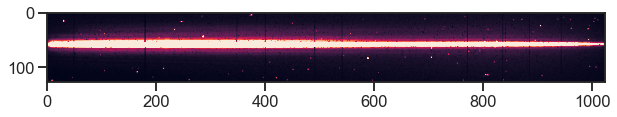

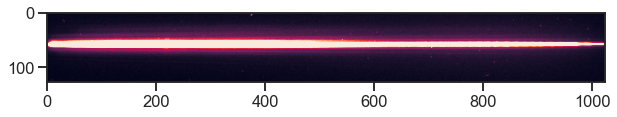

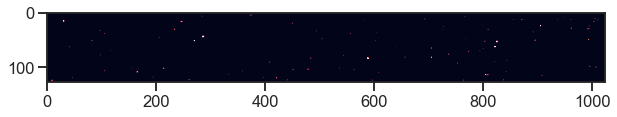

Frame  51


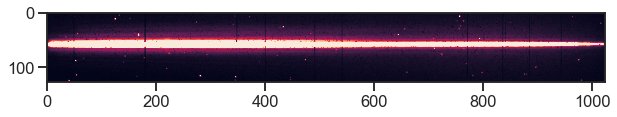

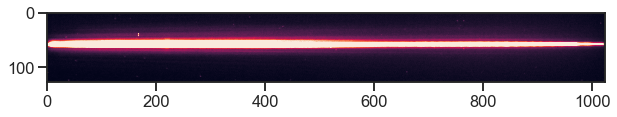

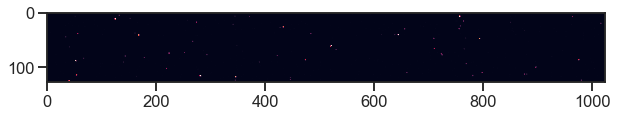

Frame  52


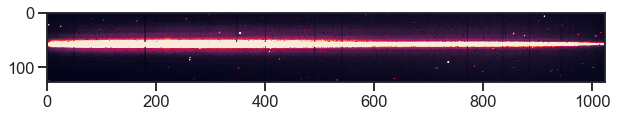

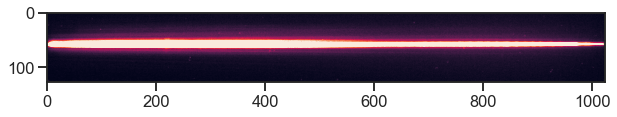

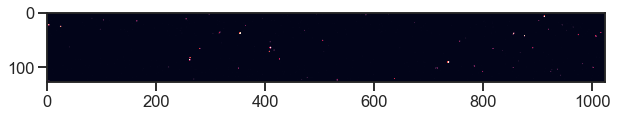

Frame  53


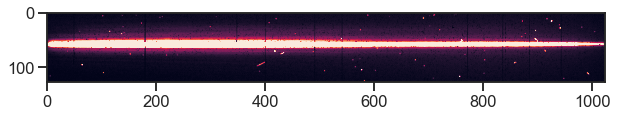

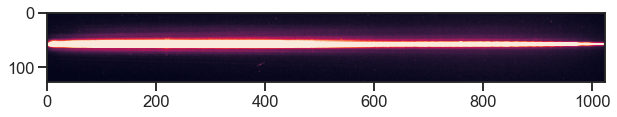

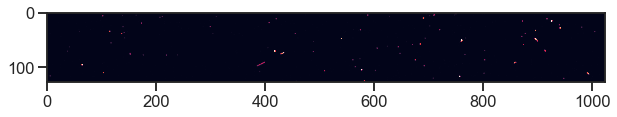

Frame  54


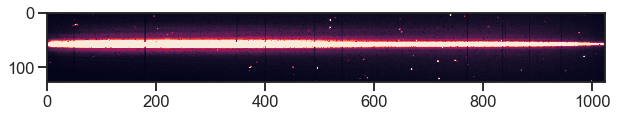

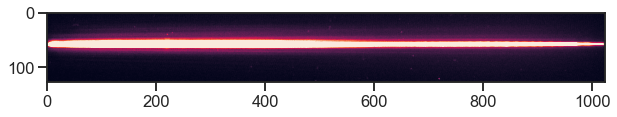

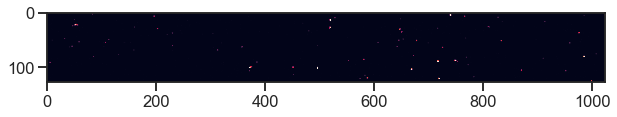

Frame  55


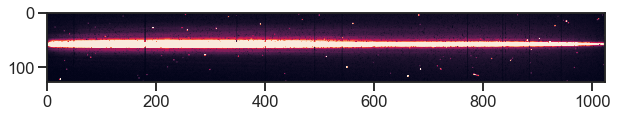

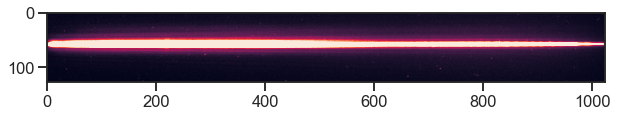

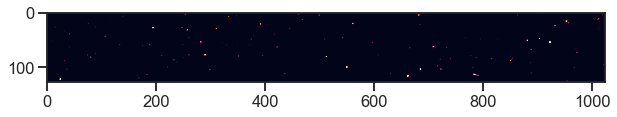

Frame  56


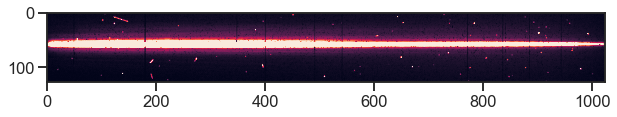

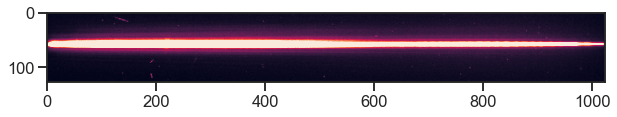

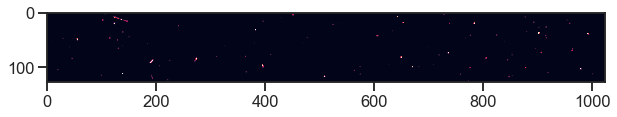

Frame  57


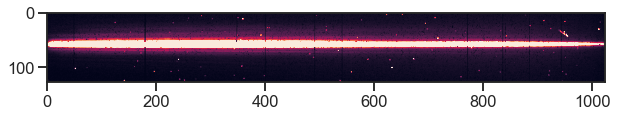

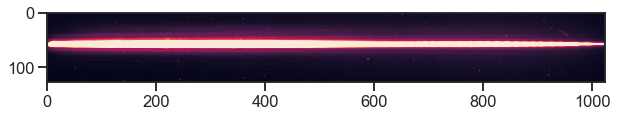

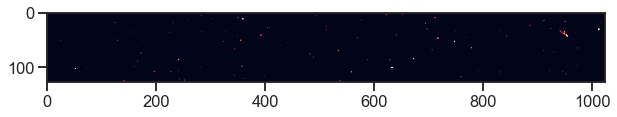

Frame  58


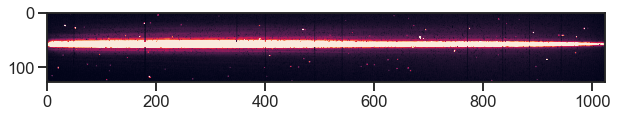

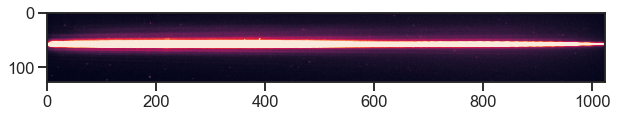

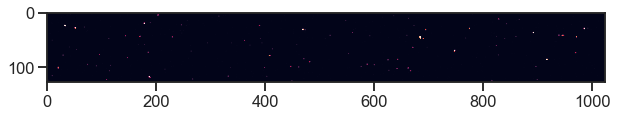

Frame  59


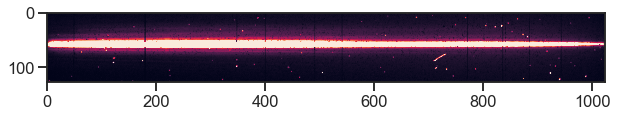

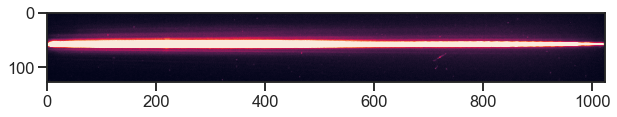

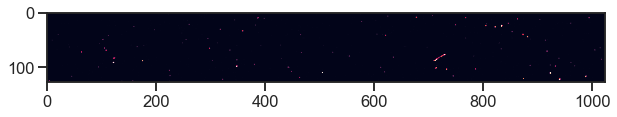

Frame  60


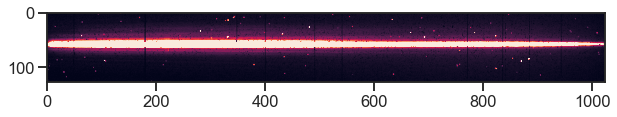

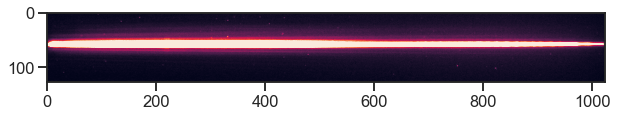

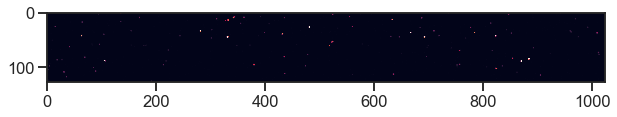

Frame  61


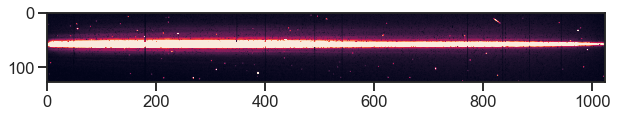

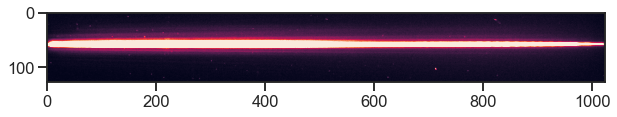

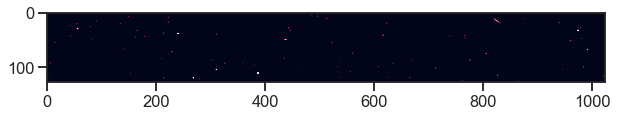

Frame  62


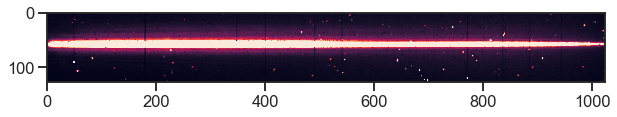

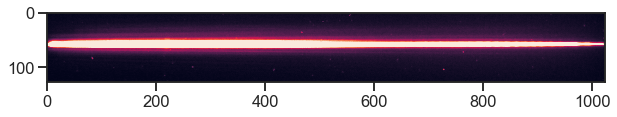

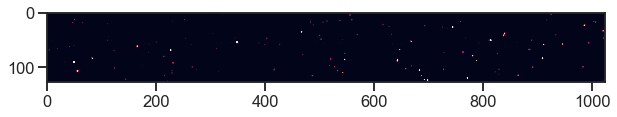

Frame  63


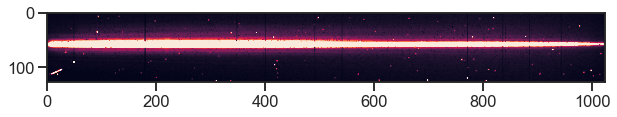

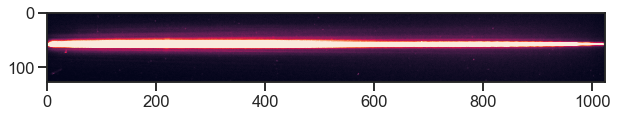

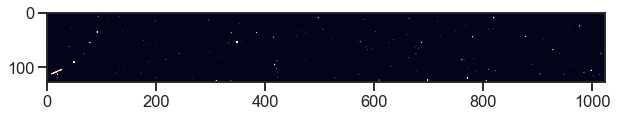

Frame  64


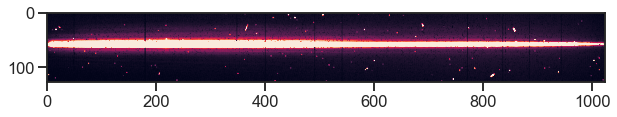

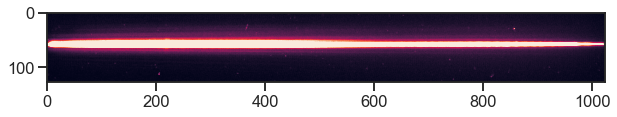

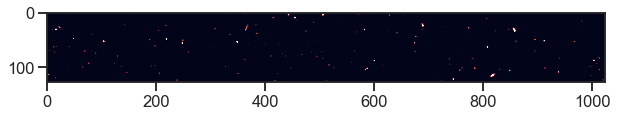

Frame  65


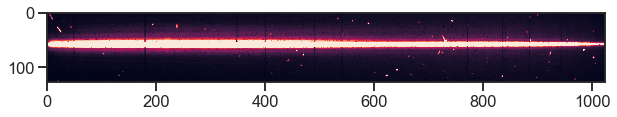

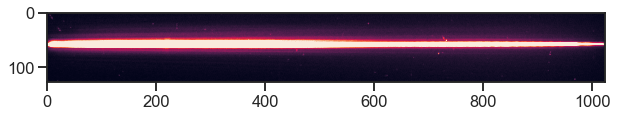

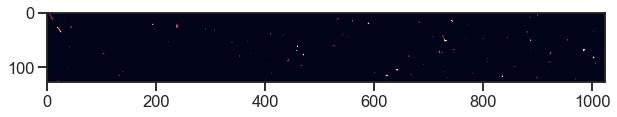

Frame  66


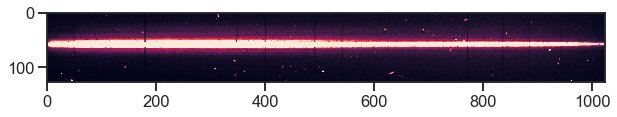

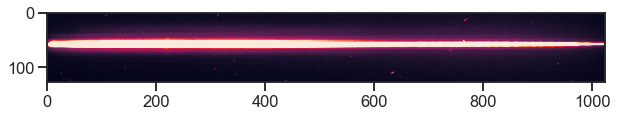

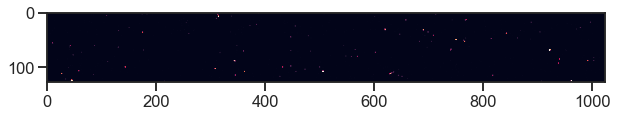

Frame  67


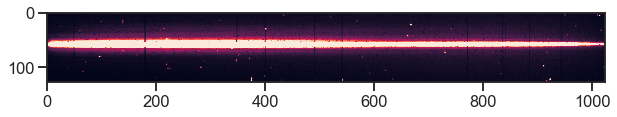

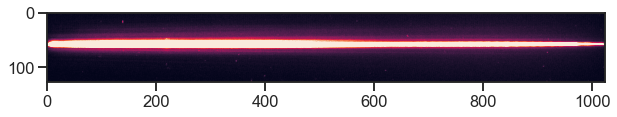

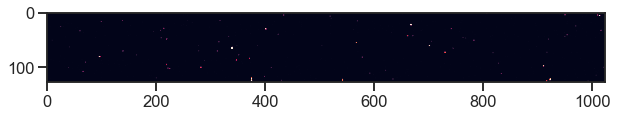

Frame  68


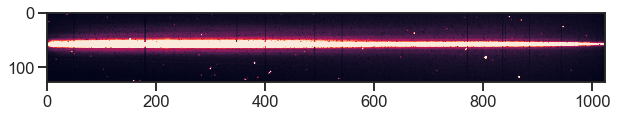

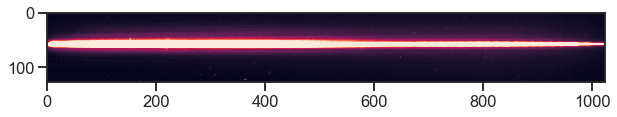

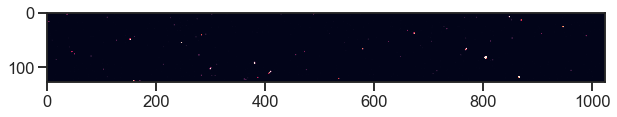

Frame  69


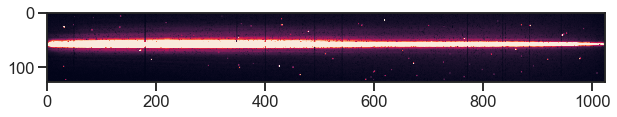

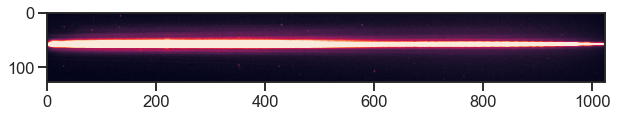

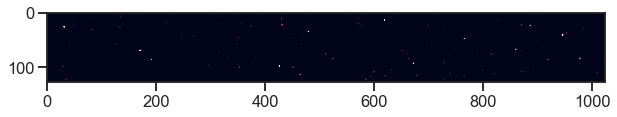

Frame  70


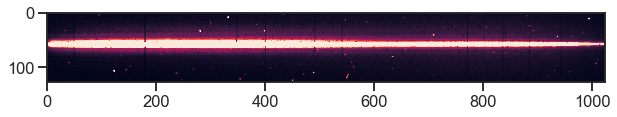

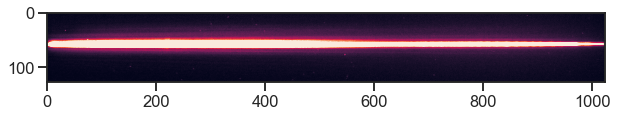

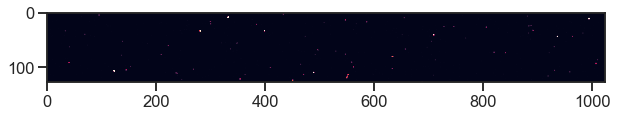

Frame  71


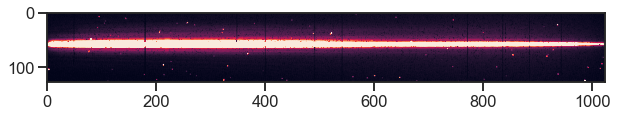

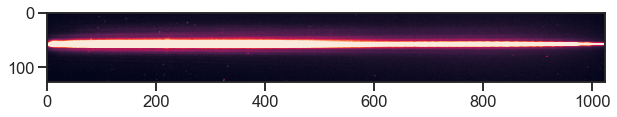

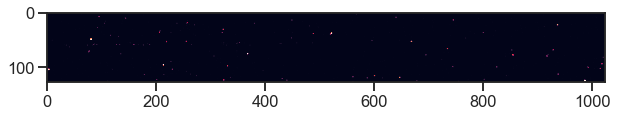

In [21]:
# let's look at the 750 data
for i in range(len(transit_750_cleaned)):
    print("Frame", i)
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_750[0][i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(transit_750_cleaned[i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_750[0][i]-transit_750_cleaned[i])
    im.set_clim(0,200)
    plt.show()
        

Frame 0


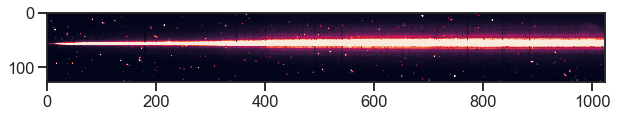

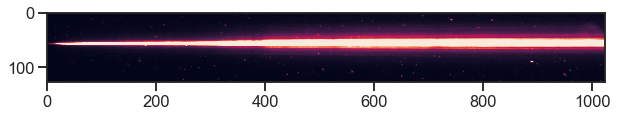

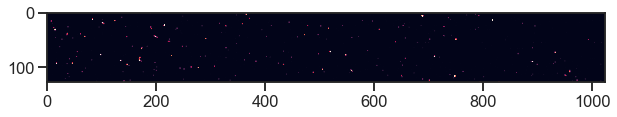

Frame 1


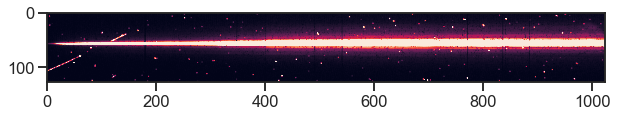

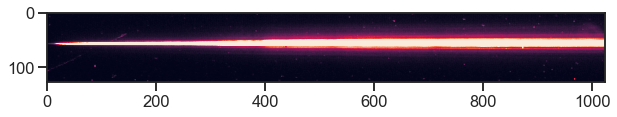

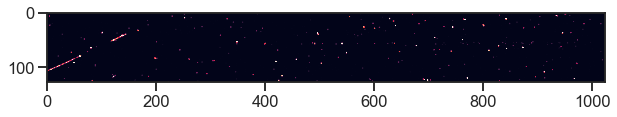

Frame 2


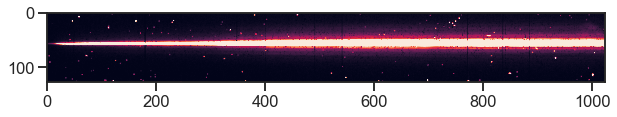

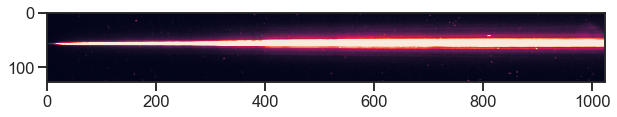

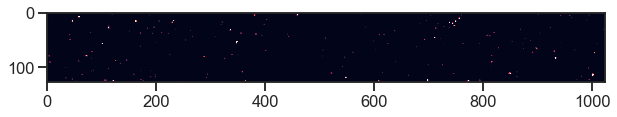

Frame 3


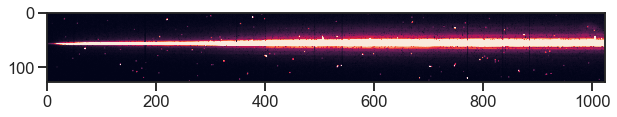

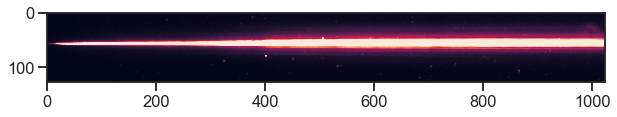

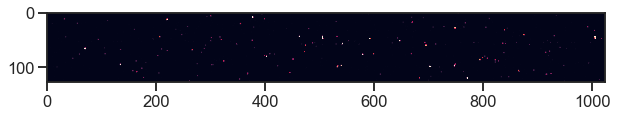

Frame 4


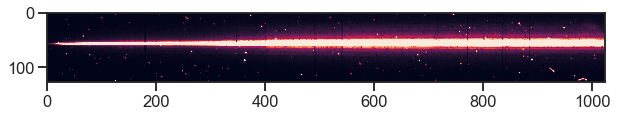

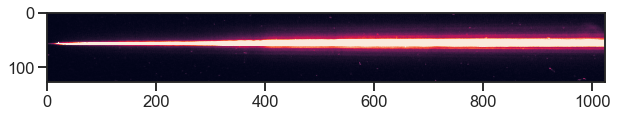

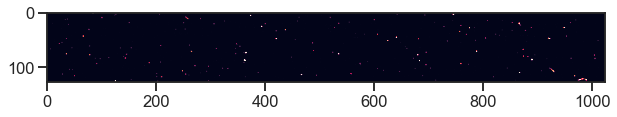

Frame 5


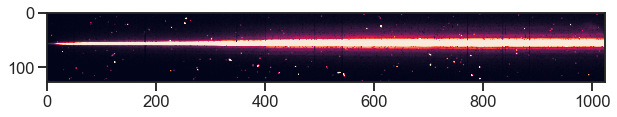

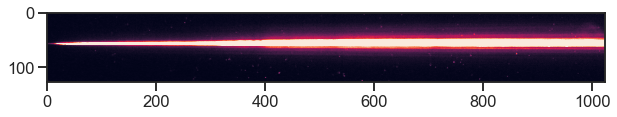

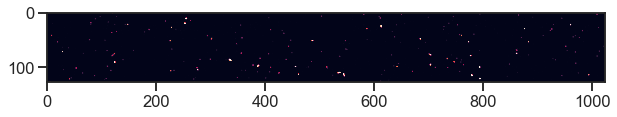

Frame 6


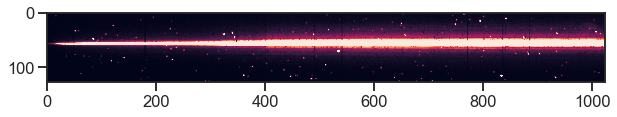

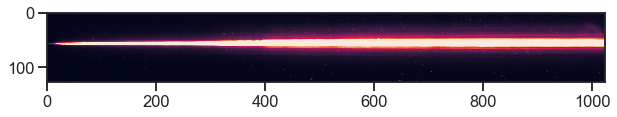

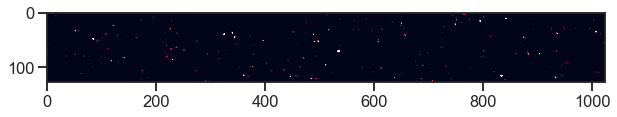

Frame 7


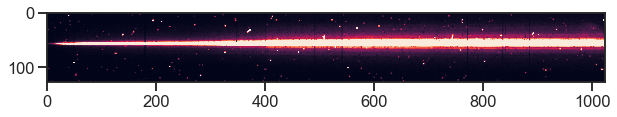

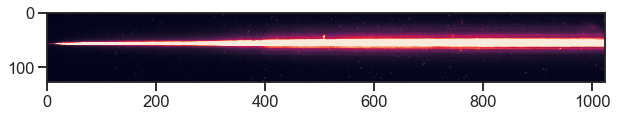

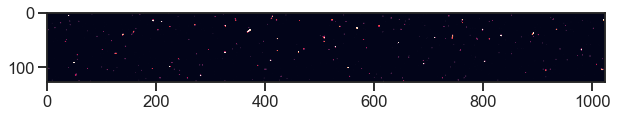

Frame 8


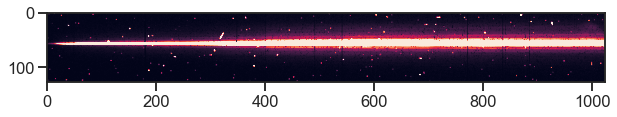

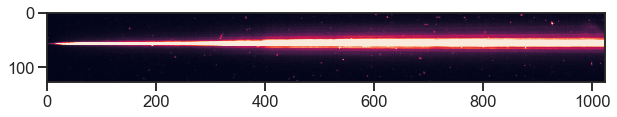

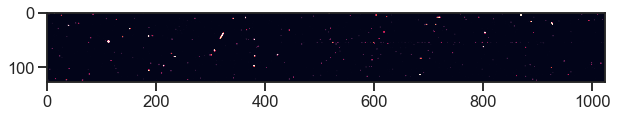

Frame 9


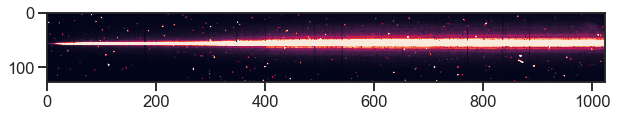

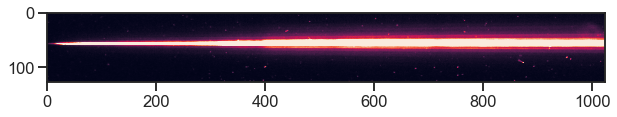

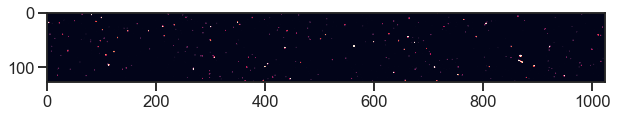

Frame 10


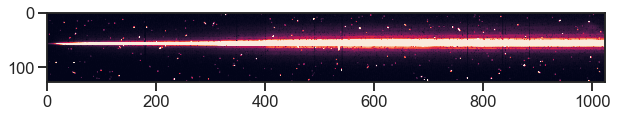

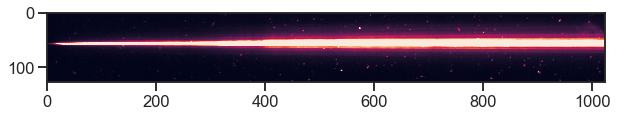

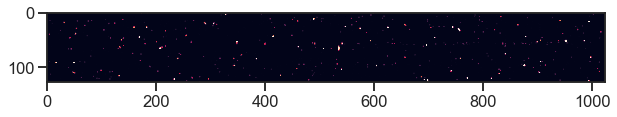

Frame 11


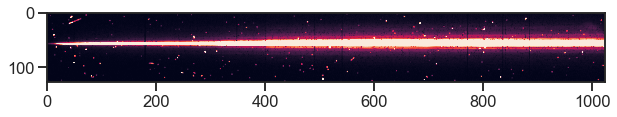

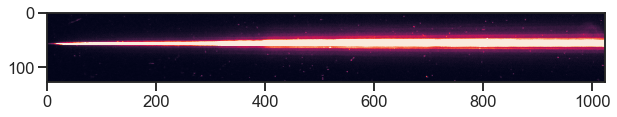

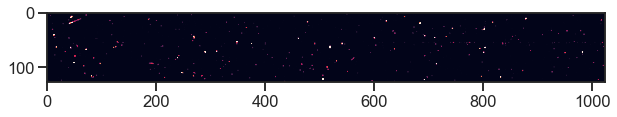

Frame 12


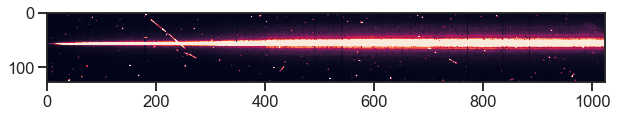

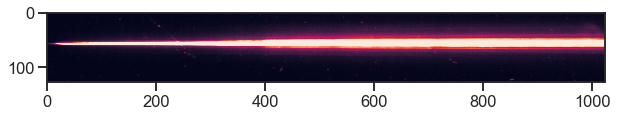

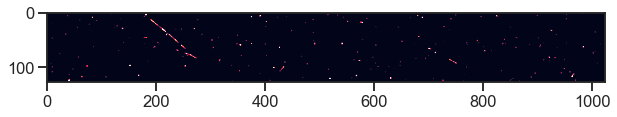

Frame 13


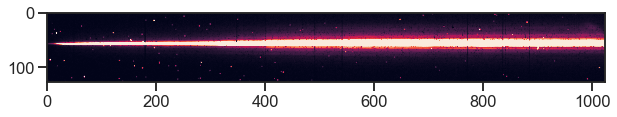

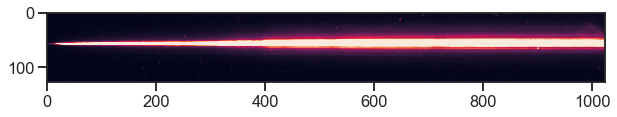

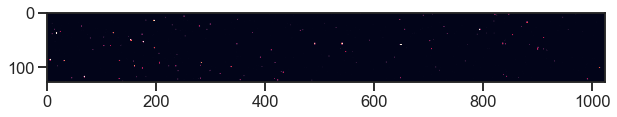

Frame 14


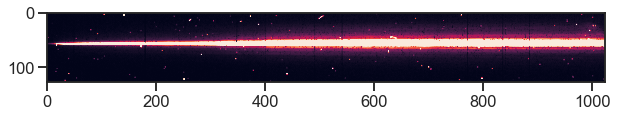

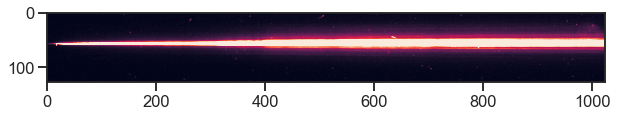

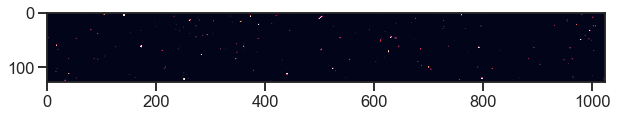

Frame 15


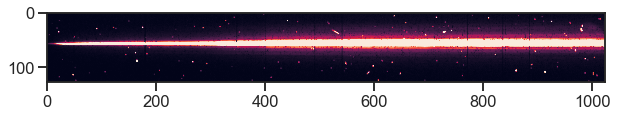

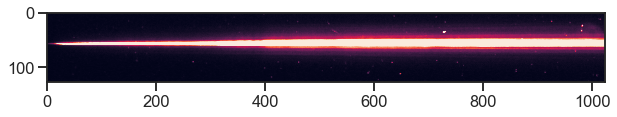

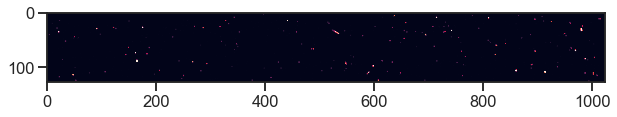

Frame 16


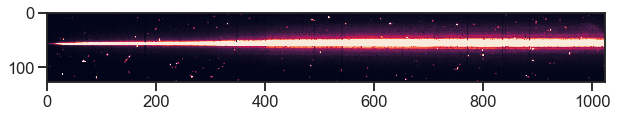

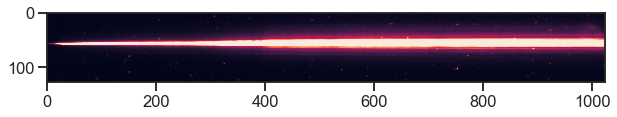

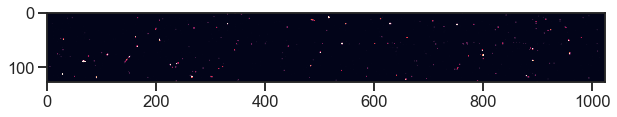

Frame 17


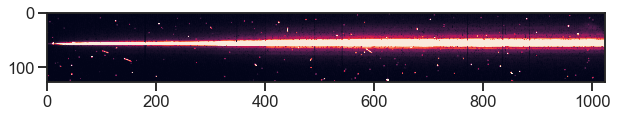

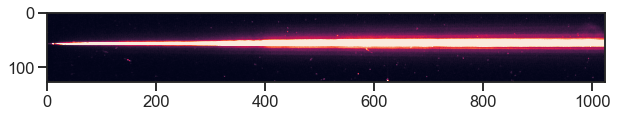

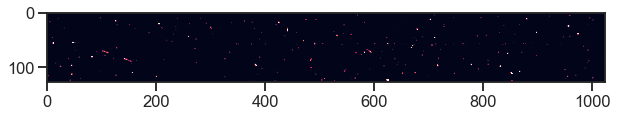

Frame 18


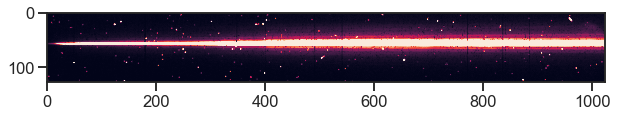

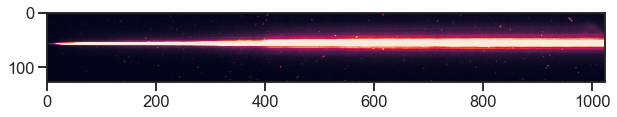

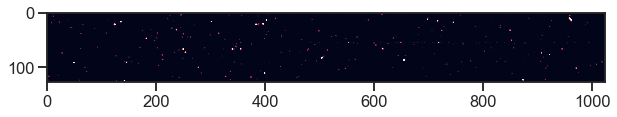

Frame 19


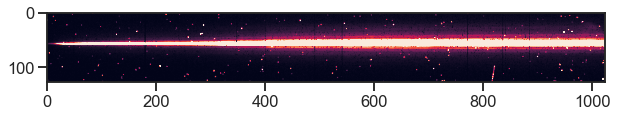

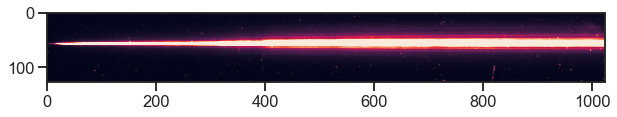

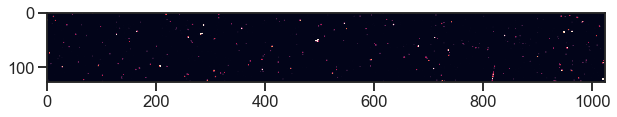

Frame 20


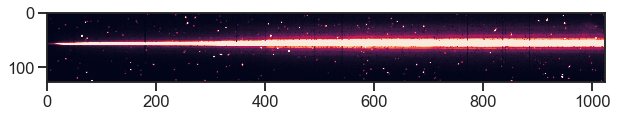

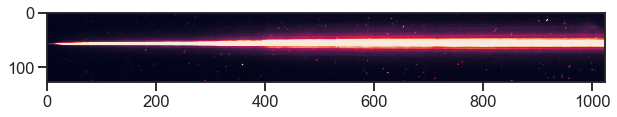

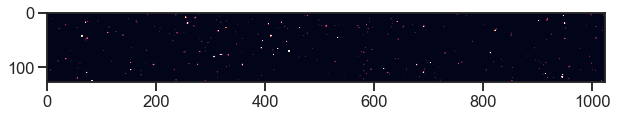

Frame 21


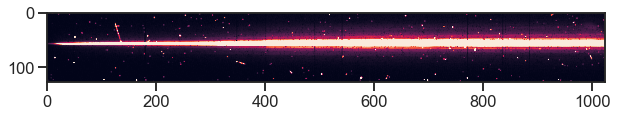

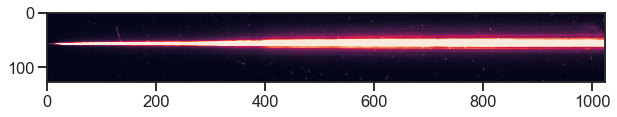

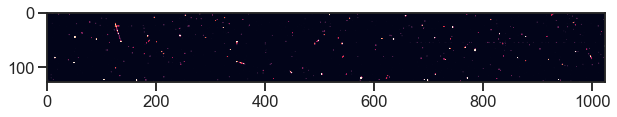

Frame 22


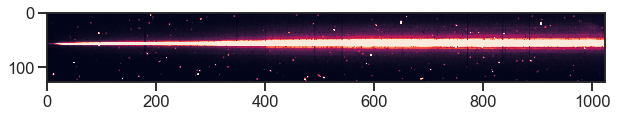

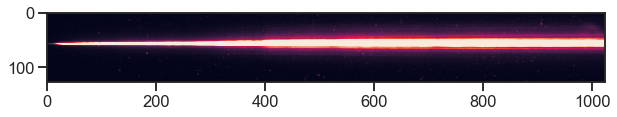

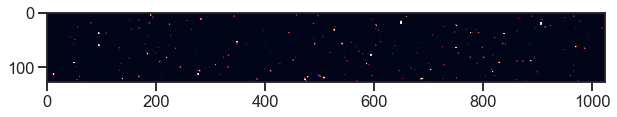

Frame 23


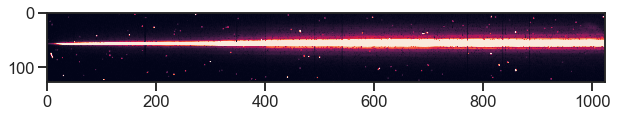

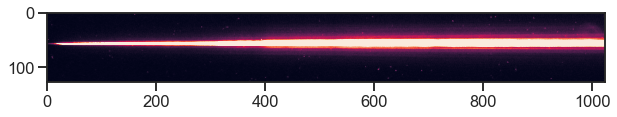

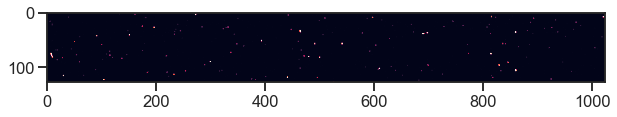

Frame 24


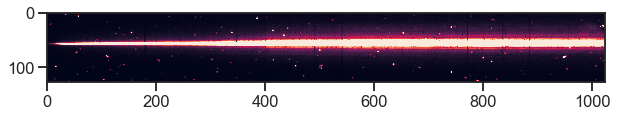

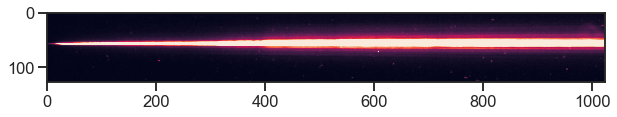

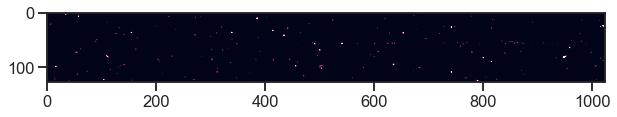

Frame 25


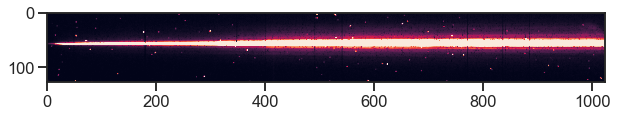

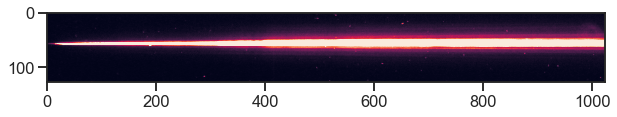

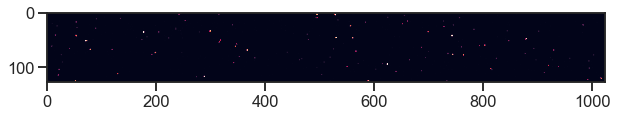

Frame 26


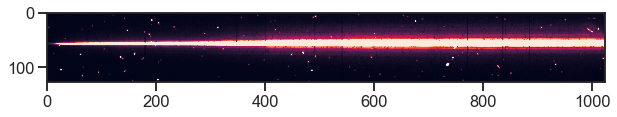

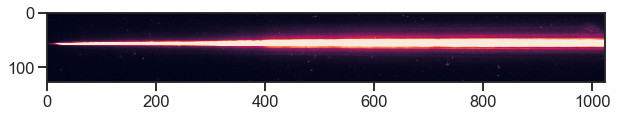

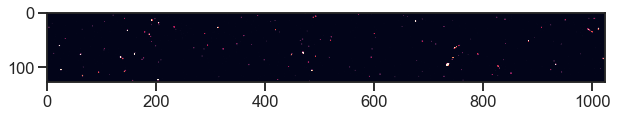

Frame 27


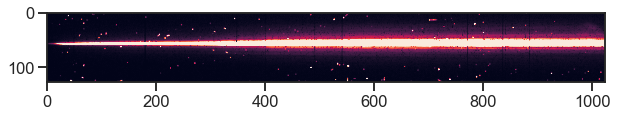

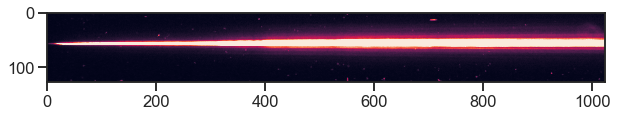

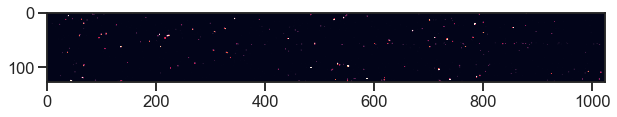

Frame 28


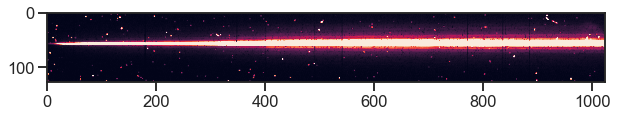

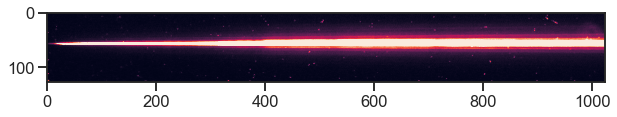

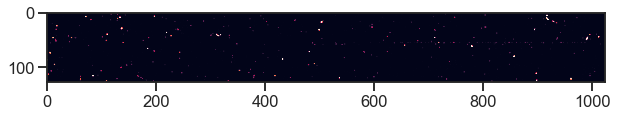

Frame 29


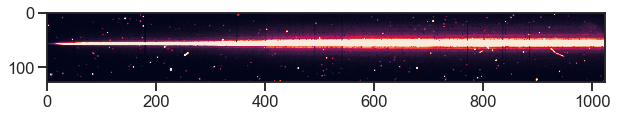

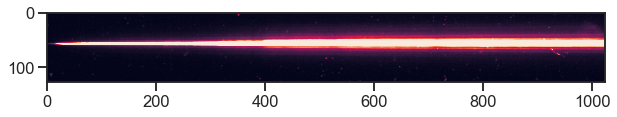

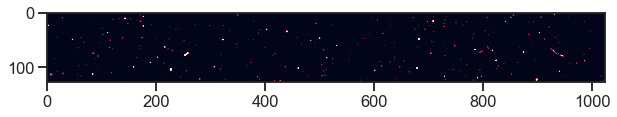

Frame 30


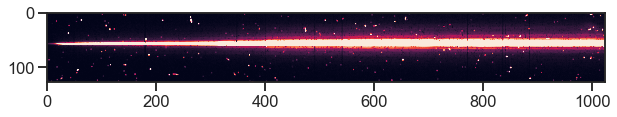

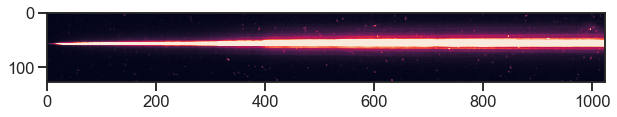

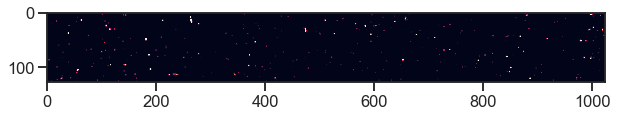

Frame 31


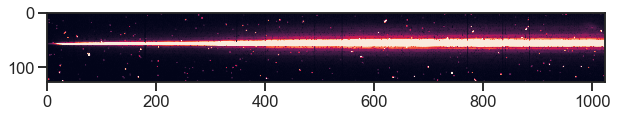

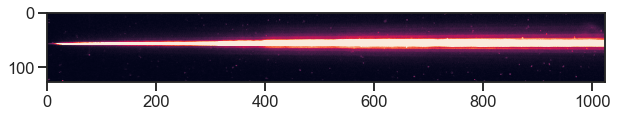

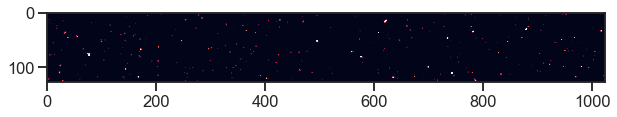

Frame 32


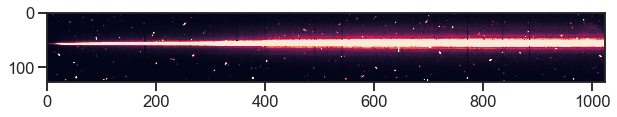

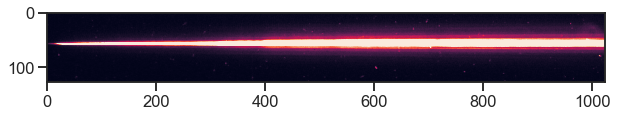

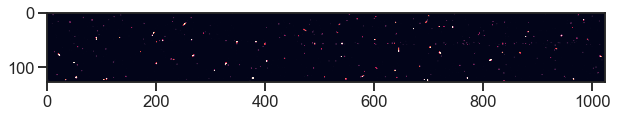

Frame 33


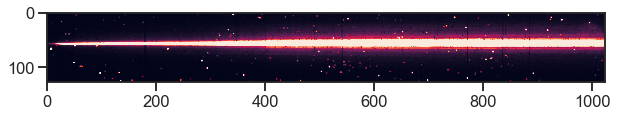

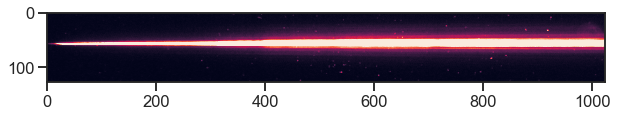

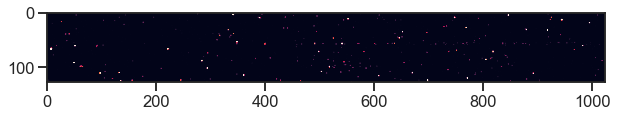

Frame 34


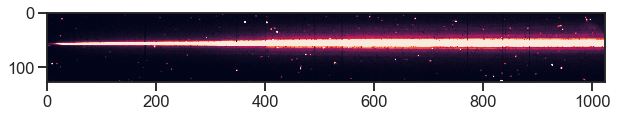

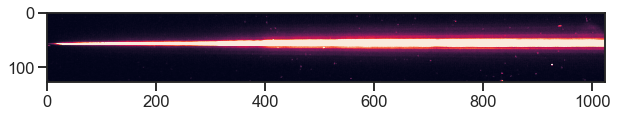

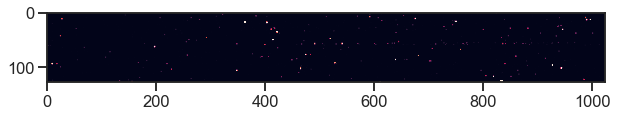

Frame 35


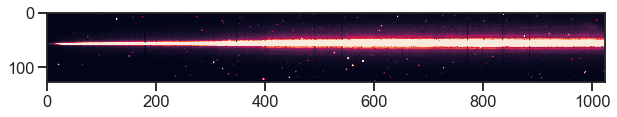

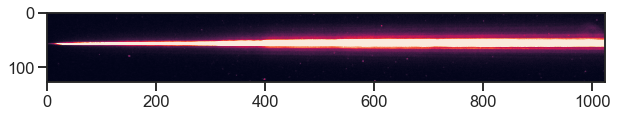

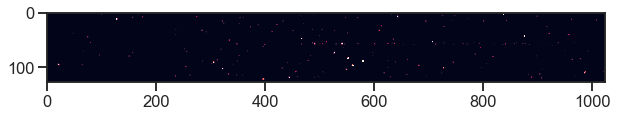

Frame 36


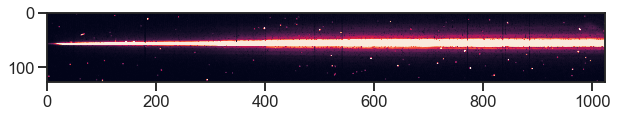

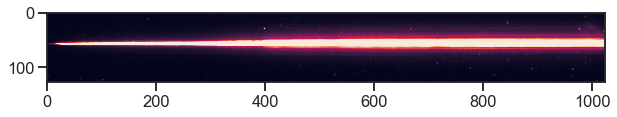

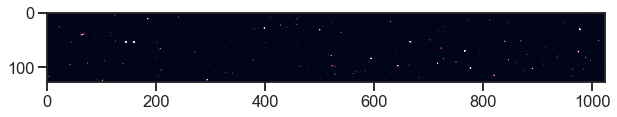

Frame 37


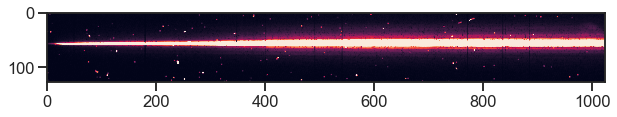

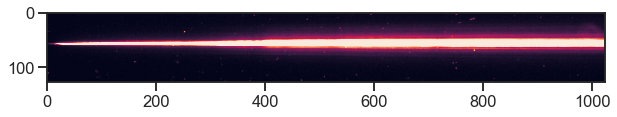

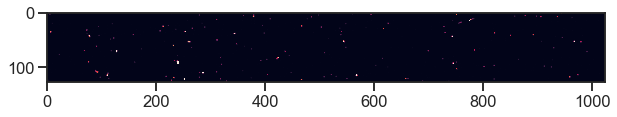

Frame 38


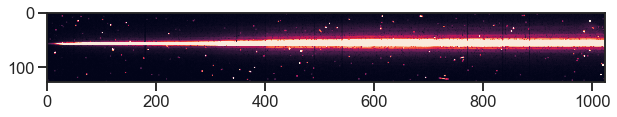

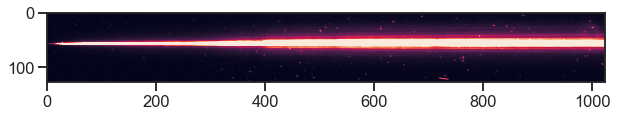

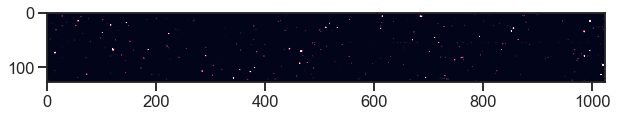

Frame 39


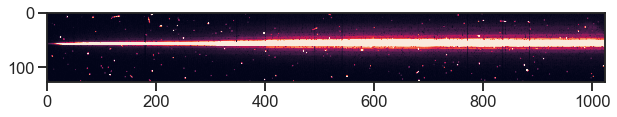

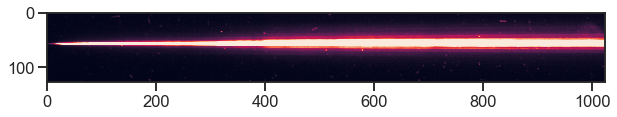

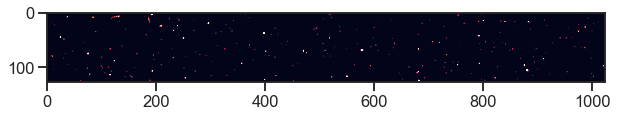

Frame 40


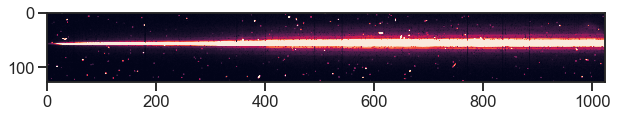

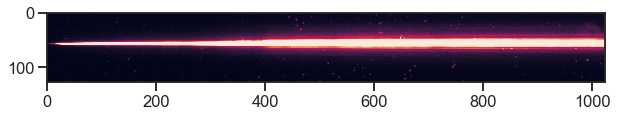

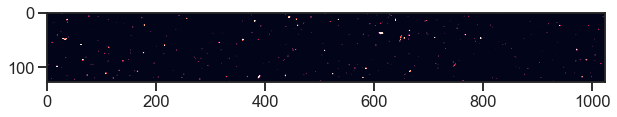

Frame 41


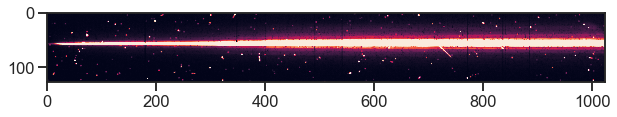

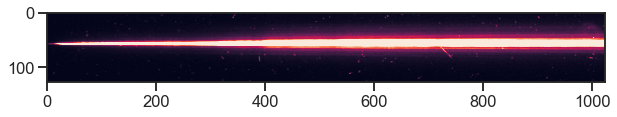

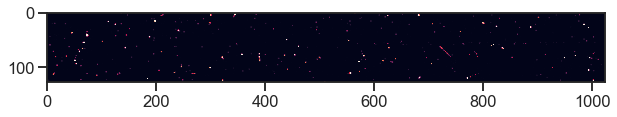

Frame 42


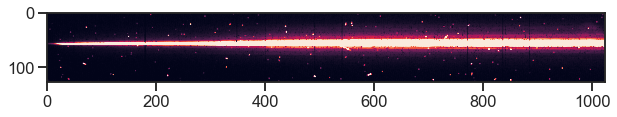

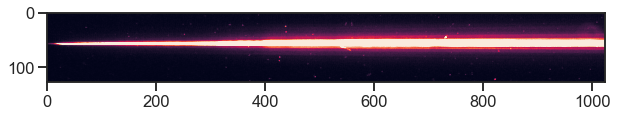

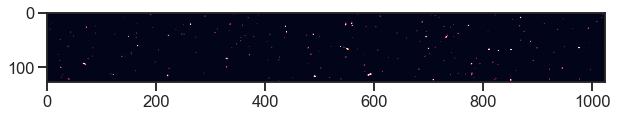

Frame 43


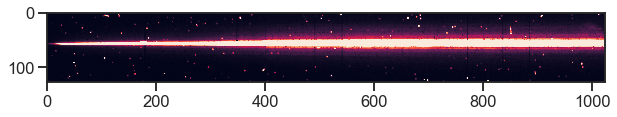

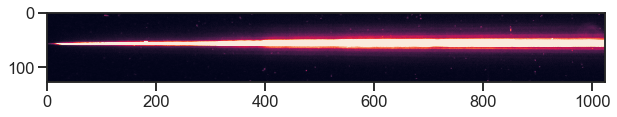

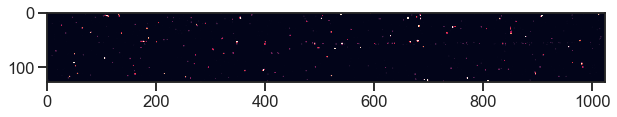

Frame 44


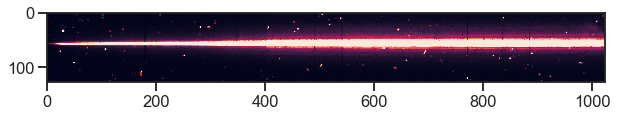

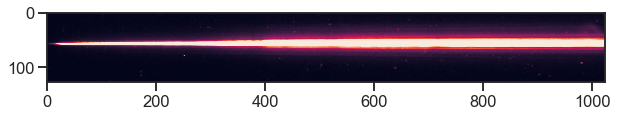

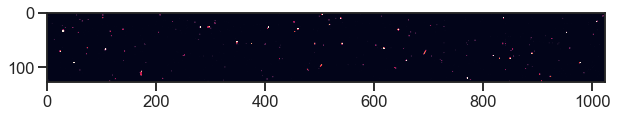

Frame 45


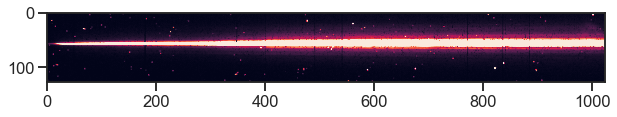

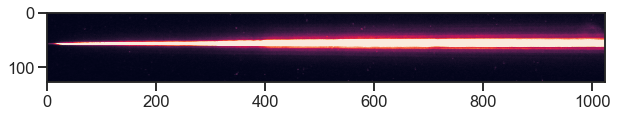

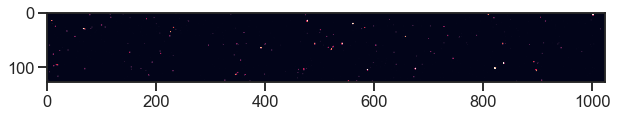

Frame 46


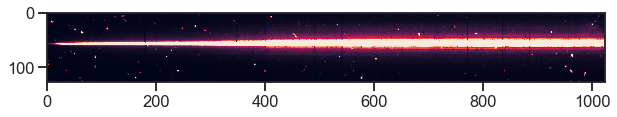

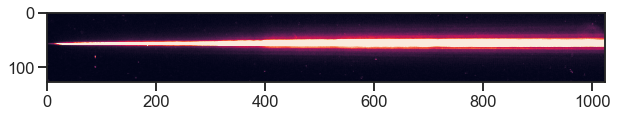

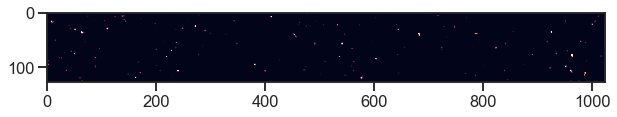

Frame 47


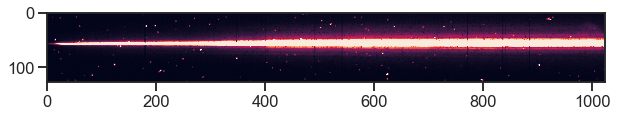

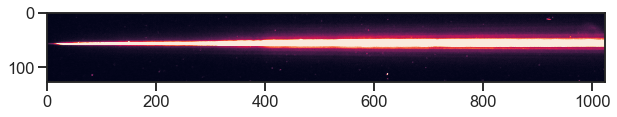

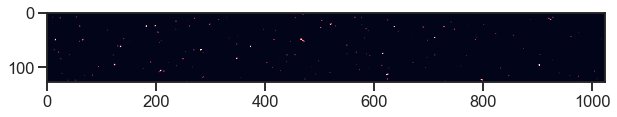

Frame 48


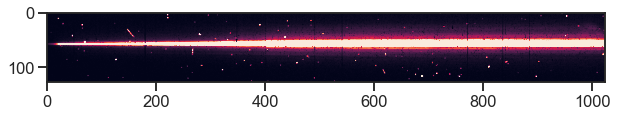

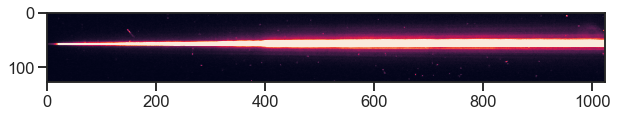

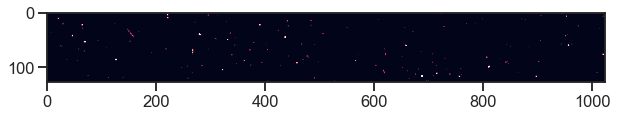

Frame 49


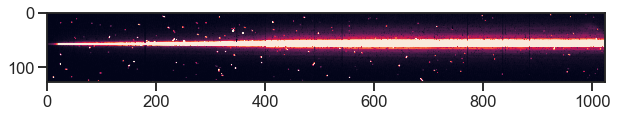

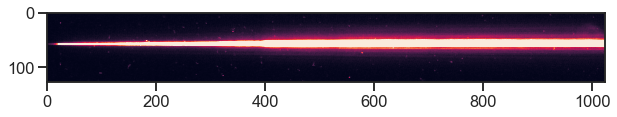

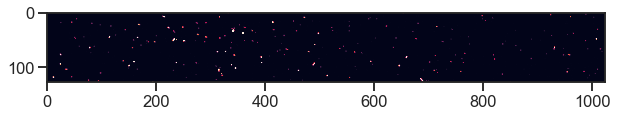

Frame 50


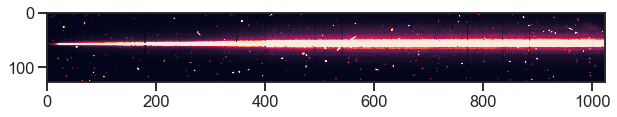

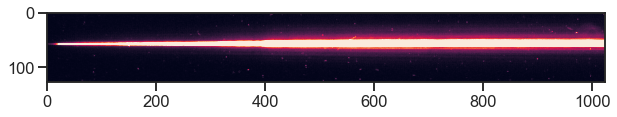

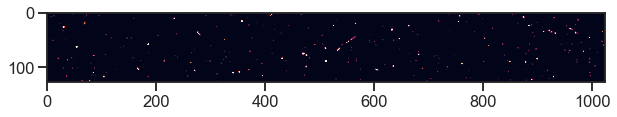

Frame 51


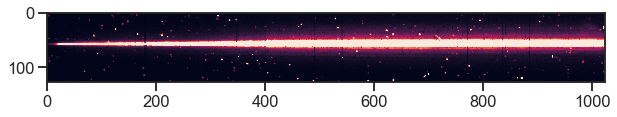

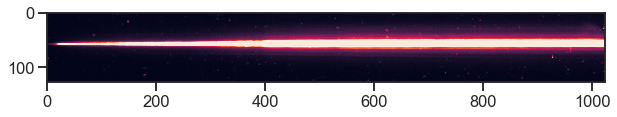

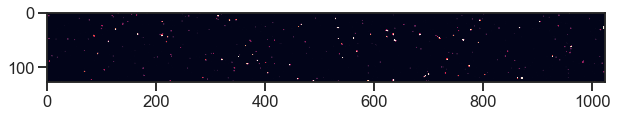

Frame 52


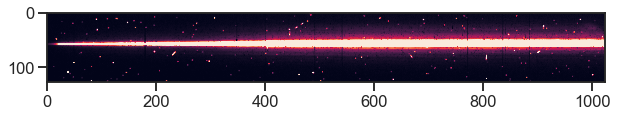

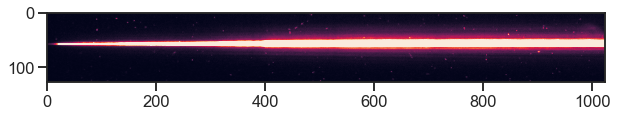

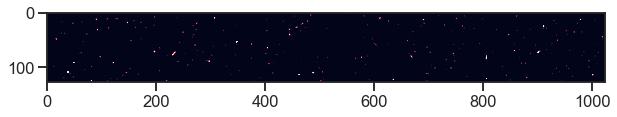

Frame 53


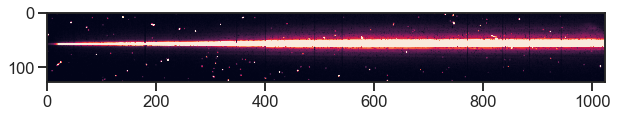

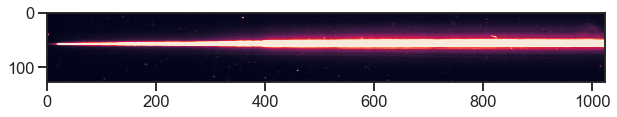

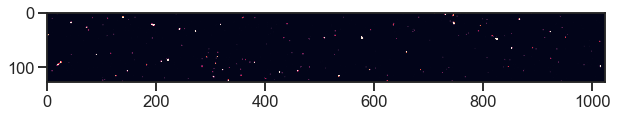

Frame 54


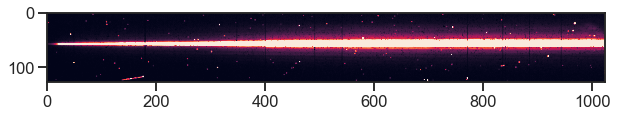

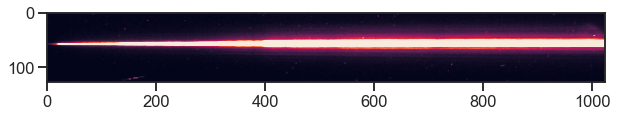

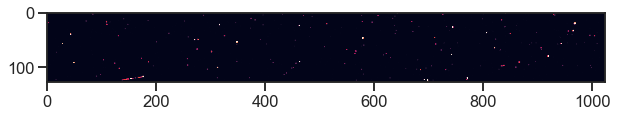

Frame 55


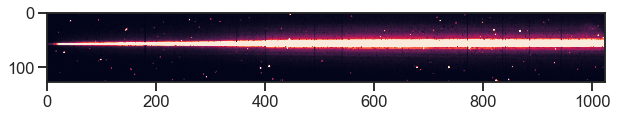

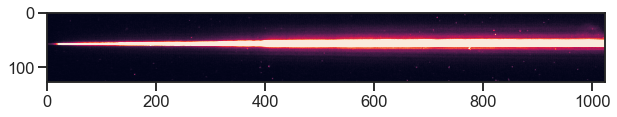

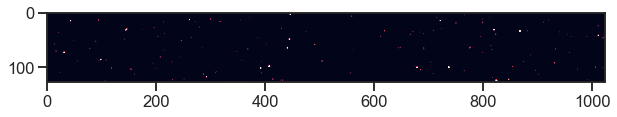

Frame 56


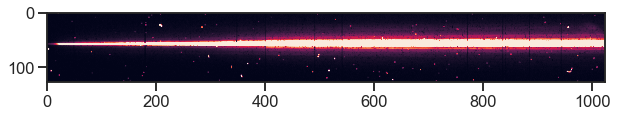

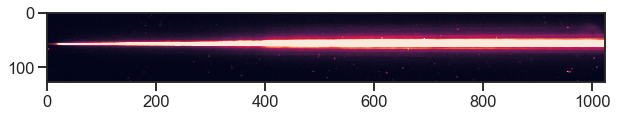

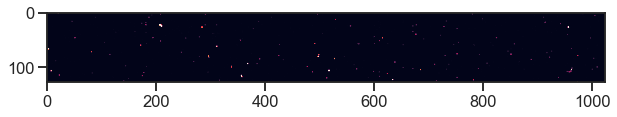

Frame 57


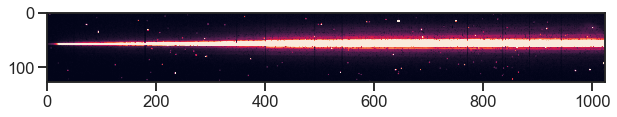

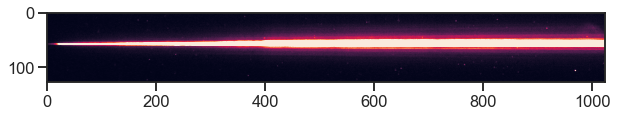

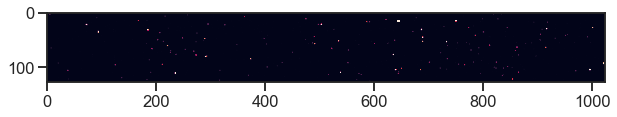

Frame 58


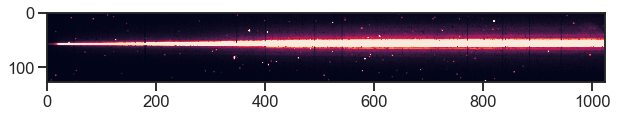

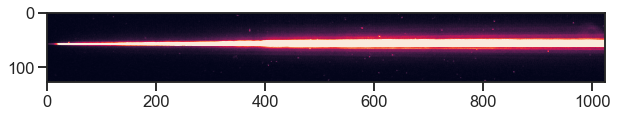

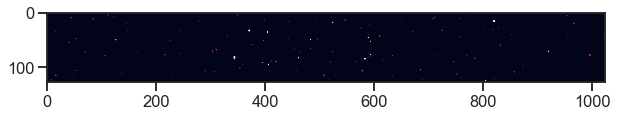

Frame 59


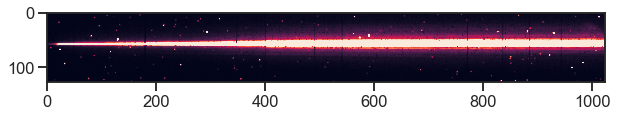

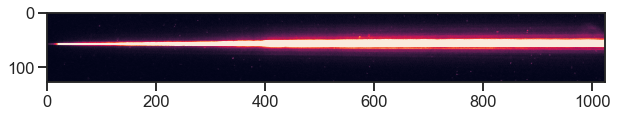

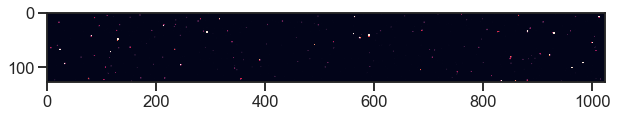

Frame 60


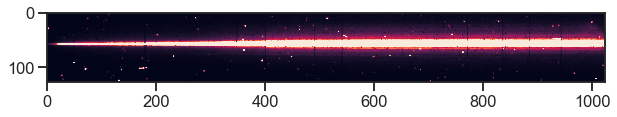

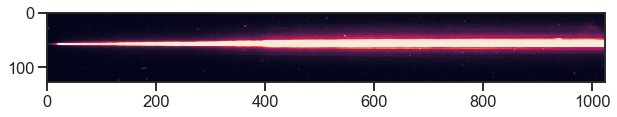

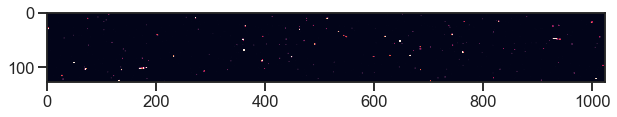

Frame 61


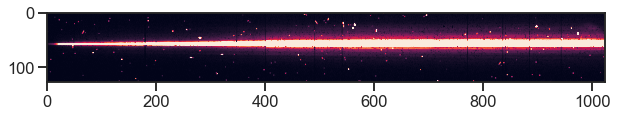

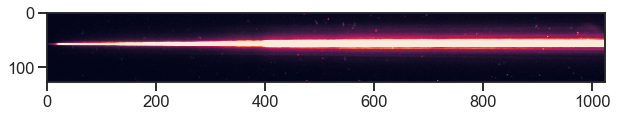

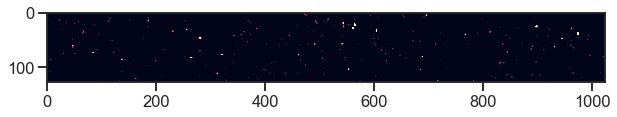

Frame 62


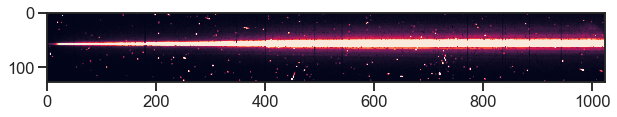

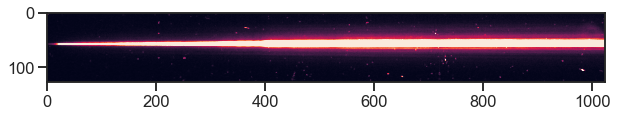

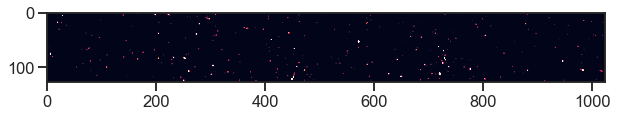

Frame 63


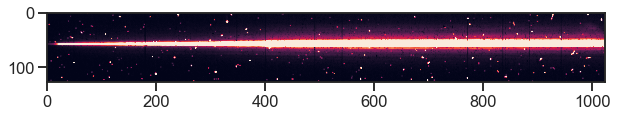

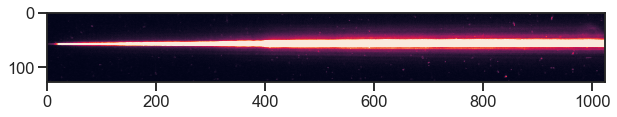

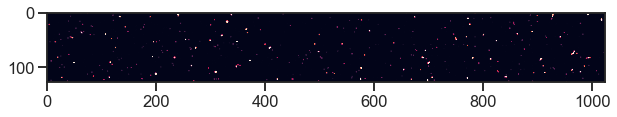

Frame 64


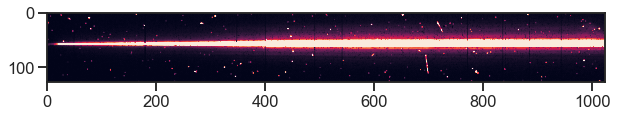

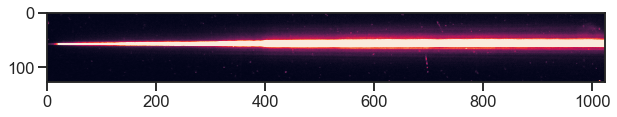

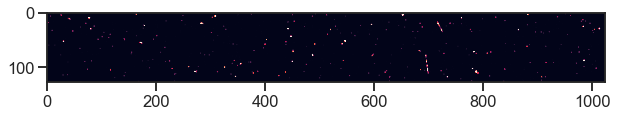

Frame 65


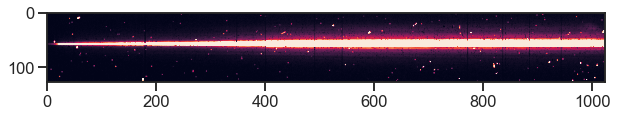

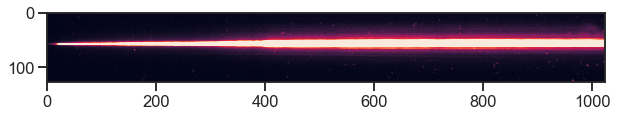

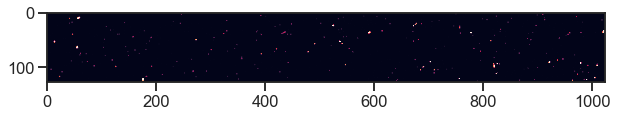

Frame 66


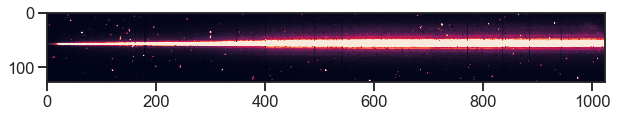

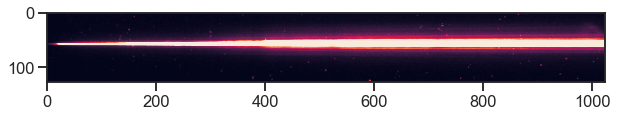

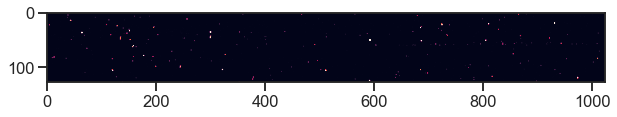

Frame 67


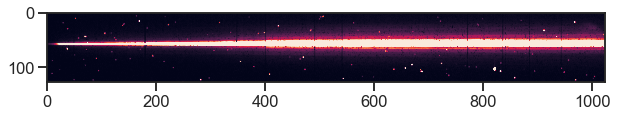

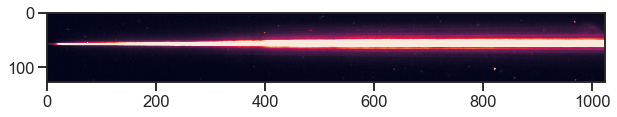

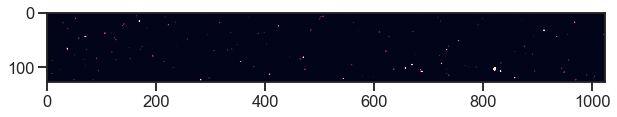

Frame 68


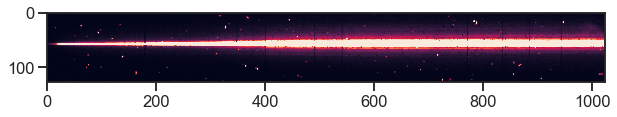

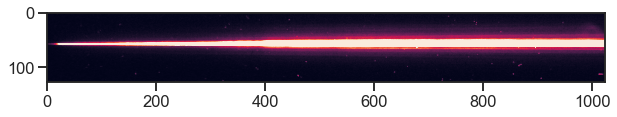

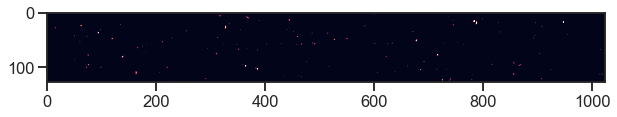

Frame 69


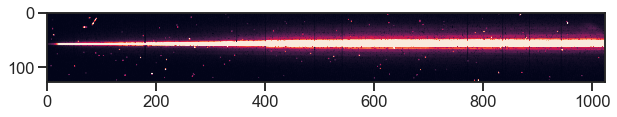

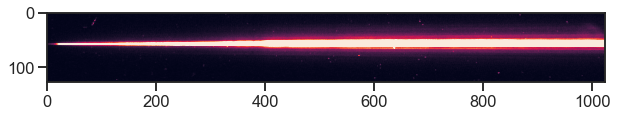

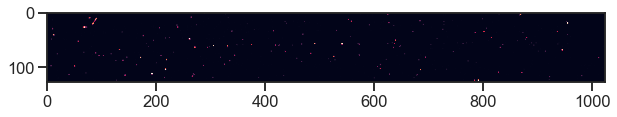

Frame 70


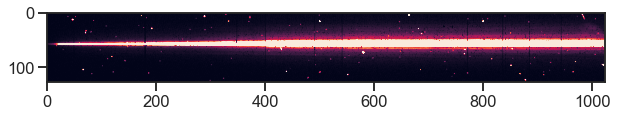

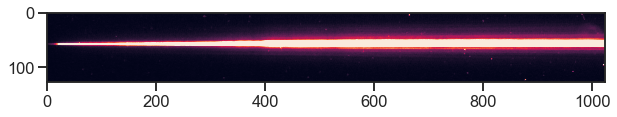

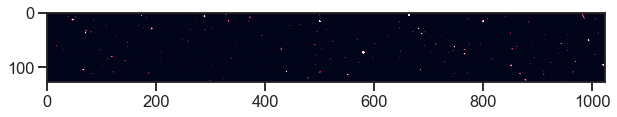

Frame 71


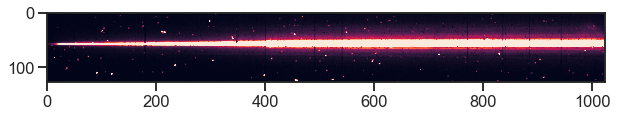

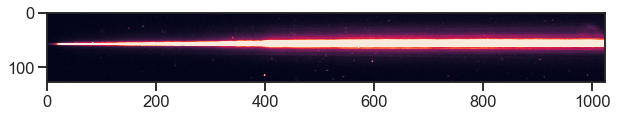

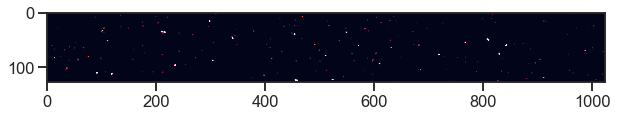

Frame 72


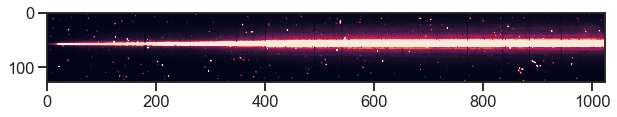

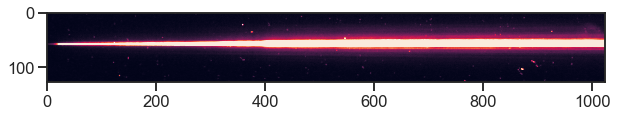

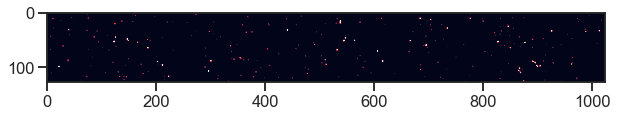

Frame 73


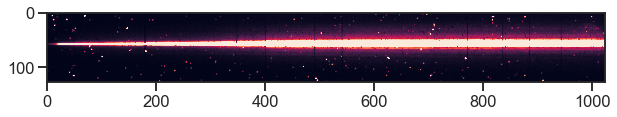

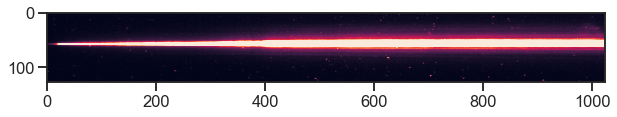

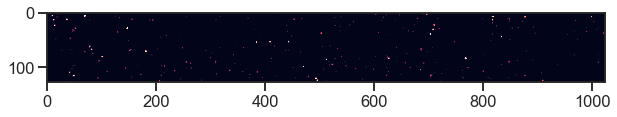

Frame 74


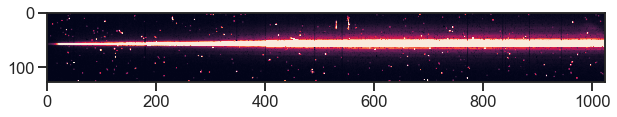

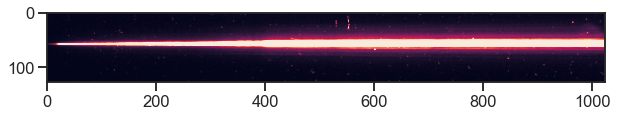

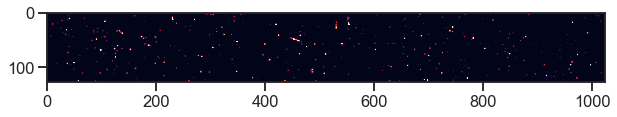

Frame 75


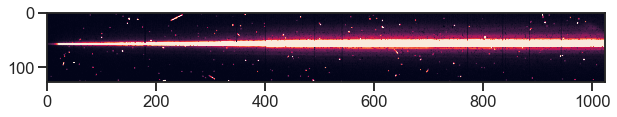

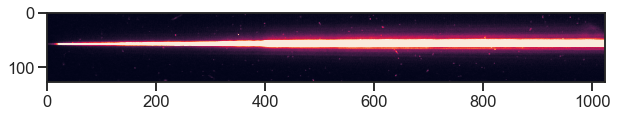

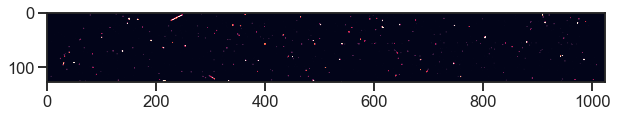

Frame 76


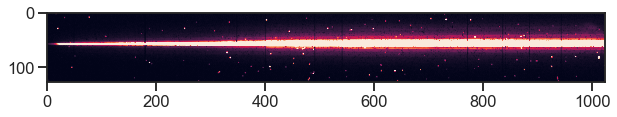

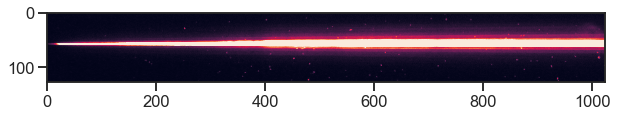

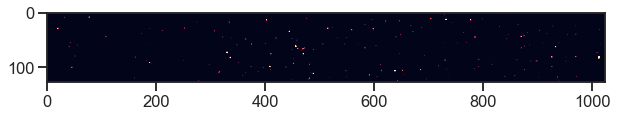

Frame 77


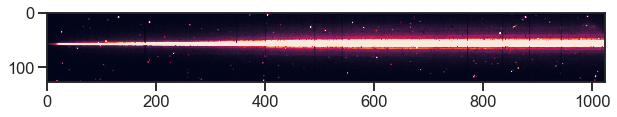

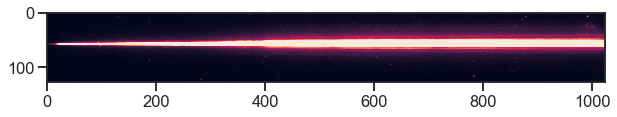

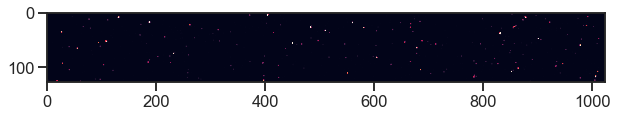

Frame 78


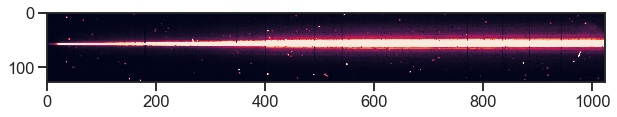

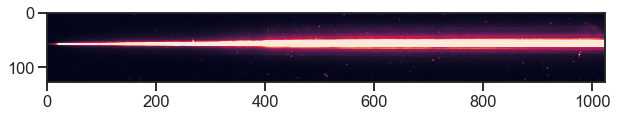

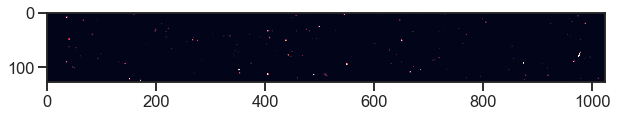

Frame 79


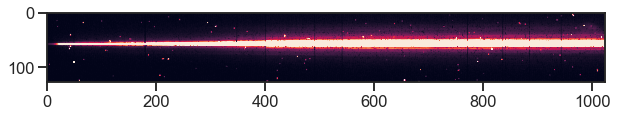

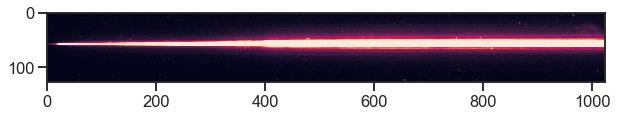

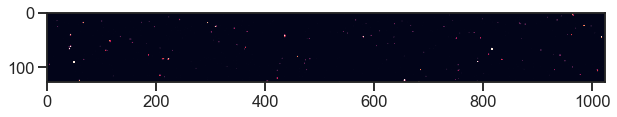

Frame 80


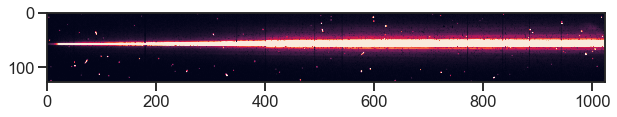

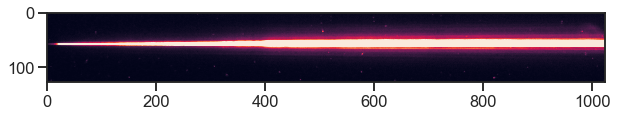

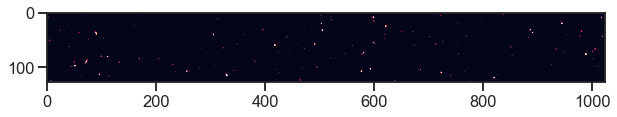

Frame 81


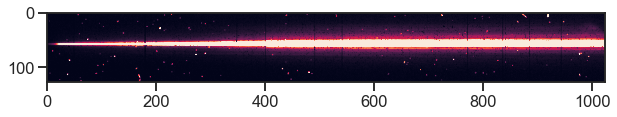

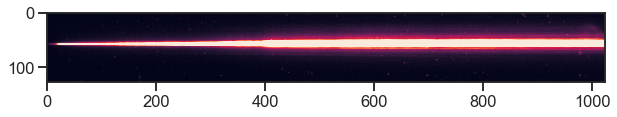

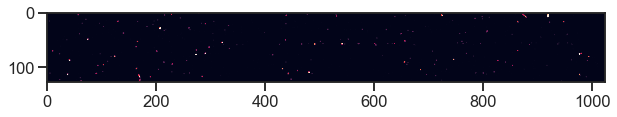

Frame 82


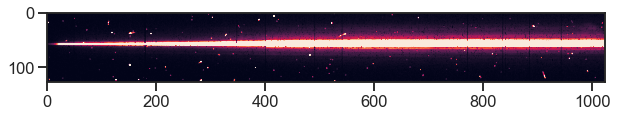

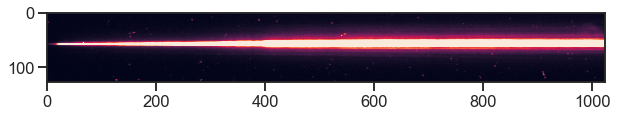

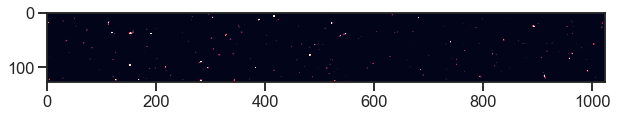

Frame 83


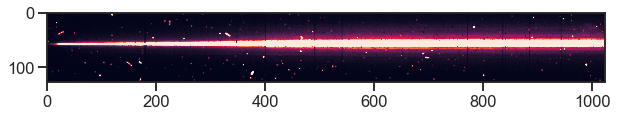

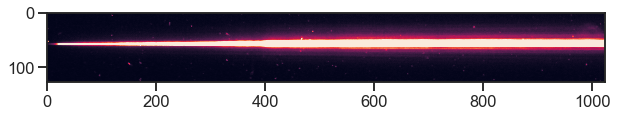

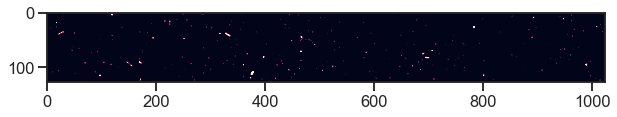

Frame 84


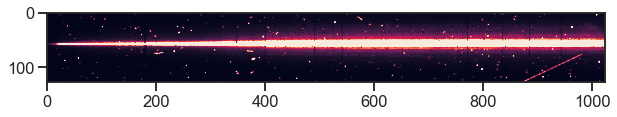

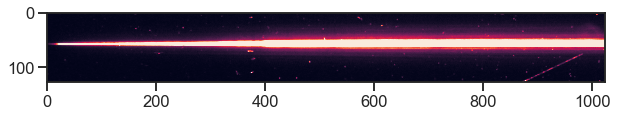

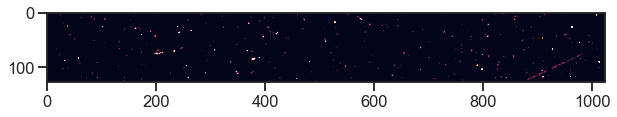

Frame 85


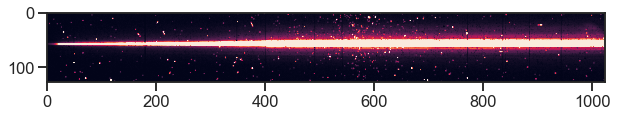

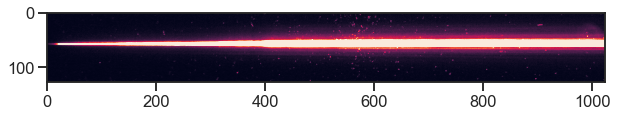

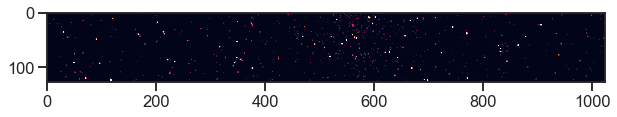

Frame 86


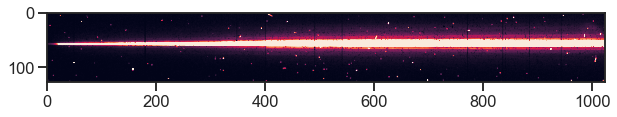

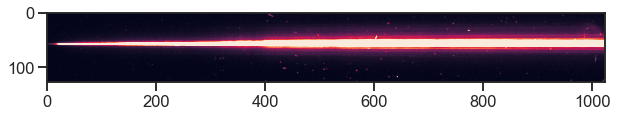

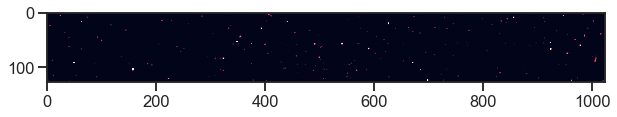

Frame 87


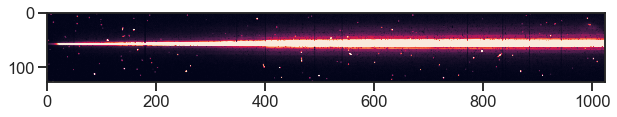

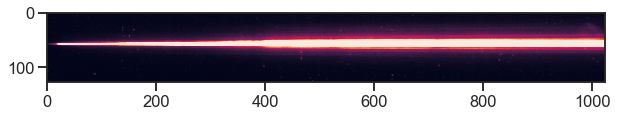

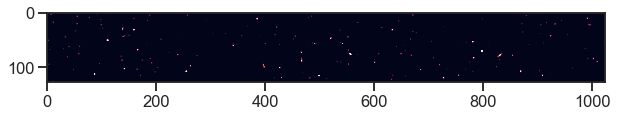

Frame 88


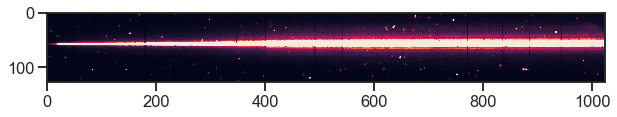

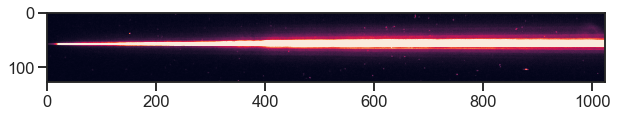

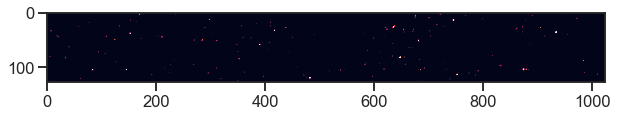

Frame 89


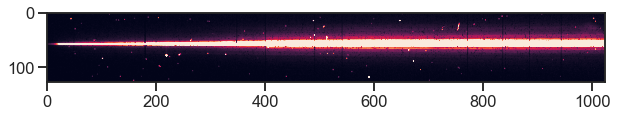

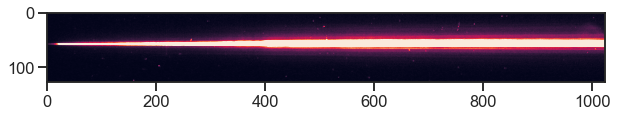

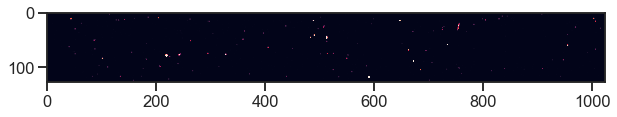

Frame 90


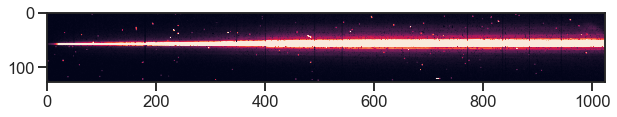

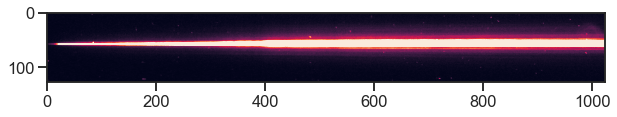

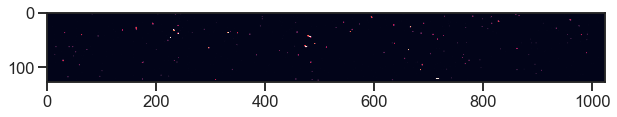

Frame 91


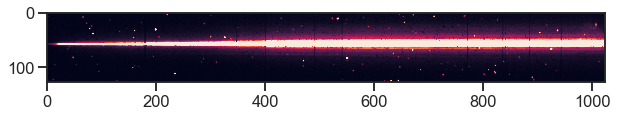

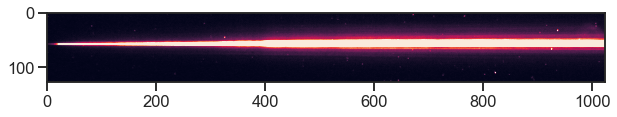

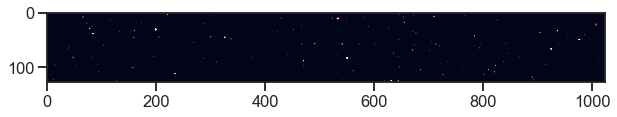

Frame 92


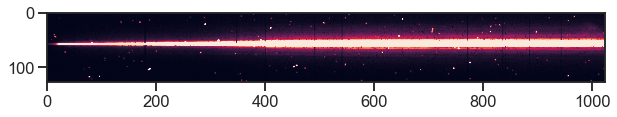

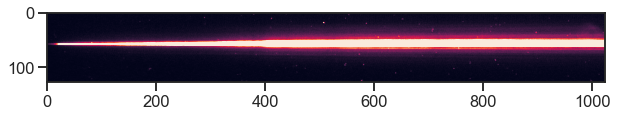

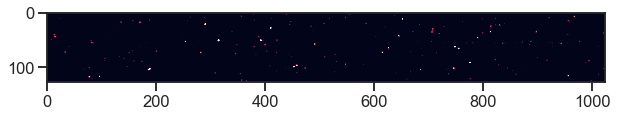

Frame 93


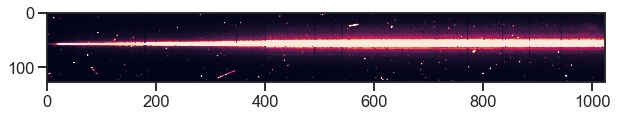

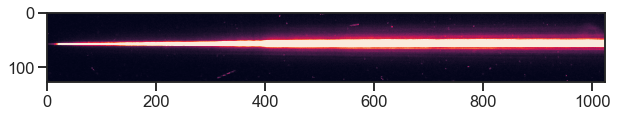

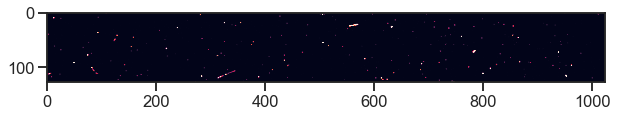

Frame 94


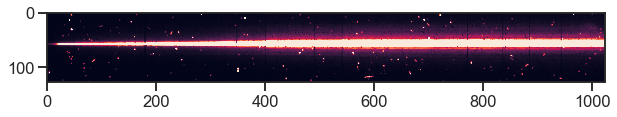

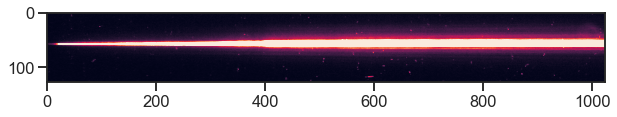

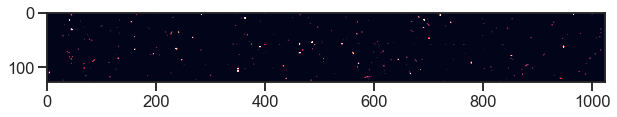

Frame 95


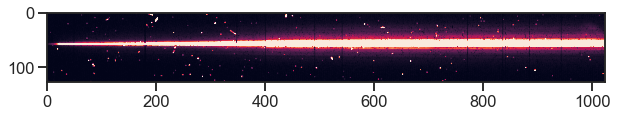

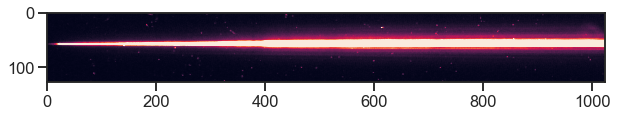

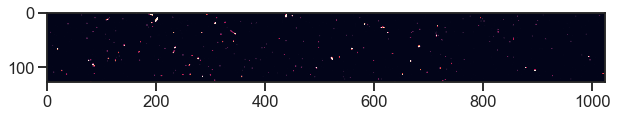

In [22]:
# and the 430 data
transit_430_cleaned_t = transit_430_cleaned + transit_430_2_cleaned

for i in range(len(transit_430_cleaned_t)):
    print("Frame", i)
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_430[0][i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(transit_430_cleaned_t[i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_430[0][i]-transit_430_cleaned_t[i])
    im.set_clim(0,200)
    plt.show()
        

In [24]:
# save all of the cleaned images 
name = "cleaned_data_wasp121_nov15"

if os.path.exists(name) != True:
    os.makedirs(name)
for i in range(len(transit_750_cleaned)):
    filename = "cleaned_750_1_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/" +filename, transit_750_cleaned[i], data_750[1][i], overwrite=True)
    fits.append(name + "/" +filename, data_750[4][i])
    
for i in range(len(transit_430_cleaned)):
    filename = "cleaned_430_1_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/" +filename, transit_430_cleaned[i], data_430[1][i], overwrite=True)
    fits.append(name + "/" +filename, data_430[4][i])
    
for i in range(len(transit_430_2_cleaned)):
    filename = "cleaned_430_2_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/" + filename, transit_430_2_cleaned[i], data_430[1][48+i], overwrite=True)
    fits.append(name + "/" + filename, data_430[4][48+i])


In [25]:
# and then just write the jitter dictionary to a pickle file for later use
with open('jitter_750.pkl', 'wb') as handle:
    pickle.dump(data_750[2], handle, protocol=pickle.HIGHEST_PROTOCOL)

with open('jitter_430.pkl', 'wb') as handle:
    pickle.dump(data_430[2], handle, protocol=pickle.HIGHEST_PROTOCOL)

In [1]:
# now that we have the cleaned files, we don't need to run any of the above code a second time
# read those files in to have this as a new starting point
from STIS_pipeline_functions import *
name = "cleaned_data_wasp121_nov17"

cleaned_data_430_1 = sorted(glob.glob(name + "/cleaned_430_1*"))
transit_430_cleaned = []
headers_430 = []
errs_430 = []
for i in cleaned_data_430_1:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_430_cleaned.append(c_data)
    headers_430.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_430.append(e_data)
    
cleaned_data_430_2 = sorted(glob.glob(name + "/cleaned_430_2*"))
transit_430_2_cleaned = []
headers_430_2 = []
errs_430_2 = []
for i in cleaned_data_430_2:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_430_2_cleaned.append(c_data)
    headers_430_2.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_430_2.append(e_data)

with open('jitter_430.pkl', 'rb') as handle:
    jit_430 = pickle.load(handle)

/Users/natalieallen/opt/anaconda3/lib/python3.8/site-packages/autograd/numpy/numpy_wrapper.py:20: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  int_types = {_np.int, _np.int8, _np.int16, _np.int32, _np.int64, _np.integer}


In [2]:
cleaned_data_750 = sorted(glob.glob(name + "/cleaned_750*"))
transit_750_cleaned = []
headers_750 = []
errs_750 = []
for i in cleaned_data_750:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_750_cleaned.append(c_data)
    headers_750.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_750.append(e_data)

with open('jitter_750.pkl', 'rb') as handle:
    jit_750 = pickle.load(handle)

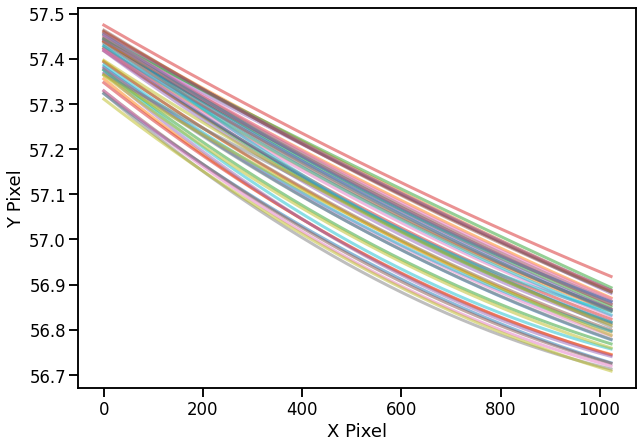

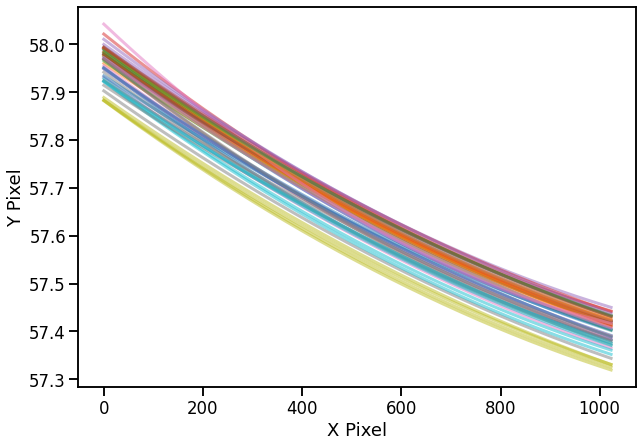

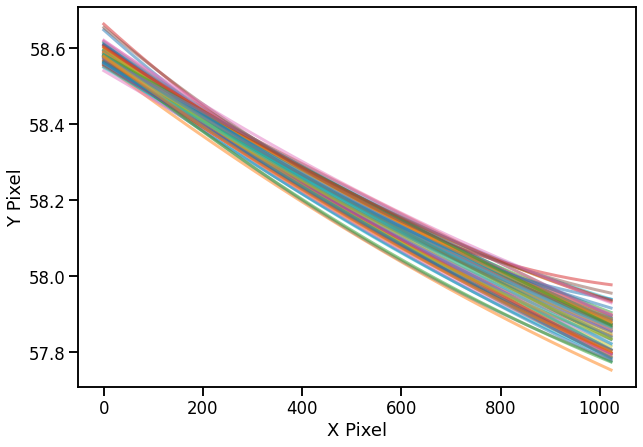

In [3]:
# now to retrace the cleaned data
trace_430_list = []
plt.figure(figsize = (10,7))
for i in transit_430_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_430_list.append(trace)

trace_430_coeffs = []
trace_430_fit = []
for j in trace_430_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_430_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_430_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_cleaned[0][0])),coeffs1)]
    trace_430_fit.append(trace)
    trace_430_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

trace_430_2_list = []
plt.figure(figsize = (10,7))
for i in transit_430_2_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_430_2_list.append(trace)

trace_430_2_coeffs = []
trace_430_2_fit = []
for j in trace_430_2_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_430_2_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_2_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_430_2_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_2_cleaned[0][0])),coeffs1)]
    trace_430_2_fit.append(trace)
    trace_430_2_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

trace_750_list = []
plt.figure(figsize = (10,7))
for i in transit_750_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_750_list.append(trace)

trace_750_coeffs = []
trace_750_fit = []
for j in trace_750_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_750_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_750_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_750_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_750_cleaned[0][0])),coeffs1)]
    trace_750_fit.append(trace)
    trace_750_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()


In [4]:
# now for the spectral extraction - I use optimal since I don't do the spline cleaning, and I feed in the ron and 
# gain values from the header
spectra_430 = []
for i in range(len(transit_430_cleaned)):
    spec = spectral_extraction(transit_430_cleaned[i], trace_430_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_430.append(spec)

In [5]:
spectra_430_2 = []
for i in range(len(transit_430_2_cleaned)):
    spec = spectral_extraction(transit_430_2_cleaned[i], trace_430_2_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_430_2.append(spec)

In [6]:
spectra_750 = []
for i in range(len(transit_750_cleaned)):
    spec = spectral_extraction(transit_750_cleaned[i], trace_750_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_750.append(spec)

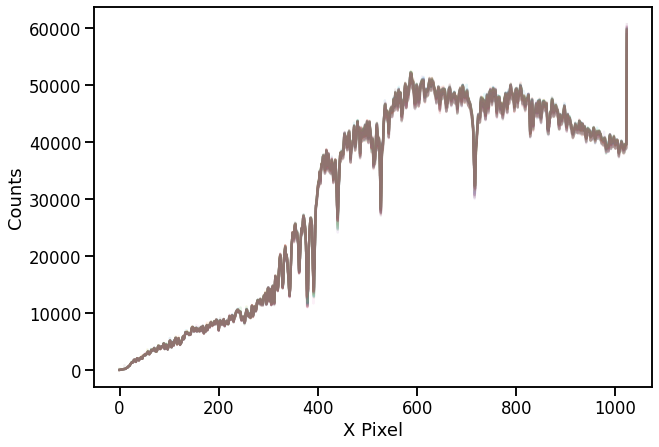

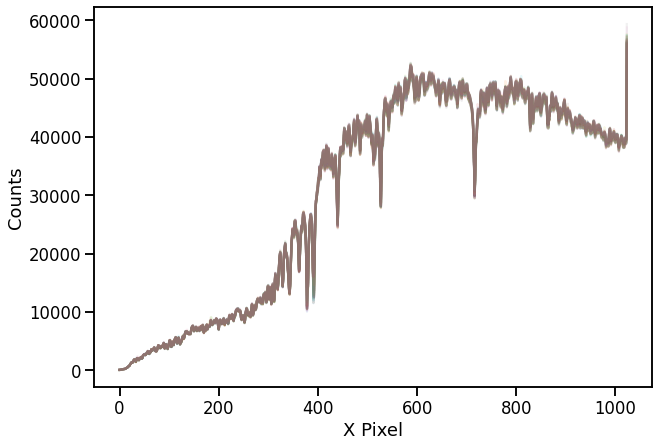

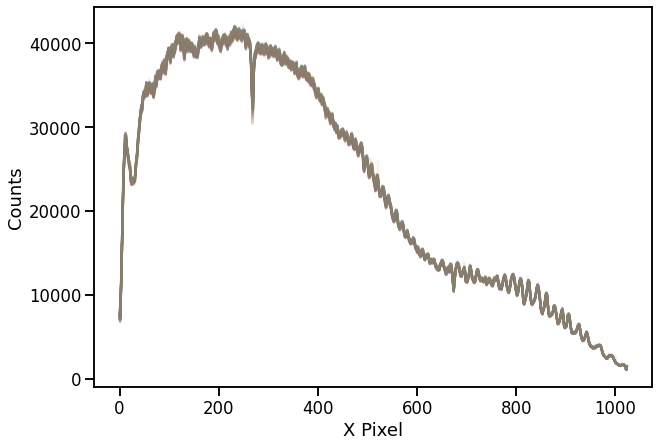

In [7]:
# plot all of the spectra on top of each other - looks good! just like in the wasp-121 paper
plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

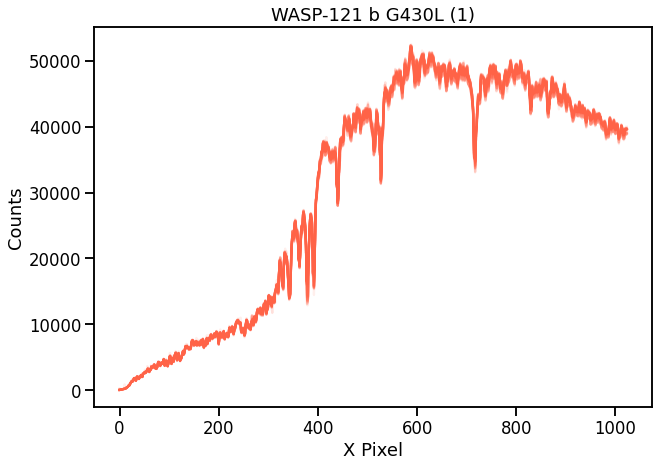

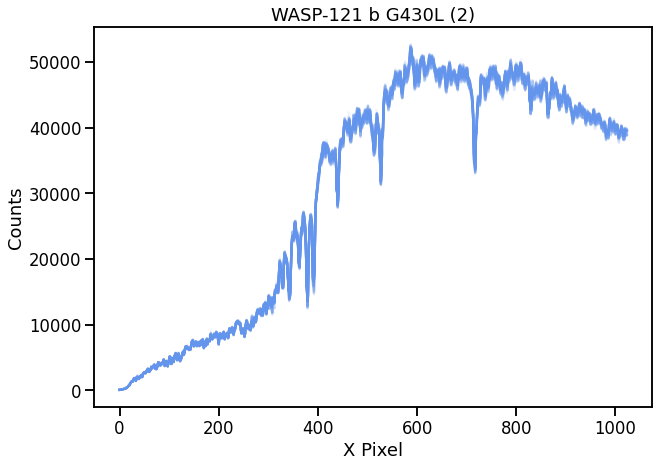

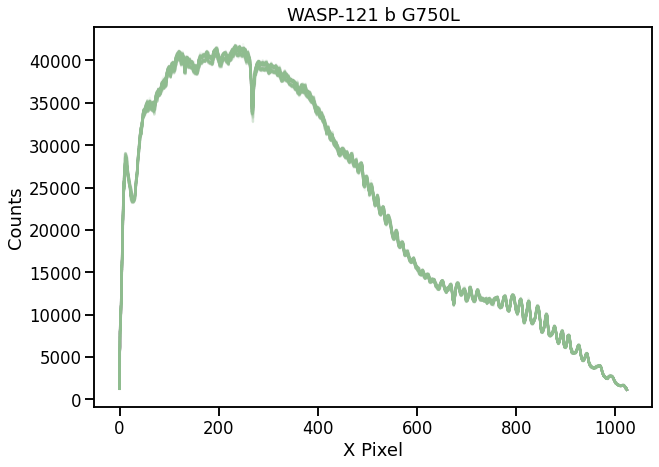

In [8]:
# hm, there's maybe a few outliers, so let's just try to get rid of some of those using a basic median filter function
spectra_430 = spectrum_outliers(spectra_430)
spectra_430_2 = spectrum_outliers(spectra_430_2)
spectra_750 = spectrum_outliers(spectra_750)

plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(i[1], alpha = 0.1, color = "tomato")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-121 b G430L (1)")
#plt.savefig("w121b_g430l_extspec1.png", dpi = 300, facecolor = "white")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(i[1], alpha = 0.1, color = "cornflowerblue")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-121 b G430L (2)")
#plt.savefig("w121b_g430l_extspec2.png", dpi = 300, facecolor = "white")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(i[1], alpha = 0.1, color = "darkseagreen")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-121 b G750L")
#plt.savefig("w121b_g750l_extspec.png", dpi = 300, facecolor = "white")
plt.show()

In [9]:
# sum up each of the spectra for the white light curve
lc_430 = []
lc_err_430 = []
for i in spectra_430:
    point = np.nansum(i[1])
    # optimal extraction outputs inverse variance, so assume np.sqrt(np.nansum((1/np.sqrt(i[2]))**2)) 
    # is the error on each point
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_430.append(point)
    lc_err_430.append(err)
    
lc_430_2 = []
lc_err_430_2 = []
for i in spectra_430_2:
    point = np.nansum(i[1])
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_430_2.append(point)
    lc_err_430_2.append(err)
    
lc_750 = []
lc_err_750 = []
for i in spectra_750:
    point = np.nansum(i[1])
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_750.append(point)
    lc_err_750.append(err)

In [10]:
# now to deal with the timestamps. HST header times come in JDUTC, we want BJD-TBD 
times_430 = times_to_bjd(headers_430, starname = "WASP-121")
times_start_430 = times_430[0][0]
times_end_430 = times_430[0][1]

times_430_2 = times_to_bjd(headers_430_2, starname = "WASP-121")
times_start_430_2 = times_430_2[0][0]
times_end_430_2 = times_430_2[0][1]

times_750 = times_to_bjd(headers_750, starname = "WASP-121")
times_start_750 = times_750[0][0]
times_end_750 = times_750[0][1]

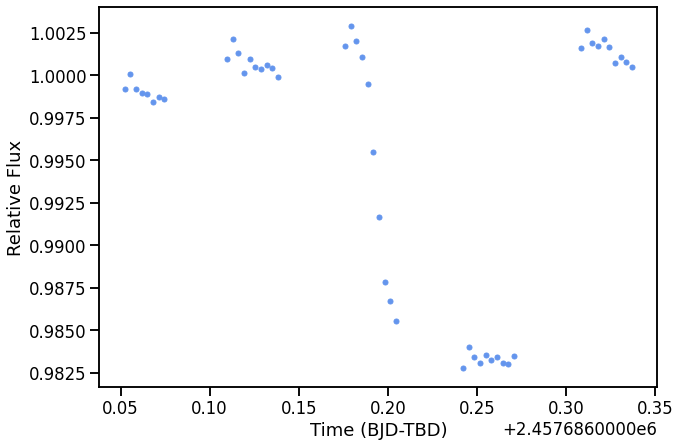

In [11]:
# should now be able to plot our raw white light curve - looks pretty good!
plt.figure(figsize = (10,7))
plt.errorbar(times_start_430, lc_430/np.nanmedian(lc_430), yerr = lc_err_430/np.nanmedian(lc_430), fmt = ".", color = "cornflowerblue", label = "var", markersize = 10)
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

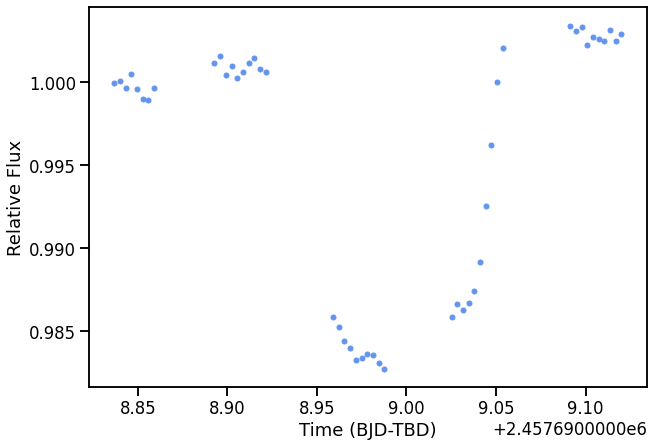

In [12]:
plt.figure(figsize = (10,7))
plt.errorbar(times_start_430_2, lc_430_2/np.nanmedian(lc_430_2), yerr = lc_err_430_2/np.nanmedian(lc_430_2), fmt = ".", color = "cornflowerblue", label = "var", markersize = 10)
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

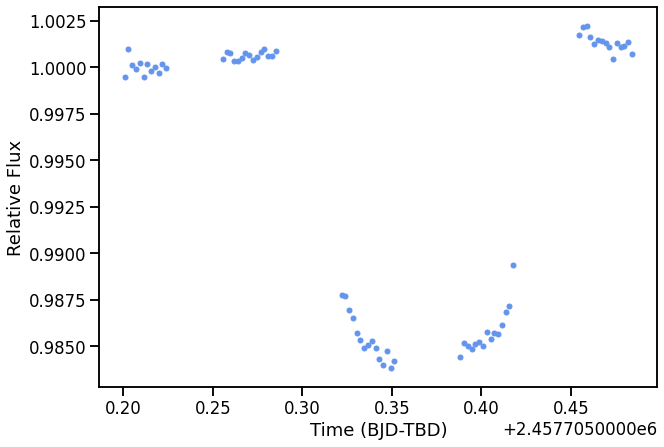

In [13]:
plt.figure(figsize = (10,7))
plt.errorbar(times_start_750, lc_750/np.nanmedian(lc_750), yerr = lc_err_750/np.nanmedian(lc_750), fmt = ".", color = "cornflowerblue", label = "var", markersize = 10)
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

In [14]:
# calculate trace movement - another detrending vector
template_430 = np.nanmedian([x[1] for x in trace_430_fit], axis = 0)
movement_430 = []
movement_sum_430 = []
for i in trace_430_fit:
    movement_430.append(np.nanmedian(template_430-i[1]))
    movement_sum_430.append(np.nansum((template_430-i[1])**2))
    
template_430_2 = np.nanmedian([x[1] for x in trace_430_2_fit], axis = 0)
movement_430_2 = []
movement_sum_430_2 = []
for i in trace_430_2_fit:
    movement_430_2.append(np.nanmedian(template_430_2-i[1]))
    movement_sum_430_2.append(np.nansum((template_430_2-i[1])**2))

jit_430["Y"] = movement_430 + movement_430_2
jit_430["Y_sum"] = movement_sum_430 + movement_sum_430_2

In [15]:
template_750 = np.nanmedian([x[1] for x in trace_750_fit], axis = 0)
movement_750 = []
movement_sum_750 = []
for i in trace_750_fit:
    movement_750.append(np.nanmedian(template_750-i[1]))
    movement_sum_750.append(np.nansum((template_750-i[1])**2))
    
    
jit_750["Y"] = movement_750
jit_750["Y_sum"] = movement_sum_750

In [16]:
# calculate trace polynomial movement - another detrending vector
template_430 = np.nanmedian(trace_430_coeffs, axis = 0)
movement_430 = []
movement_coeff1_430 = []
movement_coeff2_430 = []
for i in trace_430_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_430.append((template_430-i)[0])
    movement_coeff1_430.append((template_430-i)[1])
    movement_coeff2_430.append((template_430-i)[2])
    
#jit_430["Y"] = movement_430

template_430_2 = np.nanmedian(trace_430_2_coeffs, axis = 0)
movement_430_2 = []
movement_coeff1_430_2 = []
movement_coeff2_430_2 = []
for i in trace_430_2_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_430_2.append((template_430-i)[0])
    movement_coeff1_430_2.append((template_430-i)[1])
    movement_coeff2_430_2.append((template_430-i)[2])

#jit_430["Y"] = movement_430 + movement_430_2
jit_430["T_move"] = movement_430 + movement_430_2
jit_430["T_coeff1"] = movement_coeff1_430 + movement_coeff1_430_2
jit_430["T_coeff2"] = movement_coeff2_430 + movement_coeff2_430_2

In [17]:
template_750 = np.nanmedian(trace_750_coeffs, axis = 0)
movement_750 = []
movement_coeff1_750 = []
movement_coeff2_750 = []
for i in trace_750_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_750.append((template_750-i)[0])
    movement_coeff1_750.append((template_750-i)[1])
    movement_coeff2_750.append((template_750-i)[2])
#jit_750["Y"] = movement_750
jit_750["T_move"] = movement_750
jit_750["T_coeff1"] = movement_coeff1_750
jit_750["T_coeff2"] = movement_coeff2_750

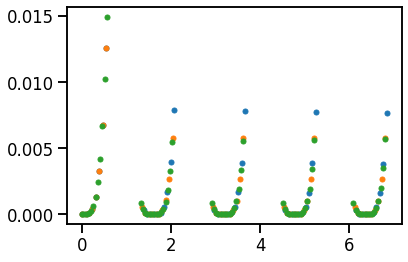

In [18]:
# last detrending vector: HST orbital phase

HST_period = 95.42/(60. * 24.) # HST period in days
#visit['orbital phase'] = juliet.utils.get_phases(visit['times'], HST_period, visit['times'][0])
phase_430_1 = juliet.utils.get_phases(times_start_430, HST_period, times_start_430[0])**4
phase_430_2 = juliet.utils.get_phases(times_start_430_2, HST_period, times_start_430_2[0])**4

jit_430["phase^4"] = list(phase_430_1) + list(phase_430_2)

jit_750["phase^4"] = juliet.utils.get_phases(times_start_750, HST_period, times_start_750[0])**4

# looks about right
plt.plot((times_start_430 - times_start_430[0])*24, phase_430_1, "o")
plt.plot((times_start_430_2 - times_start_430_2[0])*24, phase_430_2, "o")
plt.plot((times_start_750 - times_start_750[0])*24, jit_750["phase^4"], "o")

In [19]:
# before fitting, we just need to normalize our detrending vectors into standard deviation
# these are the detrending vectors to use
jit_use = ["V2_roll", "V3_roll", "Latitude", "Longitude", "RA", "DEC", "T_move", "T_coeff1", "T_coeff2", "phase^4"]

norm_jit_750 = {}
for i in jit_use:
    norm = (jit_750[i]-np.nanmean(jit_750[i]))
    norm_jit_750[i] = norm/np.std(norm)

In [20]:
jit_use = ["V2_roll", "V3_roll", "Latitude", "Longitude", "RA", "DEC", "T_move", "T_coeff1", "T_coeff2", "phase^4"]
norm_jit_430 = {}
for i in jit_use:
    norm = (jit_430[i][:48]-np.nanmean(jit_430[i][:48]))
    norm_jit_430[i] = norm/np.std(norm)
    
norm_jit_430_2 = {}
for i in jit_use:
    norm = (jit_430[i][48:]-np.nanmean(jit_430[i][48:]))
    norm_jit_430_2[i] = norm/np.std(norm)

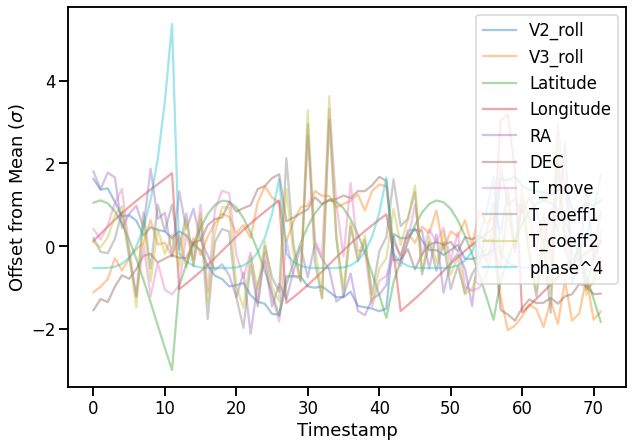

In [21]:
# check them out 
plt.figure(figsize = (10,7))
for i in norm_jit_750:
    plt.plot(norm_jit_750[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

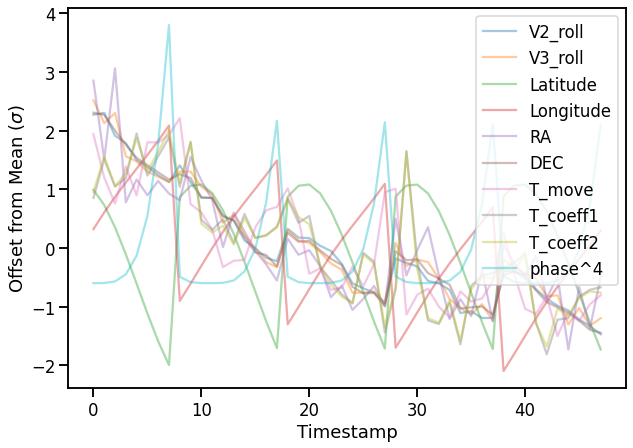

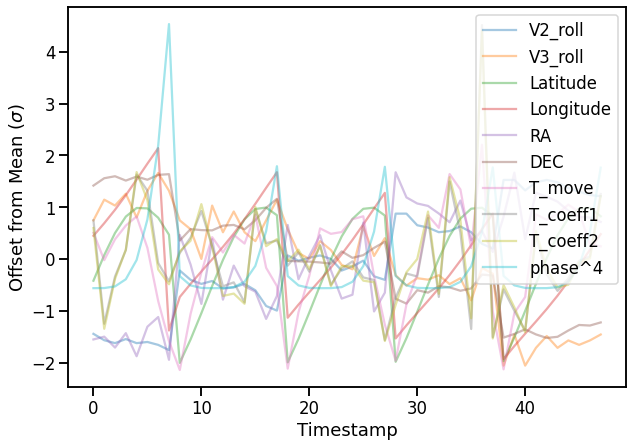

In [22]:
plt.figure(figsize = (10,7))
for i in norm_jit_430:
    plt.plot(norm_jit_430[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

plt.figure(figsize = (10,7))
for i in norm_jit_430_2:
    plt.plot(norm_jit_430_2[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

In [23]:
# now we need to run PCA on these detrending vectors
# do the PCA
vectors = [norm_jit_430[i] for i in list(norm_jit_430.keys())]
eigenvectors,eigenvalues,PC = classic_PCA(vectors)

norm_pc_430 = {}
j = 0
for i in PC:
    norm = (i-np.nanmean(i))
    name = "PC" + str(j)
    j = j+1
    norm_pc_430[name] = norm/np.std(norm)
    
    
vectors2 = [norm_jit_430_2[i] for i in list(norm_jit_430_2.keys())]
eigenvectors,eigenvalues,PC2 = classic_PCA(vectors2)

norm_pc_430_2 = {}
j = 0
for i in PC2:
    norm = (i-np.nanmean(i))
    name = "PC" + str(j)
    j = j+1
    norm_pc_430_2[name] = norm/np.std(norm)
    
vectors_750 = [norm_jit_750[i] for i in list(norm_jit_750.keys())]
eigenvectors,eigenvalues,PC = classic_PCA(vectors_750)

norm_pc_750 = {}
j = 0
for i in PC:
    norm = (i-np.nanmean(i))
    name = "PC" + str(j)
    j = j+1
    norm_pc_750[name] = norm/np.std(norm)
    

In [24]:
# and get the important PC lists (2 and 5, according to our testing)

norm_pc_use2_430 = {}
names = list(norm_pc_430.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_430[name] = norm_pc_430[names[i]]
    
norm_pc_use2_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use5_430 = {}
names = list(norm_pc_430.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_430[name] = norm_pc_430[names[i]]
    
norm_pc_use5_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use2_750 = {}
names = list(norm_pc_750.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_750[name] = norm_pc_750[names[i]]
    
norm_pc_use5_750 = {}
names = list(norm_pc_750.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_750[name] = norm_pc_750[names[i]]

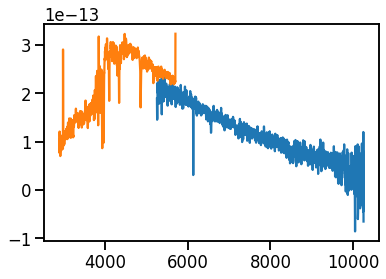

In [25]:
# next, we get the wavelength solution
wl_sol_750 = fits.getdata("wasp-121/HST/G750L/od9ma2010/od9ma2010_x1d.fits", ext = 1)
for i, order_750 in enumerate(wl_sol_750):
    plt.plot(order_750["WAVELENGTH"], order_750["FLUX"])
    
wl_sol_430 = fits.getdata("wasp-121/HST/G430L/od9m99010/od9m99010_x1d.fits", ext = 1)
for i, order_430 in enumerate(wl_sol_430):
    plt.plot(order_430["WAVELENGTH"], order_430["FLUX"])

In [26]:
# we're going to fix limb darkening for now
# change the path here to your exotic-ld_data 

from exotic_ld import StellarLimbDarkening

sld = StellarLimbDarkening(
            M_H=0.13, Teff=6776, logg=4.24, ld_model='1D',
            ld_data_path="/Users/natalieallen/Documents/Grad/Sing Research/exotic-ld_data")

c1_430, c2_430 = sld.compute_quadratic_ld_coeffs(
            wavelength_range=np.array([order_430["WAVELENGTH"][0], order_430["WAVELENGTH"][-1]]),
            mode='HST_STIS_G430L')

c1_750, c2_750 = sld.compute_quadratic_ld_coeffs(
            wavelength_range=np.array([order_750["WAVELENGTH"][0], order_750["WAVELENGTH"][-1]]),
            mode='HST_STIS_G750L')

In [27]:
# to read into the white_light_fit functions, just need to create a dictionary like this - 
# put just the value if it should be fixed, and the value and range in a list if it should be fit
params_430 = {"P": [1.274925],"t0": [2457686.2441857136], "p": [0.12, 0.05], "b": [0.1], "a": [3.823], "rho": [612], "ecc": [0], "omega": [90], "c1": [c1_430], "c2": [c2_430]}
params_750 = {"P": [1.274925],"t0": [2457686.2441857136], "p": [0.12, 0.05], "b": [0.1], "a": [3.823], "rho": [612], "ecc": [0], "omega": [90], "c1": [c1_750], "c2": [c2_750]}

In [28]:
# now for a bunch of light curve fitting
# to quickly describe, there are three main "options" for different fitting methods
# there is a gp detrending method (using juliet), and two linear detrending methods - one using juliet,
# and another just using a quick LM fit function (mostly just for test purposes)
# the juliet fits can use any of the available samplers, although right now I only have the default pymultinest and
# dynesty set up

# if you use the gp method, you need to provide a name for an output folder with juliet_name
gp_fit = white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_430, sys_method = "gp", juliet_name = "wasp-121_430_1", gp_kernel = "Matern", sampler = "dynamic_dynesty")
# this outputs a juliet "results" type - will show some ways of how to use that below

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_1/_dynesty_DNS_posteriors.pkl


In [29]:
# here are the results for that fit
for i in gp_fit.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit.posteriors['posterior_samples'][i]))

unnamed 0.16178798084612292
loglike 274.19005266654096
p_p1 0.11961661427403755
mflux_STIS -0.0014487558465886591
sigma_w_STIS 7.198792869627254
GP_sigma_STIS 302.4431558262099
GP_malpha0_STIS 0.7526159011237007
GP_malpha1_STIS 0.6160697744637721
GP_malpha2_STIS 0.21461864177385534
GP_malpha3_STIS 0.13336906349758335
GP_malpha4_STIS 0.08210749689333004
GP_malpha5_STIS 0.09183433950995316
GP_malpha6_STIS 0.1980505152861734
GP_malpha7_STIS 0.10272546966371882
GP_malpha8_STIS 0.057437763096763385
GP_malpha9_STIS 0.09586815515135379


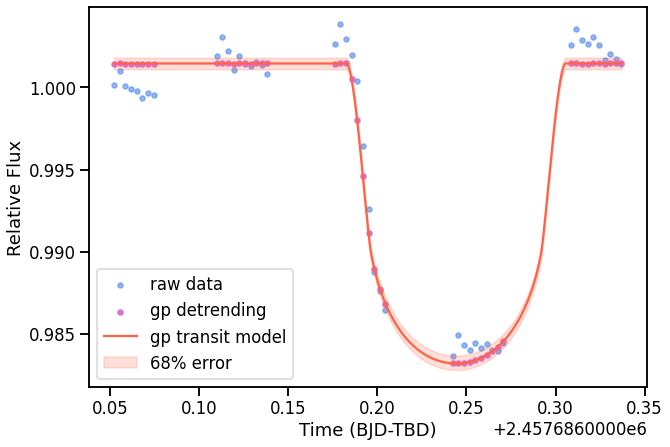

In [30]:
# let's plot the results of this fit using the juliet object
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_plus_GP_model = gp_fit.lc.evaluate('STIS')
transit_model = gp_fit.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_430, (lc_430/np.median(lc_430[:10])), label = "raw data", color = "cornflowerblue", alpha = 0.7)
plt.scatter(times_start_430, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(np.linspace(times_start_430[0], times_start_430[-1], 1000), transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [31]:
# second 430 transit
gp_fit_2 = white_light_fit(params_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_430_2, sys_method = "gp", juliet_name = "wasp-121_430_2", gp_kernel = "Matern", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_2/_dynesty_DNS_posteriors.pkl


In [32]:
for i in gp_fit_2.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_2.posteriors['posterior_samples'][i]))

unnamed 0.13896337246444201
loglike 278.64589771233915
p_p1 0.11955599964736582
mflux_STIS -0.0013122690104030797
sigma_w_STIS 4.739848095297583
GP_sigma_STIS 291.2880014657404
GP_malpha0_STIS 0.9810798655681612
GP_malpha1_STIS 0.11245306177248254
GP_malpha2_STIS 0.13200758233919
GP_malpha3_STIS 0.1964395242568102
GP_malpha4_STIS 0.08222896447490452
GP_malpha5_STIS 0.1596405181951272
GP_malpha6_STIS 0.062889239794339
GP_malpha7_STIS 0.08924996475191052
GP_malpha8_STIS 0.1367880296150195
GP_malpha9_STIS 0.13904772921231578


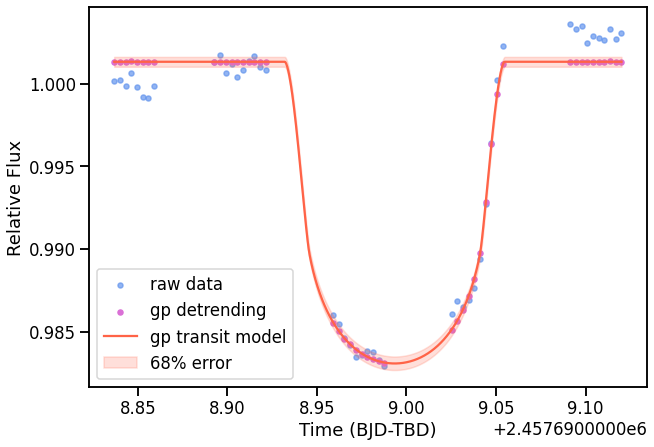

In [33]:
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_430_2[0], times_start_430_2[-1], 1000)

transit_plus_GP_model = gp_fit_2.lc.evaluate('STIS')
transit_model = gp_fit_2.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_2.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_430_2, (lc_430_2/np.median(lc_430_2[:10])), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_430_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [34]:
# 750 transit
gp_fit_750 = white_light_fit(params_750, times_start_750, lc_750, lc_err_750, norm_pc_750, sys_method = "gp", juliet_name = "wasp-121_750", gp_kernel = "Matern", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750/_dynesty_DNS_posteriors.pkl


In [35]:
for i in gp_fit_750.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_750.posteriors['posterior_samples'][i]))

unnamed 0.3104639569499671
loglike 445.60607758361243
p_p1 0.11945549547267265
mflux_STIS -0.0008288090632007819
sigma_w_STIS 8.707732369960267
GP_sigma_STIS 169.5803444766128
GP_malpha0_STIS 0.4625036835805082
GP_malpha1_STIS 0.39840248812860146
GP_malpha2_STIS 0.18968939154406853
GP_malpha3_STIS 0.8988877690895681
GP_malpha4_STIS 0.26709198111081145
GP_malpha5_STIS 0.27589076548825364
GP_malpha6_STIS 0.3186665685488721
GP_malpha7_STIS 0.29333315893126
GP_malpha8_STIS 0.08311450898678344
GP_malpha9_STIS 0.37633841539633156


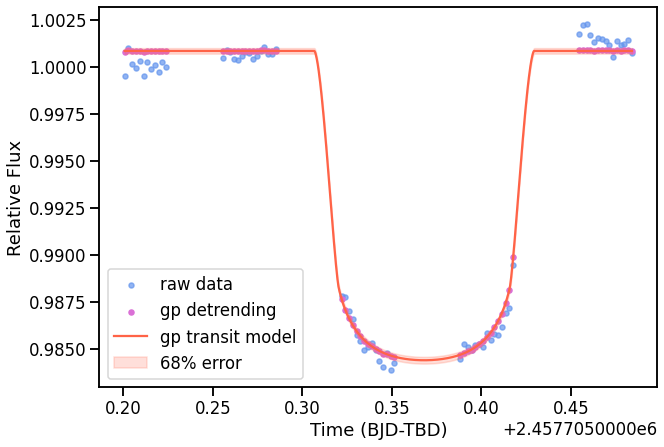

In [36]:
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_750[0], times_start_750[-1], 1000)
transit_plus_GP_model = gp_fit_750.lc.evaluate('STIS')
transit_model = gp_fit_750.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_750.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_750, (lc_750/np.median(lc_750[:10])), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_750, (lc_750/np.median(lc_750[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [37]:
# can also fit multiple 430 transits simultaneously
gp_fit_joint = joint_white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_use5_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_use5_430_2, sys_method = "gp", juliet_name = "wasp-121_430_joint_gp", gp_kernel = "Matern", limb_darkening = "fixed", sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_joint_gp/_dynesty_DNS_posteriors.pkl


In [38]:
for i in gp_fit_joint.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_joint.posteriors['posterior_samples'][i]))

unnamed 0.2579270154300849
loglike 566.8014099665338
p_p1 0.1205850065474444
mflux_STIS1 -0.0012922697356951072
sigma_w_STIS1 7.076126910909935
GP_sigma_STIS1 508.47318196274375
mflux_STIS2 -0.0013089410117510805
sigma_w_STIS2 6.159334491834451
GP_sigma_STIS2 524.1972702655295
GP_malpha0_STIS1 0.7756044892640036
GP_malpha1_STIS1 0.32754865301158215
GP_malpha2_STIS1 0.1093789263233342
GP_malpha3_STIS1 0.3392363593740453
GP_malpha4_STIS1 0.02706866053692082
GP_malpha0_STIS2 0.7278011260132837
GP_malpha1_STIS2 0.19098139331766859
GP_malpha2_STIS2 0.16676902096983706
GP_malpha3_STIS2 0.2956045937605428
GP_malpha4_STIS2 0.037746488752265855


(0.98, 1.006)

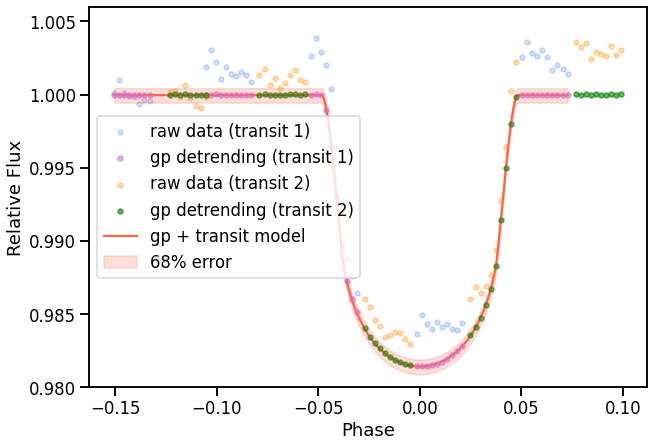

In [39]:
plt.figure(figsize = (10,7))

phases = juliet.utils.get_phases(times_start_430, params_430["P"], params_430["t0"])
phases_2 = juliet.utils.get_phases(times_start_430_2, params_430["P"], params_430["t0"])

transit_plus_GP_model1 = gp_fit_joint.lc.evaluate('STIS1')
transit_model1 = gp_fit_joint.lc.evaluate('STIS1', evaluate_transit = True)

gp_model1 = transit_plus_GP_model1 - transit_model1

transit_plus_GP_model2 = gp_fit_joint.lc.evaluate('STIS2')
transit_model2 = gp_fit_joint.lc.evaluate('STIS2', evaluate_transit = True)

gp_model2 = transit_plus_GP_model2 - transit_model2

offset1 = np.nanmedian(gp_fit_joint.posteriors['posterior_samples']['mflux_STIS1'])
offset2 = np.nanmedian(gp_fit_joint.posteriors['posterior_samples']['mflux_STIS2'])

t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_model2_resamp, error68_up, error68_down = gp_fit_joint.lc.evaluate('STIS2', evaluate_transit = True, t = t_final, return_err = True)
model_phases = juliet.utils.get_phases(t_final, params_430["P"], params_430["t0"])

offset3 = np.nanmedian(gp_fit_joint.posteriors['posterior_samples']['mflux_STIS2'])

plt.scatter(phases, (lc_430/np.median(lc_430[:10])),alpha=0.3, label = "raw data (transit 1)", color = "cornflowerblue",)
plt.scatter(phases, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model1 - transit_model1) + offset1,alpha=0.6, label = "gp detrending (transit 1)", color = "orchid")

plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])),alpha=0.3, label = "raw data (transit 2)", color = "darkorange",)
plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model2 - transit_model2) + offset2,alpha=0.6, label = "gp detrending (transit 2)", color = "green")

plt.plot(model_phases, transit_model2_resamp + offset3, color = "tomato", label = "gp + transit model", zorder = 0)
plt.fill_between(model_phases, error68_up+offset3, error68_down+offset3, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Phase")
plt.ylim(0.98, 1.006)

In [40]:
# any fit can also be done with linear detrending in the same way, just setting "sys_method" = "linear"
linear_fit_joint = joint_white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_use2_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_use2_430_2, sys_method = "linear", juliet_name = "wasp-121_430_joint_linear", limb_darkening = "fixed", sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_joint_linear/_dynesty_DNS_posteriors.pkl


In [41]:
for i in linear_fit_joint.posteriors['posterior_samples'].keys():
    print(i, np.median(linear_fit_joint.posteriors['posterior_samples'][i]))

unnamed 0.0007067087219638779
loglike 572.0382429143382
p_p1 0.12075446686021958
mflux_STIS1 -0.0019055914830533693
sigma_w_STIS1 655.0100081817328
mflux_STIS2 -0.001572217173824607
sigma_w_STIS2 582.2082732315467
theta0_STIS1 -0.0006685869214209106
theta1_STIS1 0.0007082767486679131
theta0_STIS2 0.0009310909718180937
theta1_STIS2 0.00010879148545939188


(0.98, 1.006)

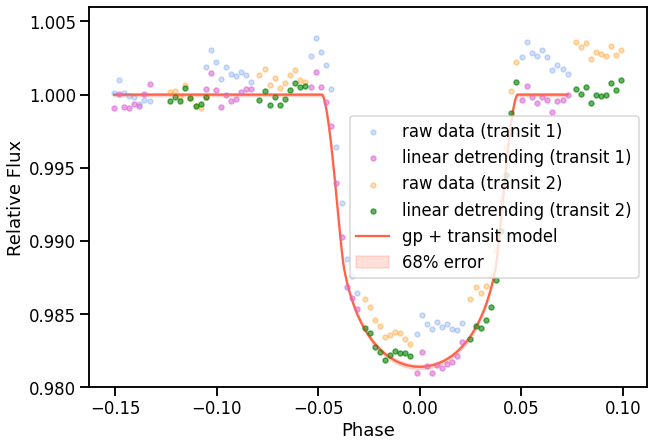

In [42]:
plt.figure(figsize = (10,7))

phases = juliet.utils.get_phases(times_start_430, params_430["P"], params_430["t0"])
phases_2 = juliet.utils.get_phases(times_start_430_2, params_430["P"], params_430["t0"])

transit_plus_GP_model1 = linear_fit_joint.lc.evaluate('STIS1')
transit_model1 = linear_fit_joint.lc.evaluate('STIS1', evaluate_transit = True)

gp_model1 = transit_plus_GP_model1 - transit_model1

transit_plus_GP_model2 = linear_fit_joint.lc.evaluate('STIS2')
transit_model2 = linear_fit_joint.lc.evaluate('STIS2', evaluate_transit = True)

gp_model2 = transit_plus_GP_model2 - transit_model2

offset1 = np.nanmedian(linear_fit_joint.posteriors['posterior_samples']['mflux_STIS1'])
offset2 = np.nanmedian(linear_fit_joint.posteriors['posterior_samples']['mflux_STIS2'])

t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_model2_resamp, error68_up, error68_down = linear_fit_joint.lc.evaluate('STIS2', evaluate_transit = True, t = t_final, return_err = True)
model_phases = juliet.utils.get_phases(t_final, params_430["P"], params_430["t0"])

offset3 = np.nanmedian(linear_fit_joint.posteriors['posterior_samples']['mflux_STIS2'])

plt.scatter(phases, (lc_430/np.median(lc_430[:10])),alpha=0.3, label = "raw data (transit 1)", color = "cornflowerblue",)
plt.scatter(phases, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model1 - transit_model1) + offset1,alpha=0.6, label = "linear detrending (transit 1)", color = "orchid")

plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])),alpha=0.3, label = "raw data (transit 2)", color = "darkorange",)
plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model2 - transit_model2) + offset2,alpha=0.6, label = "linear detrending (transit 2)", color = "green")

plt.plot(model_phases, transit_model2_resamp + offset3, color = "tomato", label = "gp + transit model", zorder = 0)
plt.fill_between(model_phases, error68_up+offset3, error68_down+offset3, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Phase")
plt.ylim(0.98, 1.006)

In [43]:
# next is spectroscopic light curve fitting
# spectroscopic fit params dictionary -- only difference is how you pass in the limb darkening info
params_430_spec = {"P": [1.274925],"t0": [2457686.2441857136], "p": [0.12, 0.05], "b": [0.1], "a": [3.823], "rho": [612], "ecc": [0], "omega": [90], "c1": [c1_750], "c2": [c2_750]}
params_750_spec = {"P": [1.274925],"t0": [2457686.2441857136], "p": [0.12, 0.05], "b": [0.1], "a": [3.823], "rho": [612], "ecc": [0], "omega": [90], "c1": [c1_750], "c2": [c2_750]}

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc5_phase/wasp-121_750_dd_pc5_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc5_phase/wasp-121_750_dd_pc5_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc5_phase/wasp-121_750_dd_pc5_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc5_phase/wasp-121_750_dd_pc5_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc5_phase/wasp-121_750_dd_pc5_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc5_phase/wasp-121_750_dd_pc5_phase_bin006/_dynesty_DNS_posteriors.pkl
Detected d

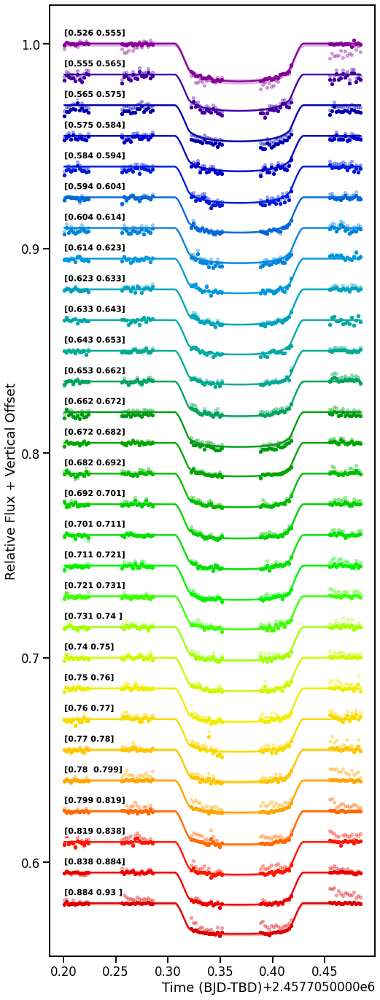

In [44]:
# the only difference for the spectroscopic light curve fitting function is that you pass in the wavelengths and 
# spectra itself rather than the light curve, and also the binning scheme (in a file, with the beginning
# and end wavelengths specified, see examples), and the "sld", which is the limb darkening object defined above
bins_7_dd_pc5_p, rp_7_dd_pc5_p, rp_e_7_dd_pc5_p, fits_7_dd_pc5_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750, spectra_750, norm_pc_use5_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-121_750_dd_pc5_phase",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True,\
                                                    savefig = False, fig_name = "w121b_750_gp_slc.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc2_linear_phase/wasp-121_750_dd_pc2_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc2_linear_phase/wasp-121_750_dd_pc2_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc2_linear_phase/wasp-121_750_dd_pc2_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc2_linear_phase/wasp-121_750_dd_pc2_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc2_linear_phase/wasp-121_750_dd_pc2_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_750_dd_pc2_linear_

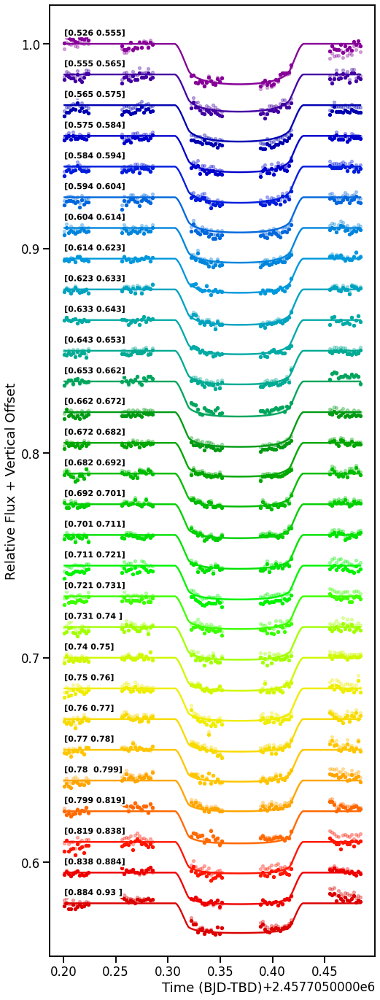

In [45]:
bins_7_dd_lin_pc2_p, rp_7_dd_lin_pc2_p, rp_e_7_dd_lin_pc2_p, fits_7_lin_dd_pc2_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750, spectra_750, norm_pc_use2_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-121_750_dd_pc2_linear_phase",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True,\
                                                    savefig = False, fig_name = "w121b_750_linear_slc.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dy

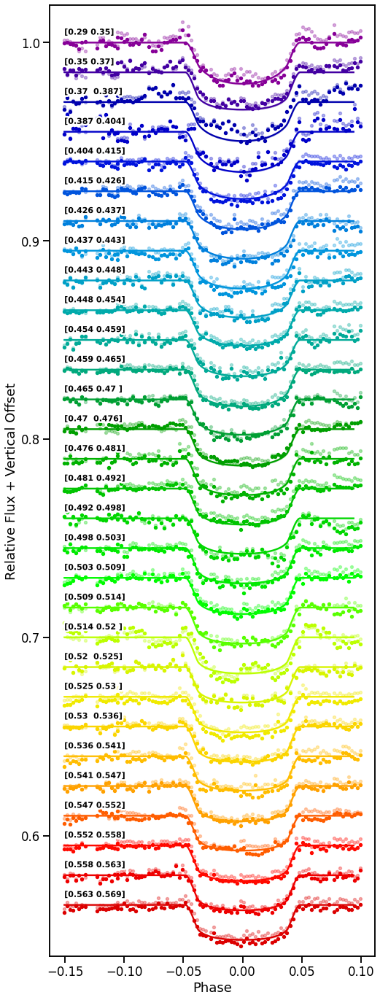

In [46]:
bins_joint_dd_lin_pc2_p, rp_joint_dd_lin_pc2_p, rp_e_joint_dd_lin_pc2_p, fits_lin_pc2_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use2_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use2_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-121_430_spec_d_dynesty_norm_fixed_linear_pc2_phase",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w121b_430_linear_slc.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase/wasp-121_430_spec_d_

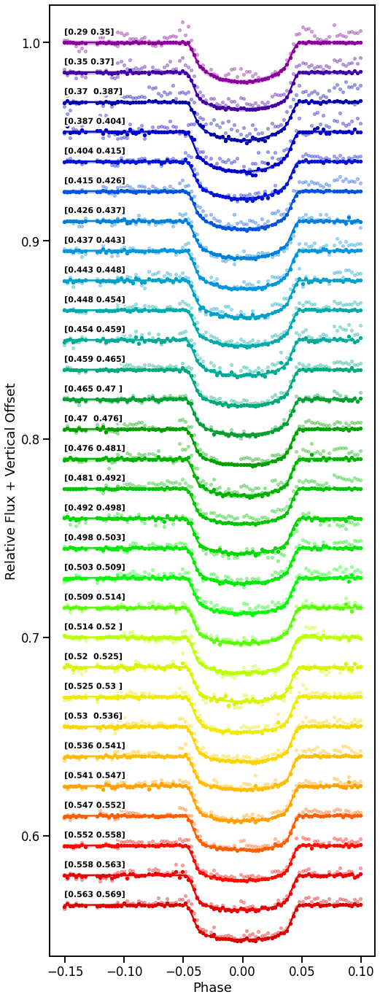

In [47]:
bins_joint_dd_pc5_p, rp_joint_dd_pc5_p, rp_e_joint_dd_pc5_p, fits_pc5_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use5_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use5_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-121_430_spec_d_dynesty_norm_pc5_fixed2_phase",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w121b_430_gp_slc.png")

Text(0.5, 1.0, 'WASP-121 b')

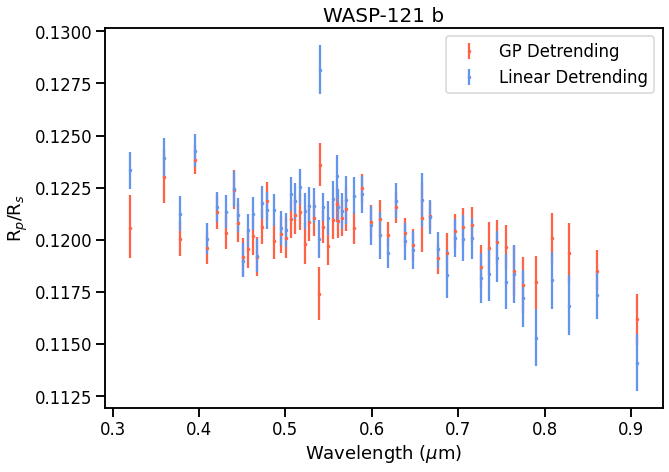

In [48]:
# final spectra!
plt.figure(figsize = (10,7))

plt.errorbar(np.array(bins_joint_dd_pc5_p)/10000, rp_joint_dd_pc5_p, yerr = np.array(rp_e_joint_dd_pc5_p).T, fmt = ".", color = "tomato")
plt.errorbar(np.array(bins_7_dd_pc5_p)/10000, rp_7_dd_pc5_p, yerr = np.array(rp_e_7_dd_pc5_p).T, fmt = ".", color = "tomato", label = "GP Detrending")

plt.errorbar(np.array(bins_joint_dd_lin_pc2_p)/10000, rp_joint_dd_lin_pc2_p, yerr = np.array(rp_e_joint_dd_lin_pc2_p).T, fmt = ".", color = "cornflowerblue")
plt.errorbar(np.array(bins_7_dd_lin_pc2_p)/10000, rp_7_dd_lin_pc2_p, yerr = np.array(rp_e_7_dd_lin_pc2_p).T, fmt = ".", color = "cornflowerblue", label = "Linear Detrending")

plt.legend()
plt.ylabel(r"R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-121 b", fontsize=20)